# EDA Assignment By Deepansh Jha.

#### It's A Huge File And Would Take 40-50 Sec To Load Completely,Be Patient. (No Errors)

## Import Libraries

In [1]:
import pandas as pd,numpy as np,matplotlib.pyplot as plt,seaborn as sns
import warnings
warnings.filterwarnings('ignore')

### Here's The Step By Step Process We Will Follow :
1. Data Understanding And Sourcing.
2. Check Data Quality And Data Cleaning.
3. Binning.
4. Check For Data Imbalance.
5. Data Analysis With Respect To 'Target' Column.
6. Merging Application Data With Previous Application.
7. Data Analysis With Respect To 'Contract Status' Column.

# Data Understanding And Sourcing.

## Load .cse files

In [2]:
df_app=pd.read_csv('D:\\Upgrad\\EDA Assignment\\application_data.csv') #Assigned a variable named df_app to "Application Data" dataset

## Checking

In [3]:
df_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [4]:
df_app.shape #Checking Shape Of Application Dataset

(307511, 122)

In [5]:
df_app.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [6]:
df_app.TARGET.value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

In [7]:
df_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


## Modifying Maximum Rows And Columns Range To Get The Full View Of The DataFrame

In [8]:
pd.set_option('display.max_columns',200)
pd.set_option('display.max_rows',200)

## Checking For Number Of Null Values In 'application_data'

In [9]:
df_app.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [10]:
df_app.size # To check The Length Of Whole 'application_data' Dataset

37516342

#### Percentage Of Total Null Files

In [11]:
percentage_null = np.round((df_app.isnull().sum().sum()/df_app.size)*100,2) # using np.round to take decimal upto 2 places.
print(percentage_null,'%')

24.4 %


#### Checking Data Type Of The Columns

In [12]:
df_app.dtypes

SK_ID_CURR                        int64
TARGET                            int64
NAME_CONTRACT_TYPE               object
CODE_GENDER                      object
FLAG_OWN_CAR                     object
FLAG_OWN_REALTY                  object
CNT_CHILDREN                      int64
AMT_INCOME_TOTAL                float64
AMT_CREDIT                      float64
AMT_ANNUITY                     float64
AMT_GOODS_PRICE                 float64
NAME_TYPE_SUITE                  object
NAME_INCOME_TYPE                 object
NAME_EDUCATION_TYPE              object
NAME_FAMILY_STATUS               object
NAME_HOUSING_TYPE                object
REGION_POPULATION_RELATIVE      float64
DAYS_BIRTH                        int64
DAYS_EMPLOYED                     int64
DAYS_REGISTRATION               float64
DAYS_ID_PUBLISH                   int64
OWN_CAR_AGE                     float64
FLAG_MOBIL                        int64
FLAG_EMP_PHONE                    int64
FLAG_WORK_PHONE                   int64


In [13]:
df_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [14]:
df_app.isna().sum() # Number Of Null Values in DataSet with each columns

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

## Checking Percentage Of Null Values In Different Columns

In [15]:
np.round((df_app.isna().sum().sort_values(ascending=False)/len(df_app))*100,2) #Checking Null Values Percentage By Descending Order
#There Are Tremendous Amount Of Null Values,Maximum is 69.87%

COMMONAREA_MEDI                 69.87
COMMONAREA_AVG                  69.87
COMMONAREA_MODE                 69.87
NONLIVINGAPARTMENTS_MODE        69.43
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAPARTMENTS_MEDI        69.43
FONDKAPREMONT_MODE              68.39
LIVINGAPARTMENTS_MODE           68.35
LIVINGAPARTMENTS_AVG            68.35
LIVINGAPARTMENTS_MEDI           68.35
FLOORSMIN_AVG                   67.85
FLOORSMIN_MODE                  67.85
FLOORSMIN_MEDI                  67.85
YEARS_BUILD_MEDI                66.50
YEARS_BUILD_MODE                66.50
YEARS_BUILD_AVG                 66.50
OWN_CAR_AGE                     65.99
LANDAREA_MEDI                   59.38
LANDAREA_MODE                   59.38
LANDAREA_AVG                    59.38
BASEMENTAREA_MEDI               58.52
BASEMENTAREA_AVG                58.52
BASEMENTAREA_MODE               58.52
EXT_SOURCE_1                    56.38
NONLIVINGAREA_MODE              55.18
NONLIVINGAREA_AVG               55.18
NONLIVINGARE

In [16]:
df_app.shape[1] # Number Of Columns Are 122 and total null values are 24.4 %

122

## We Will be Masking And Not Taking Columns Having Null Values More Than 50%

In [17]:
df_application = df_app.loc[:,(df_app.isnull().sum()/len(df_app)*100) < 50] #Taking <50 Will Only Keep Columns Having Null Values <50%
print(f'After Excluding Columns With Null Value More Than 50 Percent,Columns Remaining = {df_application.shape[1]}')

After Excluding Columns With Null Value More Than 50 Percent,Columns Remaining = 81


#### All The Columns With Null Values

In [18]:
print(df_application.columns[df_application.isna().sum()>0]) # Total 26 Columns Out Of 81 Still Have Null Values
print(f'\n\nTotal Number Of Null Value Columns Under 50% = {df_application.columns[df_application.isna().sum()>0].size}')

Index(['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'YEARS_BEGINEXPLUATATION_AVG', 'FLOORSMAX_AVG',
       'YEARS_BEGINEXPLUATATION_MODE', 'FLOORSMAX_MODE',
       'YEARS_BEGINEXPLUATATION_MEDI', 'FLOORSMAX_MEDI', 'TOTALAREA_MODE',
       'EMERGENCYSTATE_MODE', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE',
       'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object')


Total Number Of Null Value Columns Under 50% = 26


#### Showing Only Columns Having Null Values

In [19]:
null_of_all_columns = np.round(df_application.isna().sum()/len(df_application)*100,4) # All Count Of Null Values in Percentage In Different Columns and rounding off to 4 decimal places.
col_with_only_null = null_of_all_columns[null_of_all_columns>0] #Targeting Only Columns Having Null Values in Percentage.
print(col_with_only_null)
# It can be easily seen below that the maximum percentage is 49.761% and Minimum percentage is 0.004%
print(f'\n\nTotal Columns With Null Values = {col_with_only_null.count()} Columns')

AMT_ANNUITY                      0.0039
AMT_GOODS_PRICE                  0.0904
NAME_TYPE_SUITE                  0.4201
OCCUPATION_TYPE                 31.3455
CNT_FAM_MEMBERS                  0.0007
EXT_SOURCE_2                     0.2146
EXT_SOURCE_3                    19.8253
YEARS_BEGINEXPLUATATION_AVG     48.7810
FLOORSMAX_AVG                   49.7608
YEARS_BEGINEXPLUATATION_MODE    48.7810
FLOORSMAX_MODE                  49.7608
YEARS_BEGINEXPLUATATION_MEDI    48.7810
FLOORSMAX_MEDI                  49.7608
TOTALAREA_MODE                  48.2685
EMERGENCYSTATE_MODE             47.3983
OBS_30_CNT_SOCIAL_CIRCLE         0.3320
DEF_30_CNT_SOCIAL_CIRCLE         0.3320
OBS_60_CNT_SOCIAL_CIRCLE         0.3320
DEF_60_CNT_SOCIAL_CIRCLE         0.3320
DAYS_LAST_PHONE_CHANGE           0.0003
AMT_REQ_CREDIT_BUREAU_HOUR      13.5016
AMT_REQ_CREDIT_BUREAU_DAY       13.5016
AMT_REQ_CREDIT_BUREAU_WEEK      13.5016
AMT_REQ_CREDIT_BUREAU_MON       13.5016
AMT_REQ_CREDIT_BUREAU_QRT       13.5016


#### New Total Percentage Of Null Values In The Dataset Now

In [20]:
per_null_now=np.round((df_application.isna().sum().sum()/df_app.size)*100,2)
print(f'The Total Percentage Of Null Values Is Now Reduced From {percentage_null}% to {per_null_now}%')

The Total Percentage Of Null Values Is Now Reduced From 24.4% to 4.31%


#### Let's Target Null Value Percentage With 0.xxx% First

In [21]:
less_13_null =col_with_only_null[col_with_only_null<10] # Checking Null Values Columns Less Than 10%
print(less_13_null)
print(f'\n\nTotal Columns With Null Values Below 10% Are = {less_13_null.count()} Columns')

AMT_ANNUITY                 0.0039
AMT_GOODS_PRICE             0.0904
NAME_TYPE_SUITE             0.4201
CNT_FAM_MEMBERS             0.0007
EXT_SOURCE_2                0.2146
OBS_30_CNT_SOCIAL_CIRCLE    0.3320
DEF_30_CNT_SOCIAL_CIRCLE    0.3320
OBS_60_CNT_SOCIAL_CIRCLE    0.3320
DEF_60_CNT_SOCIAL_CIRCLE    0.3320
DAYS_LAST_PHONE_CHANGE      0.0003
dtype: float64


Total Columns With Null Values Below 10% Are = 10 Columns


#### There Are 10 Columns With Very Less Percentage Of Null Values,Which Can Be Imputed.
#### Imputation Will Not Make Any Difference In Analysis  As The Columns Have Very Less Percentage Of Null Values.

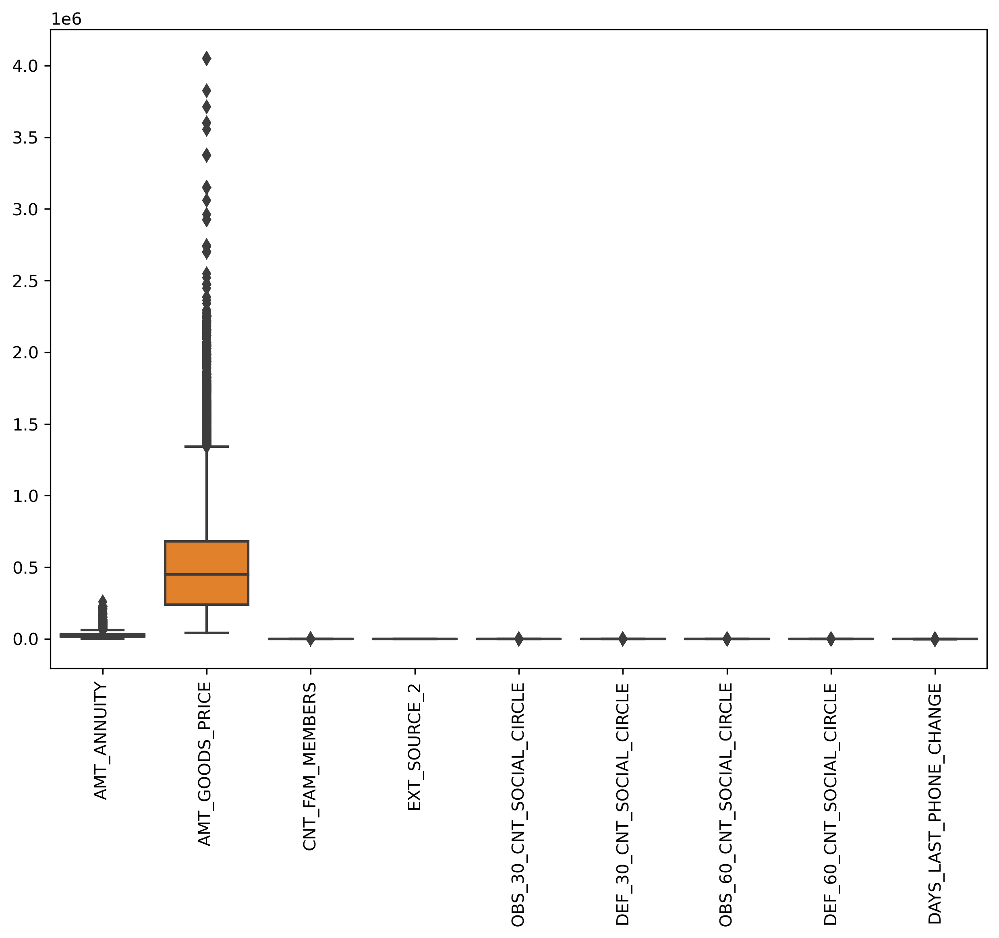

In [22]:
plt.figure(figsize=[10,7],dpi=300)
sns.boxplot(data=df_application[['AMT_ANNUITY','AMT_GOODS_PRICE','NAME_TYPE_SUITE','CNT_FAM_MEMBERS','EXT_SOURCE_2','OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE','DAYS_LAST_PHONE_CHANGE']])
plt.xticks(rotation=90);

# As We Can See Below That The Boxplot(Outliers) Of All The 10 Columns Are Not Clearly Seen,Lets See Boxplot Of All 10 Columns individually.

### As We Can See Above That The Boxplot(Outliers) Of All The 10 Columns Is Not Clearly Seen,Lets See Boxplot Of All 10 Columns individually.

##### AMT_ANNUITY = Loan annuity
##### AMT_GOODS_PRICE = For consumer loans it is the price of the goods for which the loan is given
##### NAME_TYPE_SUITE = Who was accompanying client when he was applying for the loan
##### CNT_FAM_MEMBERS = How many family members does client have
##### EXT_SOURCE_2 = Normalized score from external data source
##### OBS_30_CNT_SOCIAL_CIRCLE = How many observation of client's social surroundings with observable 30 DPD (days past due) default
##### DEF_30_CNT_SOCIAL_CIRCLE = How many observation of client's social surroundings defaulted on 30 DPD (days past due) 
##### OBS_60_CNT_SOCIAL_CIRCLE = How many observation of client's social surroundings with observable 60 DPD (days past due) default
##### DEF_60_CNT_SOCIAL_CIRCLE = How many observation of client's social surroundings defaulted on 60 (days past due) DPD
##### DAYS_LAST_PHONE_CHANGE = How many days before application did client change phone

['AMT_ANNUITY','AMT_GOODS_PRICE','NAME_TYPE_SUITE','CNT_FAM_MEMBERS','EXT_SOURCE_2','OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE','DAYS_LAST_PHONE_CHANGE']

In [23]:
df_application.shape

(307511, 81)

## Imputing Null Values With Mean or Median Will Depend On The Outliers.
#### If The Outlier Is Far Away From The Majority And Are In Small Numbers,Their Missing Values Should Be Filled With Median
#### If There Are No Outliers,Missing Values Should Be Filled With Mean

#### To Get A Better View Of The Outliers,I Will Be Using Boxplot.

## Creating A Function For figsize and dpi so that i don't have to write everytime during Visualization

In [24]:
def fig_with_dpi(a=10,b=7):
    return plt.figure(figsize=[a,b],dpi=300)
def fig_with_dpi_Box(a=10,b=2):
    return plt.figure(figsize=[a,b],dpi=300)



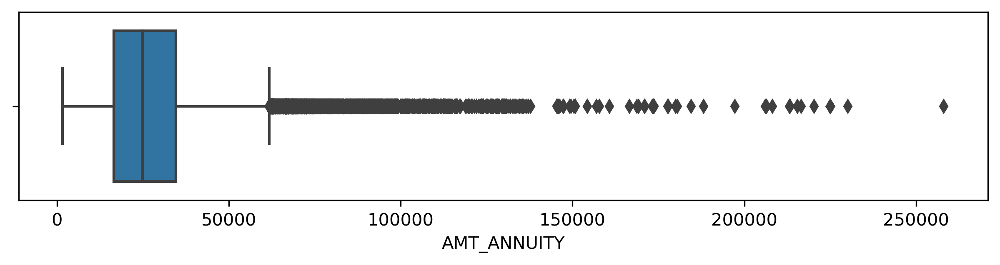

In [25]:
# AMT_ANNUITY
fig_with_dpi_Box()
sns.boxplot(df_application.AMT_ANNUITY);

# Outliers Are Evenly Distributed And Null Values Either Can Be Dropped Or Filled With 'Median'

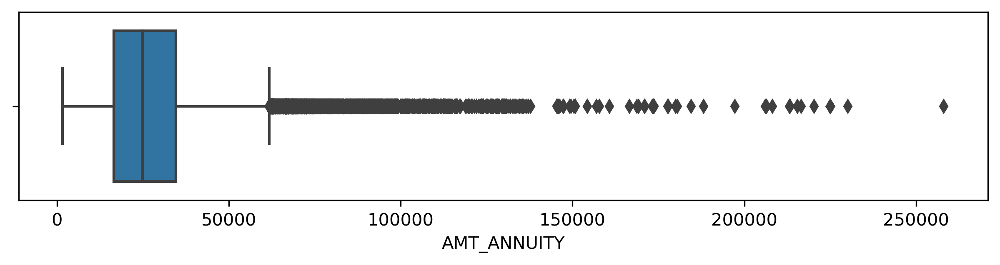

In [26]:
# AMT_GOODS_PRICE
fig_with_dpi_Box()
sns.boxplot(df_application.AMT_ANNUITY);

# Outliers Are Evenly Distributed And Null Values Either Can Be Dropped Or Filled With 'Median'

In [27]:
# # NAME_TYPE_SUITE
# fig_with_dpi_Box()
# sns.boxplot(df_application.NAME_TYPE_SUITE);
print(df_application.NAME_TYPE_SUITE.value_counts())
print(f'\n\nWill Be Filling "NAME_TYPE_SUITE" Null Values With The Mode = {df_application.NAME_TYPE_SUITE.mode()[0]}')

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64


Will Be Filling "NAME_TYPE_SUITE" Null Values With The Mode = Unaccompanied


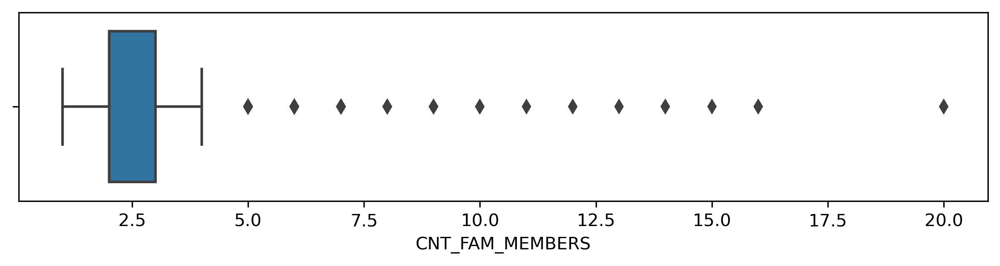

In [28]:
# CNT_FAM_MEMBERS
fig_with_dpi_Box()
sns.boxplot(df_application.CNT_FAM_MEMBERS);

# Outliers Are Evenly Distributed And Null Values Either Can Be Dropped Or Filled With 'Median'

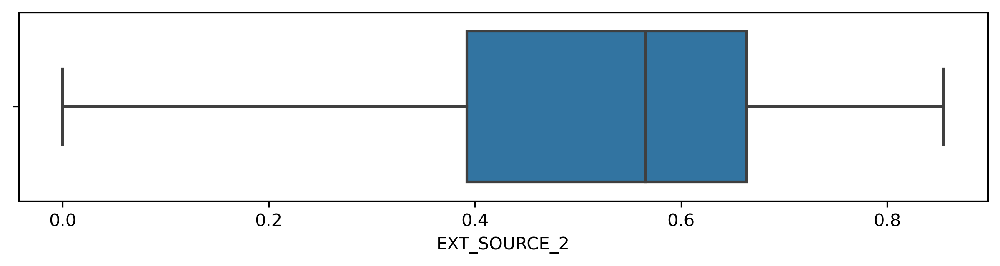

In [29]:
# EXT_SOURCE_2
fig_with_dpi_Box()
sns.boxplot(df_application.EXT_SOURCE_2);

# Will Be Dropping Or Filling The Null Values With 'Mean' Because Outliers Are Not Present.

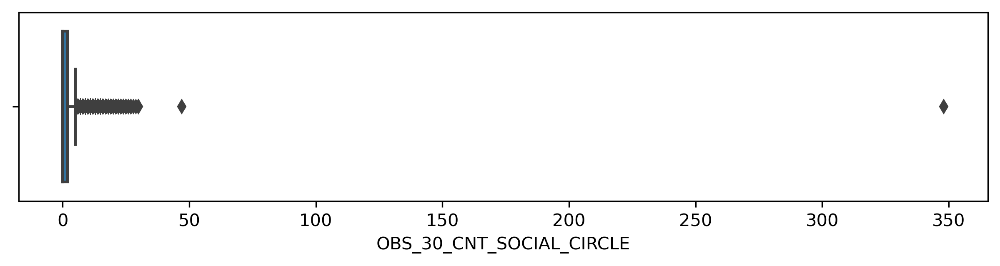

In [30]:
# OBS_30_CNT_SOCIAL_CIRCLE
fig_with_dpi_Box()
sns.boxplot(df_application.OBS_30_CNT_SOCIAL_CIRCLE);

# Outliers Are Not Evenly Distributed And Are Far From The Majority,Null Values Either Can Be Dropped Or Filled With 'Median'.
# There Is An Outlier Between 340-350 And Can Be Dropped.

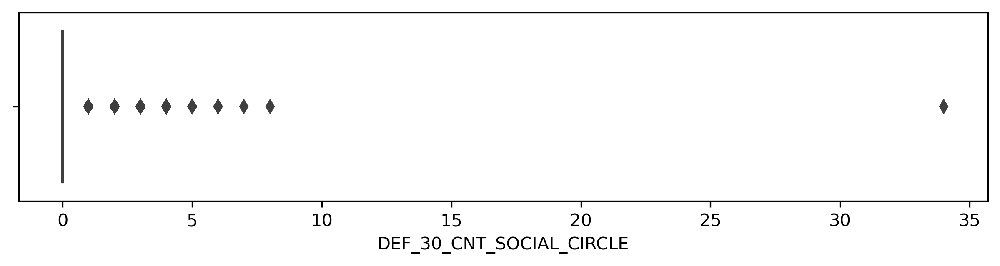

In [31]:
# DEF_30_CNT_SOCIAL_CIRCLE
fig_with_dpi_Box()
sns.boxplot(df_application.DEF_30_CNT_SOCIAL_CIRCLE);

# Outliers Are Not Evenly Distributed And Are Far From The Majority,Null Values Either Can Be Dropped Or Filled With 'Median'.
# There Is An Outlier Between 30-35 And Can Be Dropped.

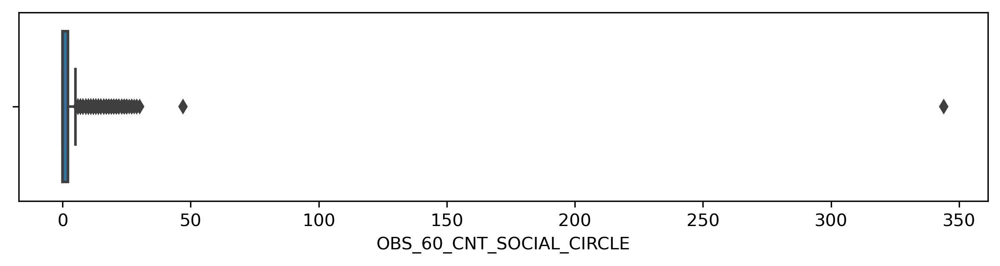

In [32]:
# OBS_60_CNT_SOCIAL_CIRCLE
fig_with_dpi_Box()
sns.boxplot(df_application.OBS_60_CNT_SOCIAL_CIRCLE);

# Outliers Are Not Evenly Distributed And Are Far From The Majority,Null Values Either Can Be Dropped Or Filled With 'Median'.
# There Is An Outlier Between 340-350 And Can Be Dropped.

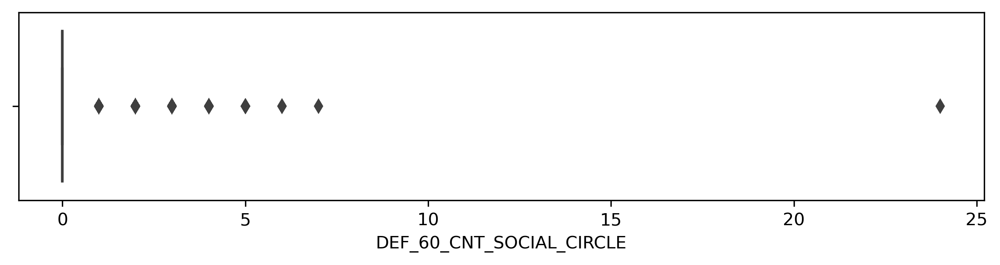

In [33]:
# DEF_60_CNT_SOCIAL_CIRCLE
fig_with_dpi_Box()
sns.boxplot(df_application.DEF_60_CNT_SOCIAL_CIRCLE);

# Outliers Are Not Evenly Distributed And Are Far From The Majority,Null Values Either Can Be Dropped Or Filled With 'Median'.
# There Is An Outlier Between 20-25 And Can Be Dropped.

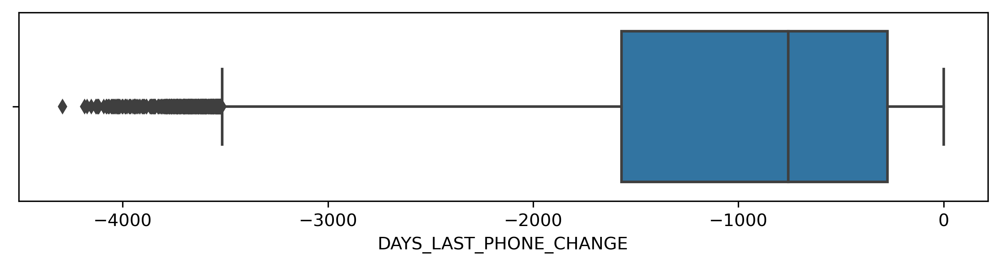

In [34]:
# DAYS_LAST_PHONE_CHANGE
fig_with_dpi_Box()
sns.boxplot(df_application.DAYS_LAST_PHONE_CHANGE);

# Will Be Dropping The Missing Values.
# Question - It's Doubtful Why All The Values Are In Negative ?

## Imputing Or Dropping Missing Values From Columns Having Null Values Less Than 10%

In [35]:
df_application=df_application[df_application['AMT_ANNUITY'].notna()] #Dropped,Not Much Difference,Percentage NA Is Very Less.
df_application=df_application[df_application['AMT_GOODS_PRICE'].notna()] #Dropped,Not Much Difference,Percentage NA Is Very Less.
df_application=df_application[df_application['NAME_TYPE_SUITE'].notna()] #Dropped,Not Much Difference,Percentage NA Is Very Less.
df_application=df_application[df_application['CNT_FAM_MEMBERS'].notna()] #Dropped,Not Much Difference,Percentage NA Is Very Less.
df_application['EXT_SOURCE_2'].fillna(df_application['EXT_SOURCE_2'].mean(),inplace=True) #Imputed Mean
df_application['OBS_30_CNT_SOCIAL_CIRCLE'].fillna(df_application['OBS_30_CNT_SOCIAL_CIRCLE'].median(),inplace=True) #Imputed
df_application['DEF_30_CNT_SOCIAL_CIRCLE'].fillna(df_application['DEF_30_CNT_SOCIAL_CIRCLE'].median(),inplace=True) #Imputed
df_application['OBS_60_CNT_SOCIAL_CIRCLE'].fillna(df_application['OBS_60_CNT_SOCIAL_CIRCLE'].median(),inplace=True) #Imputed
df_application['DEF_60_CNT_SOCIAL_CIRCLE'].fillna(df_application['DEF_60_CNT_SOCIAL_CIRCLE'].median(),inplace=True) #Imputed
df_application=df_application[df_application['DAYS_LAST_PHONE_CHANGE'].notna()] #Dropped
df_application['NAME_TYPE_SUITE'].fillna('Unaccompanied',inplace=True) #Filling Null Values With 'Unaccompanied'(mode())

#Dropping Missing Values In These Above Columns Doesn't Make Any Difference Because Percentage Is 0.00xx.
#If The Percentage Of Missing Value Was Higher Like 10-20%,I Would Had Imputed Them Too.

## Note :
#### We Have Cleaned Major Missing Values i.e The Columns Which Had Missing Values More Than 50% Were Masked And Not Taken.
#### The Columns Which Were Having Missing Values Less Than 10%,Their Missing Values Are Dropped Or Imputed

In [36]:
mv=np.round(df_application.isna().sum()/len(df_application)*100,4)
print(mv[mv>0]) #Missing Values Left After Dropping From Columns Having Missing Values Less Than 10%

v = np.round(df_application.isna().sum()/len(df_application)*100,4)
print(f'\n\nColumns Still Left With Missing Values Are = {v[v>0].count()} Columns Out Of {df_application.shape[1]} Columns') 

OCCUPATION_TYPE                 31.3531
EXT_SOURCE_3                    19.8393
YEARS_BEGINEXPLUATATION_AVG     48.7959
FLOORSMAX_AVG                   49.7753
YEARS_BEGINEXPLUATATION_MODE    48.7959
FLOORSMAX_MODE                  49.7753
YEARS_BEGINEXPLUATATION_MEDI    48.7959
FLOORSMAX_MEDI                  49.7753
TOTALAREA_MODE                  48.2832
EMERGENCYSTATE_MODE             47.4122
AMT_REQ_CREDIT_BUREAU_HOUR      13.5229
AMT_REQ_CREDIT_BUREAU_DAY       13.5229
AMT_REQ_CREDIT_BUREAU_WEEK      13.5229
AMT_REQ_CREDIT_BUREAU_MON       13.5229
AMT_REQ_CREDIT_BUREAU_QRT       13.5229
AMT_REQ_CREDIT_BUREAU_YEAR      13.5229
dtype: float64


Columns Still Left With Missing Values Are = 16 Columns Out Of 81 Columns


### The Rest Missing Values Are Neither Low In Proportion,Nor High In Proportion And Now We Will Keep It Untouched.

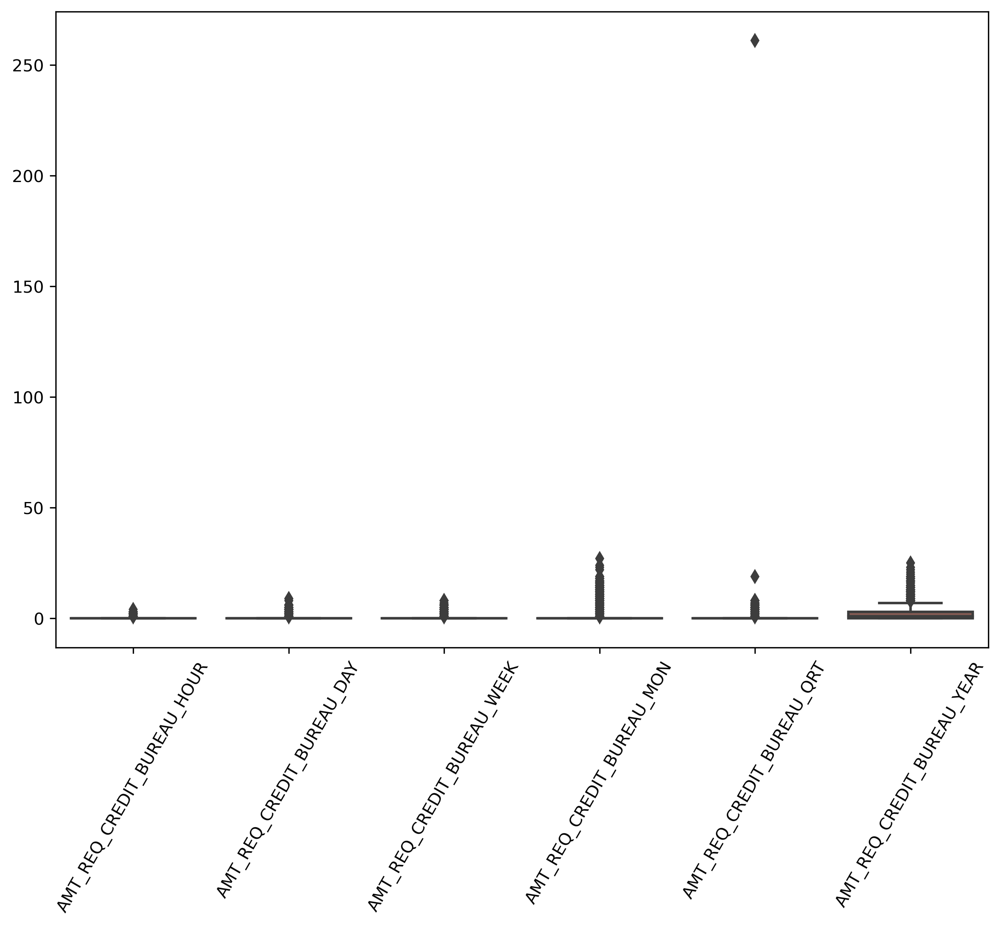

In [37]:
fig_with_dpi()
sns.boxplot(data=df_application[['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_QRT','AMT_REQ_CREDIT_BUREAU_YEAR']])
plt.xticks(rotation=60);

In [38]:
df_application.shape #Checking Shape

(306206, 81)

In [39]:
df_application.info() #Checking Datatype And Information

<class 'pandas.core.frame.DataFrame'>
Int64Index: 306206 entries, 0 to 307510
Data columns (total 81 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    306206 non-null  int64  
 1   TARGET                        306206 non-null  int64  
 2   NAME_CONTRACT_TYPE            306206 non-null  object 
 3   CODE_GENDER                   306206 non-null  object 
 4   FLAG_OWN_CAR                  306206 non-null  object 
 5   FLAG_OWN_REALTY               306206 non-null  object 
 6   CNT_CHILDREN                  306206 non-null  int64  
 7   AMT_INCOME_TOTAL              306206 non-null  float64
 8   AMT_CREDIT                    306206 non-null  float64
 9   AMT_ANNUITY                   306206 non-null  float64
 10  AMT_GOODS_PRICE               306206 non-null  float64
 11  NAME_TYPE_SUITE               306206 non-null  object 
 12  NAME_INCOME_TYPE              306206 non-nul

In [40]:
df_application.head(10)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,House / apartment,0.035792,-16941,-1588,-4970.0,-477,1,1,1,1,1,0,Laborers,2.0,2,2,WEDNESDAY,16,0,0,0,0,0,0,Other,0.354225,0.621226,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-2536.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0
6,100009,0,Cash loans,F,Y,Y,1,171000.0,1560726.0,41301.0,1395000.0,Unaccompanied,Commercial associate,Higher education,Marri

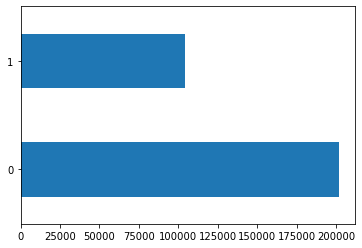

In [41]:
df_application['OWN_CAR']=df_application.FLAG_OWN_CAR.replace({'Y':1,'N':0}) #Creating A New Column 'OWN_CAR' in Numerical Form.
df_application.OWN_CAR.value_counts().plot.barh();

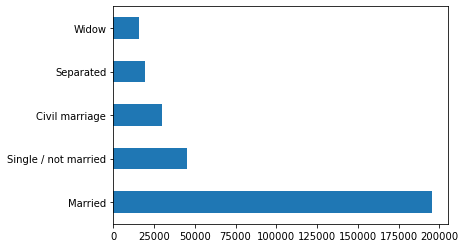

In [42]:
df_application.NAME_FAMILY_STATUS.value_counts().plot.barh();

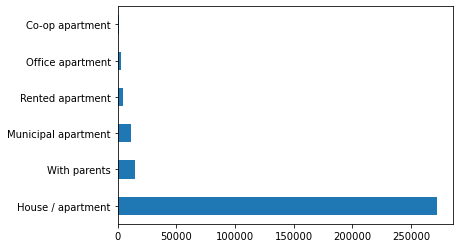

In [43]:
df_application.NAME_HOUSING_TYPE.value_counts().plot.barh();

In [44]:
df_application.CODE_GENDER.value_counts()
# There Are Only 4 XNA And To Make The Analysis Smoother,We Can Either Exclude Them Or Can Add Them To Females(mode).

F      201635
M      104567
XNA         4
Name: CODE_GENDER, dtype: int64

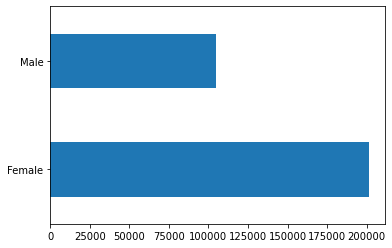

In [45]:
df_application['GENDER']=df_application.CODE_GENDER.replace({'F':'Female','M':'Male','XNA':'Female'})
df_application.GENDER.value_counts().plot.barh();
#Plotting And Counting 4 XNAs in Female(mode)

In [46]:
df_application['OWN_REALTY']=df_application.FLAG_OWN_REALTY.replace({'Y':1,'N':0})
#Creating A New Column 'OWN_REALTY' in Numerical Categorical Form.

In [47]:
df_application.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,0,Male,1
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Female,0


In [48]:
df_application.NAME_HOUSING_TYPE.value_counts()

House / apartment      271708
With parents            14774
Municipal apartment     11146
Rented apartment         4862
Office apartment         2603
Co-op apartment          1113
Name: NAME_HOUSING_TYPE, dtype: int64

In [49]:
df_application.DAYS_EMPLOYED.value_counts()

 365243    55178
-200         154
-224         150
-199         150
-230         148
           ...  
-10501         1
-9993          1
-12075         1
-8324          1
-8694          1
Name: DAYS_EMPLOYED, Length: 12566, dtype: int64

In [50]:
df_application.DAYS_BIRTH.value_counts()

-13749    42
-13481    42
-10020    41
-18248    41
-10292    40
          ..
-25042     1
-25147     1
-25052     1
-8014      1
-25061     1
Name: DAYS_BIRTH, Length: 17458, dtype: int64

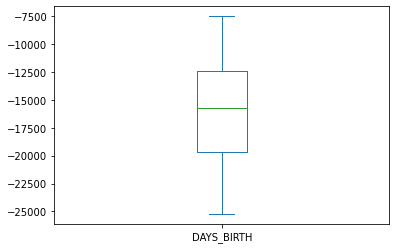

In [51]:
df_application.DAYS_BIRTH.plot.box(); # Birth Values Are In Negative,These Negative Values Should Be Fixed.

#### First Of All Will Be Checking If Negative Values Are Valid Or Should Be Changed To Absolute Value.

In [52]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,0,Male,1
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Female,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,1,Male,1
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,Female,1
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Male,1


#### These Colums Contain Negative Values
['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH','DAYS_LAST_PHONE_CHANGE']

In [53]:
df_application.DAYS_BIRTH.describe() # min=Negative,max=Negative

count    306206.000000
mean     -16040.685388
std        4362.860340
min      -25229.000000
25%      -19685.000000
50%      -15756.000000
75%      -12418.000000
max       -7489.000000
Name: DAYS_BIRTH, dtype: float64

count    306206.000000
mean      63860.880737
std      141315.195242
min      -17912.000000
25%       -2761.000000
50%       -1214.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64


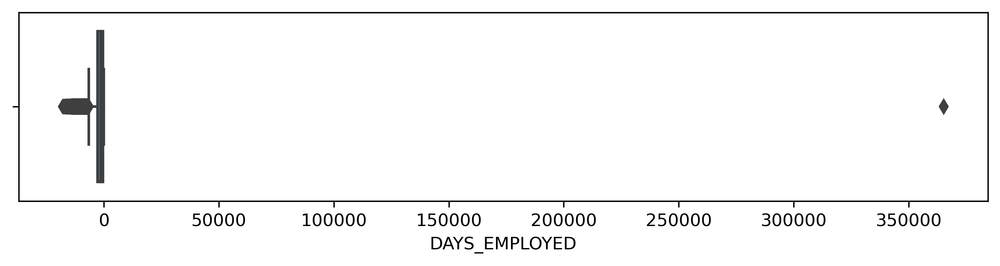

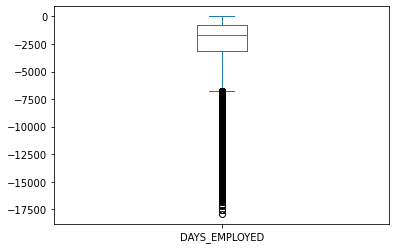

In [54]:
print(df_application.DAYS_EMPLOYED.describe()) # min=Negative,max=Positive
fig_with_dpi_Box()
sns.boxplot(df_application.DAYS_EMPLOYED);
emp=df_application[['DAYS_EMPLOYED']]

emp[emp<365243].plot.box(); #Plotting A Box Plot To See How Many Values Are There Below 365243.
#It Is Concluded That 365243 Is Not Meaningful And Will Be Counted As Exception Because 365243 Is The Only Positive Value.

#Can Be Seen Clearly That Only One Value(365243) Is Positive And The Rest Are Negative
#Therefore Will Be Converting All The Values To Positive.

count    306206.000000
mean      -4987.966444
std        3522.537608
min      -24672.000000
25%       -7481.000000
50%       -4507.000000
75%       -2013.000000
max           0.000000
Name: DAYS_REGISTRATION, dtype: float64


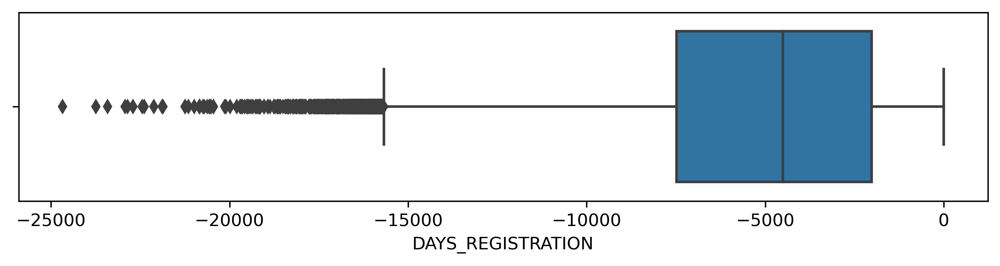

In [55]:
print(df_application.DAYS_REGISTRATION.describe()) # min=Negative,max=0
fig_with_dpi_Box()
sns.boxplot(df_application.DAYS_REGISTRATION);

# Can Be Clearly Seen That All The Values Are In Negative And Hence Should Be Converted To Absolute Values For Visualizing Data More Accurately.

count    306206.000000
mean      -2994.348181
std        1509.514607
min       -7197.000000
25%       -4299.000000
50%       -3255.000000
75%       -1720.000000
max           0.000000
Name: DAYS_ID_PUBLISH, dtype: float64


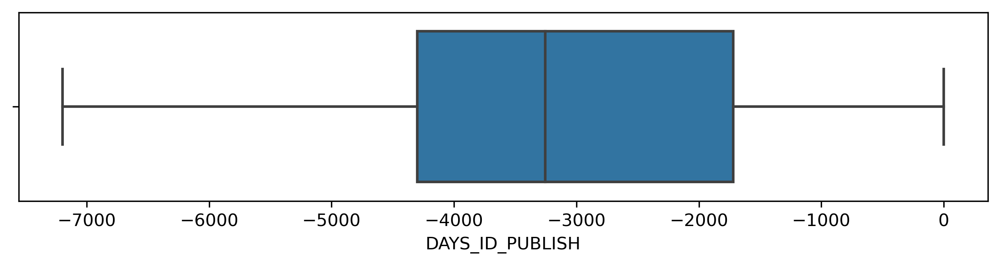

In [56]:
print(df_application.DAYS_ID_PUBLISH.describe()) # min=Negative,max=0
fig_with_dpi_Box()
sns.boxplot(df_application.DAYS_ID_PUBLISH);

# Can Be Clearly Seen That All The Values Are In Negative And Hence Should Be Converted To Absolute Values For Visualizing Data More Accurately.

count    306206.000000
mean       -964.427248
std         826.705518
min       -4292.000000
25%       -1571.000000
50%        -759.000000
75%        -276.000000
max           0.000000
Name: DAYS_LAST_PHONE_CHANGE, dtype: float64


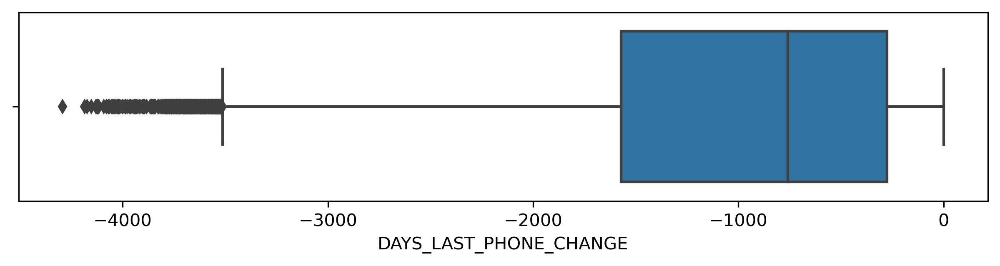

In [57]:
print(df_application.DAYS_LAST_PHONE_CHANGE.describe()) # min=Negative,max=0
fig_with_dpi_Box()
sns.boxplot(df_application.DAYS_LAST_PHONE_CHANGE);

# Can Be Clearly Seen That All The Values Are In Negative And Hence Should Be Converted To Absolute Values For Visualizing Data More Accurately.

## Fixing Outliers To Get Better Plots For Analysis.

['DAYS_EMPLOYED','AMT_INCOME_TOTAL','DEF_60_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_60_CNT_SOCIAL_CIRCLE','OBS_30_CNT_SOCIAL_CIRCLE'] #Fixing Outliers Of These Columns

In [58]:
df_application = df_application[df_application.DAYS_EMPLOYED<350000] #Eliminating Outlier From DAYS_EMPLOYED

In [59]:
df_application.AMT_INCOME_TOTAL.max()
df_application = df_application[df_application.AMT_INCOME_TOTAL<117000000] ##Eliminating Outlier From AMT_INCOME_TOTAL

In [60]:
df_application = df_application[df_application.DEF_30_CNT_SOCIAL_CIRCLE<20]
df_application = df_application[df_application.DEF_60_CNT_SOCIAL_CIRCLE<20]

##Eliminating Outlier From DEF_30_CNT_SOCIAL_CIRCLE and DEF_60_CNT_SOCIAL_CIRCLE.

In [61]:
df_application = df_application[df_application.OBS_30_CNT_SOCIAL_CIRCLE<40]
df_application = df_application[df_application.OBS_60_CNT_SOCIAL_CIRCLE<40]

##Eliminating Outlier From OBS_30_CNT_SOCIAL_CIRCLE and OBS_60_CNT_SOCIAL_CIRCLE.

## Taking Absolute Values Of All Negative Values Columns
#### ['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH','DAYS_LAST_PHONE_CHANGE']

In [62]:
df_application[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH','DAYS_LAST_PHONE_CHANGE']]=df_application[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH','DAYS_LAST_PHONE_CHANGE']].abs()

In [63]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648.0,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,0,Male,1
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Female,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260.0,2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,1,Male,1
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833.0,2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,Female,1
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311.0,3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Male,1


In [64]:
df_application[['YEAR_BIRTH','YEAR_EMPLOYED','YEAR_REGISTRATION','YEAR_ID_PUBLISH']]=np.round(df_application[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']]/365).astype(int)

#Converted Days To Years And Assigned New Columns To Them ['YEAR_BIRTH','YEAR_EMPLOYED','YEAR_REGISTRATION','YEAR_ID_PUBLISH']

In [65]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648.0,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,0,Male,1,26,2,10,6
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Female,0,46,3,3,1
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260.0,2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,1,Male,1,52,1,12,7
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833.0,2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,Female,1,52,8,27,7
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311.0,3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,Male,1,55,8,12,9


### All Below Columns Have Numerical Values

In [66]:
numerical_values_col=(df_application.dtypes == 'int64') | (df_application.dtypes == int) | (df_application.dtypes == float) | (df_application.dtypes == 'float64')
numerical_var = numerical_values_col[numerical_values_col].index
print(f'Number Of Columns Having Numerical Values Are {numerical_values_col[numerical_values_col].count()}')
list(numerical_var)
#Note - We Have Converted Flag(Y,N) Columns To Numerical(1,0) And Assigned New Columns To Them,Hence Its Showing Some Increased Columns.

Number Of Columns Having Numerical Values Are 74


['SK_ID_CURR',
 'TARGET',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'F

### All Below Columns Have Categorical Values

In [67]:
object_values_col=(df_application.dtypes == 'object') | (df_application.dtypes =='category')
print(f'Number Of Columns Having Categorical Values Are {object_values_col[object_values_col].count()}')
categorical_Val = object_values_col[object_values_col].index
list(categorical_Val)

Number Of Columns Having Categorical Values Are 14


['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'EMERGENCYSTATE_MODE',
 'GENDER']

# Datatypes

In [68]:
df_application.AMT_REQ_CREDIT_BUREAU_HOUR.value_counts(dropna=False) # All Values Are In 'Float',Should Be In 'Int'

0.0    215896
NaN     33763
1.0      1311
2.0        46
3.0         8
4.0         1
Name: AMT_REQ_CREDIT_BUREAU_HOUR, dtype: int64

In [69]:
df_application.AMT_REQ_CREDIT_BUREAU_DAY.value_counts(dropna=False) # All Values Are In 'Float',Should Be In 'Int'

0.0    216058
NaN     33763
1.0      1039
2.0        89
3.0        40
4.0        19
5.0         8
6.0         7
9.0         2
Name: AMT_REQ_CREDIT_BUREAU_DAY, dtype: int64

In [70]:
df_application[['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION','AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']]

# It Can Be Seen Clearly That Some Of The DataType Which Should Be 'Int' Are In 'Float' datatype.

,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,DAYS_REGISTRATION,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,2.0,2.0,2.0,2.0,1134.0,3648.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.0,0.0,1.0,0.0,828.0,1186.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,815.0,4260.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2.0,0.0,2.0,0.0,617.0,9833.0,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,0.0,0.0,0.0,1106.0,4311.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
307504,0.0,0.0,0.0,0.0,0.0,9798.0,NaN,NaN,NaN,NaN,NaN,NaN
307506,0.0,0.0,0.0,0.0,273.0,8456.0,NaN,NaN,NaN,NaN,NaN,NaN
307508,6.0,0.0,6.0,0.0,1909.0,6737.0,1.0,0.0,0.0,1.0,0.0,1.0
307509,0.0,0.0,0.0,0.0,322.0,2562.0,0.0,0.0,0.0,0.0,0.0,0.0


#### It Can Be Seen Clearly That Some Of The DataType Which Should Be 'Int' Are In 'Float' datatype.
#### Let's Change DataType From Float To Int.

In [71]:
print(df_application[['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION','AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR','AMT_INCOME_TOTAL','AMT_GOODS_PRICE','CNT_FAM_MEMBERS']].isna().sum()) 
#These Column's Data Type Are In Float And Should Be Converted To Int.


#['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
#above mentioned columns have some null values hence not changing their datatype and will be changed in next step.


df_application[['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION','AMT_INCOME_TOTAL','AMT_GOODS_PRICE','CNT_FAM_MEMBERS']]=df_application[['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION','AMT_INCOME_TOTAL','AMT_GOODS_PRICE','CNT_FAM_MEMBERS']].astype(int)


df_application[['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION']]
print("\n\nDatatype Of ['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',\n'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',\n'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION'\n'AMT_INCOME_TOTAL','AMT_GOODS_PRICE','CNT_FAM_MEMBERS'] \nis Now Changed From 'Float' To 'Int'.")


df_application[['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
                'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
                'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']]=df_application[['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
                                                                                            'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
                                                                                            'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']].astype('Int64')

print("\n\nDatatype Of ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',\n'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',\n'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'] \nis Now Changed From 'Float' To 'Int64'.")

# ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
#  'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
#  'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'] For These Columns Using 'Int64' Datatype As They Have Some Null Values As Well With Them.

OBS_30_CNT_SOCIAL_CIRCLE          0
DEF_30_CNT_SOCIAL_CIRCLE          0
OBS_60_CNT_SOCIAL_CIRCLE          0
DEF_60_CNT_SOCIAL_CIRCLE          0
DAYS_LAST_PHONE_CHANGE            0
DAYS_REGISTRATION                 0
AMT_REQ_CREDIT_BUREAU_HOUR    33763
AMT_REQ_CREDIT_BUREAU_DAY     33763
AMT_REQ_CREDIT_BUREAU_WEEK    33763
AMT_REQ_CREDIT_BUREAU_MON     33763
AMT_REQ_CREDIT_BUREAU_QRT     33763
AMT_REQ_CREDIT_BUREAU_YEAR    33763
AMT_INCOME_TOTAL                  0
AMT_GOODS_PRICE                   0
CNT_FAM_MEMBERS                   0
dtype: int64


Datatype Of ['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
'DAYS_LAST_PHONE_CHANGE','DAYS_REGISTRATION'
'AMT_INCOME_TOTAL','AMT_GOODS_PRICE','CNT_FAM_MEMBERS'] 
is Now Changed From 'Float' To 'Int'.


Datatype Of ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BU

In [72]:
df_application.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 251025 entries, 0 to 307510
Data columns (total 88 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    251025 non-null  int64  
 1   TARGET                        251025 non-null  int64  
 2   NAME_CONTRACT_TYPE            251025 non-null  object 
 3   CODE_GENDER                   251025 non-null  object 
 4   FLAG_OWN_CAR                  251025 non-null  object 
 5   FLAG_OWN_REALTY               251025 non-null  object 
 6   CNT_CHILDREN                  251025 non-null  int64  
 7   AMT_INCOME_TOTAL              251025 non-null  int32  
 8   AMT_CREDIT                    251025 non-null  float64
 9   AMT_ANNUITY                   251025 non-null  float64
 10  AMT_GOODS_PRICE               251025 non-null  int32  
 11  NAME_TYPE_SUITE               251025 non-null  object 
 12  NAME_INCOME_TYPE              251025 non-nul

In [73]:
df_application['AMT_REQ_CREDIT_BUREAU_HOUR'].isna().sum() #Just Checking If Python Recognize <NA> Values Of 'Int64' Or Not.

33763

In [74]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1
2,100004,0,Revolving loans,M,Y,Y,0,67500,135000.0,6750.0,135000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260,2531,1,1,1,1,1,0,Laborers,1,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Male,1,52,1,12,7
3,100006,0,Cash loans,F,N,Y,0,135000,312682.5,29686.5,297000,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833,2437,1,1,0,1,0,0,Laborers,2,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0,2,0,617,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,0,Female,1,52,8,27,7
4,100007,0,Cash loans,M,N,Y,0,121500,513000.0,21865.5,513000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311,3458,1,1,0,1,0,0,Core staff,1,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,1106,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Male,1,55,8,12,9


### Checking Duplicates

In [75]:
df_application.duplicated().sum() #It Can Be Seen Clearly That There Are No Duplicated Rows.
print(f'Number Of Duplicate Rows = {df_application.duplicated().sum()}')

Number Of Duplicate Rows = 0


## Let's See Unique Values In Some Categorical Data Columns Given Below.
 ['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'EMERGENCYSTATE_MODE',
 'GENDER']

In [76]:
df_application[['NAME_CONTRACT_TYPE', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE']].head()

,NAME_CONTRACT_TYPE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE
0,Cash loans,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3
1,Cash loans,Family,State servant,Higher education,Married,House / apartment,Core staff,MONDAY,School
2,Revolving loans,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,MONDAY,Government
3,Cash loans,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3
4,Cash loans,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Core staff,THURSDAY,Religion


#### Number Of Unique Values In Categorical Columns.

In [77]:
df_application[['NAME_CONTRACT_TYPE', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE']].nunique()

NAME_CONTRACT_TYPE             2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             57
dtype: int64

#### Name Of Unique Values In Categorical Columns.

In [78]:
print(f'Unique Values In "NAME_CONTRACT_TYPE" -> {df_application.NAME_CONTRACT_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_TYPE_SUITE" -> {df_application.NAME_TYPE_SUITE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_INCOME_TYPE" -> {df_application.NAME_INCOME_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_EDUCATION_TYPE" -> {df_application.NAME_EDUCATION_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_FAMILY_STATUS" -> {df_application.NAME_FAMILY_STATUS.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_HOUSING_TYPE" -> {df_application.NAME_HOUSING_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "OCCUPATION_TYPE" -> {df_application.OCCUPATION_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "WEEKDAY_APPR_PROCESS_START" -> {df_application.WEEKDAY_APPR_PROCESS_START.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "ORGANIZATION_TYPE" -> {df_application.ORGANIZATION_TYPE.unique()}')

Unique Values In "NAME_CONTRACT_TYPE" -> ['Cash loans' 'Revolving loans']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "NAME_TYPE_SUITE" -> ['Unaccompanied' 'Family' 'Spouse, partner' 'Other_A' 'Children'
 'Group of people' 'Other_B']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "NAME_INCOME_TYPE" -> ['Working' 'State servant' 'Commercial associate' 'Student' 'Pensioner'
 'Businessman' 'Maternity leave']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "NAME_EDUCATION_TYPE" -> ['Secondary / secondary special' 'Higher education' 'Incomplete higher'
 'Lower secondary' 'Academic degree']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "NAME_FAMILY_STATUS" -> ['Single / not married' 'Married' 'Civil marriage' 

### Value Count Of Categorical Data Columns To See The Distribution.

In [79]:
print(f'Value Count In "NAME_CONTRACT_TYPE" -> \n{df_application.NAME_CONTRACT_TYPE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "NAME_TYPE_SUITE" -> \n{df_application.NAME_TYPE_SUITE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "NAME_INCOME_TYPE" -> \n{df_application.NAME_INCOME_TYPE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "NAME_EDUCATION_TYPE" -> \n{df_application.NAME_EDUCATION_TYPE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "NAME_FAMILY_STATUS" -> \n{df_application.NAME_FAMILY_STATUS.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "NAME_HOUSING_TYPE" -> \n{df_application.NAME_HOUSING_TYPE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "OCCUPATION_TYPE" -> \n{df_application.OCCUPATION_TYPE.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "WEEKDAY_APPR_PROCESS_START" -> \n{df_application.WEEKDAY_APPR_PROCESS_START.value_counts()}\n')
print('----------X----------X----------X----------\n')
print(f'Value Count In "ORGANIZATION_TYPE" -> \n{df_application.ORGANIZATION_TYPE.value_counts()[:15]}')

Value Count In "NAME_CONTRACT_TYPE" -> 
Cash loans         225375
Revolving loans     25650
Name: NAME_CONTRACT_TYPE, dtype: int64

----------X----------X----------X----------

Value Count In "NAME_TYPE_SUITE" -> 
Unaccompanied      205005
Family              31656
Spouse, partner      9663
Children             2250
Other_B              1473
Other_A               762
Group of people       216
Name: NAME_TYPE_SUITE, dtype: int64

----------X----------X----------X----------

Value Count In "NAME_INCOME_TYPE" -> 
Working                 158123
Commercial associate     71254
State servant            21608
Student                     17
Businessman                 10
Pensioner                    8
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

----------X----------X----------X----------

Value Count In "NAME_EDUCATION_TYPE" -> 
Secondary / secondary special    172626
Higher education                  66258
Incomplete higher                  9722
Lower secondary        

#### Note -- We Are Finding Every Single Information About The Dataset,So That It Could Be Easy For Us To Analyze It Later.

# Binning

In [80]:
df_application.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1


In [81]:
list(numerical_var) #Checking All Numerical Columns,Which I Have Masked For Later Use.

['SK_ID_CURR',
 'TARGET',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'F

In [82]:
df_application[['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL', 'FLAG_EMP_PHONE',
       'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'YEARS_BEGINEXPLUATATION_AVG', 'FLOORSMAX_AVG',
       'YEARS_BEGINEXPLUATATION_MODE', 'FLOORSMAX_MODE',
       'YEARS_BEGINEXPLUATATION_MEDI', 'FLOORSMAX_MEDI', 'TOTALAREA_MODE',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6',
       'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9',
       'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12',
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18',
       'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21', 'OWN_CAR',
       'OWN_REALTY', 'YEAR_BIRTH', 'YEAR_EMPLOYED', 'YEAR_REGISTRATION',
       'YEAR_ID_PUBLISH']].head()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,OWN_CAR,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,0,202500,406597.5,24700.5,351000,0.018801,9461,637,3648,2120,1,1,0,1,1,0,1,2,2,10,0,0,0,0,0,0,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,26,2,10,6
1,100003,0,0,270000,1293502.5,35698.5,1129500,0.003541,16765,1188,1186,291,1,1,0,1,1,0,2,1,1,11,0,0,0,0,0,0,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,46,3,3,1
2,100004,0,0,67500,135000.0,6750.0,135000,0.010032,19046,225,4260,2531,1,1,1,1,1,0,1,2,2,9,0,0,0,0,0,0,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,52,1,12,7
3,100006,0,0,135000,312682.5,29686.5,297000,0.008019,19005,3039,9833,2437,1,1,0,1,0,0,2,2,2,17,0,0,0,0,0,0,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0,2,0,617,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,52,8,27,7
4,100007,0,0,121500,513000.0,21865.5,513000,0.028663,19932,3038,4311,3458,1,1,0,1,0,0,1,2,2,11,0,0,0,0,1,1,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,1106,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,55,8,12,9


['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY	','AMT_GOODS_PRICE	','REGION_POPULATION_RELATIVE',
'OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE']

#### These Are Some Continuous Columns Which I Have Selected For Binning.

In [83]:
#Binning AMT_INCOME_TOTAL To AMT_INCOME_TOTAL_BIN                 #Could Be Done By Using np.quantile Too.
pmin=np.percentile(df_application.AMT_INCOME_TOTAL,0)
p1=np.percentile(df_application.AMT_INCOME_TOTAL,20)
p2=np.percentile(df_application.AMT_INCOME_TOTAL,40)              #Note- Number Of Bins(6) Must Be 1 More Than Number Of Labels(5)
p3=np.percentile(df_application.AMT_INCOME_TOTAL,60)
p4=np.percentile(df_application.AMT_INCOME_TOTAL,80)
pmax=np.percentile(df_application.AMT_INCOME_TOTAL,100)
df_application['AMT_INCOME_TOTAL_BIN'] = pd.cut(df_application.AMT_INCOME_TOTAL,[pmin,p1,p2,p3,p4,pmax],labels=['Very Low','Low','Medium','High','Very High'])

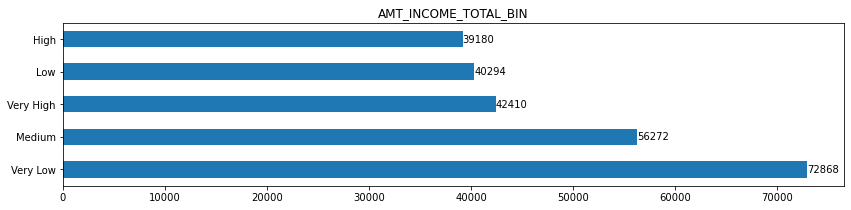

In [84]:
plt.figure(figsize=[14,3])
plt.title('AMT_INCOME_TOTAL_BIN')
df_application.AMT_INCOME_TOTAL_BIN.value_counts().plot.barh()
plt.bar_label(df_application.AMT_INCOME_TOTAL_BIN.value_counts().plot.barh().containers[0]);

In [85]:
#Binning AMT_CREDIT To AMT_CREDIT_BIN         
quant = np.quantile(df_application.AMT_CREDIT,[0,0.2,0.4,0.6,0.8,1]) 
df_application['AMT_CREDIT_BIN'] = pd.cut(df_application.AMT_CREDIT,quant,labels=['Very Low','Low','Medium','High','Very High'])

#Note- Number Of Bins(6) Must Be 1 More Than Number Of Labels(5)

In [86]:
df_application[['AMT_CREDIT_BIN']].head()

,AMT_CREDIT_BIN
0,Low
1,Very High
2,Very Low
3,Low
4,Medium


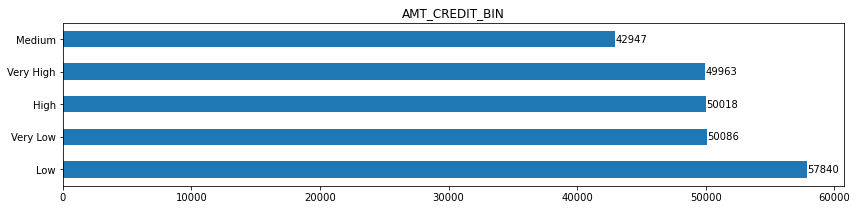

In [87]:
plt.figure(figsize=[14,3])
plt.title('AMT_CREDIT_BIN')
df_application.AMT_CREDIT_BIN.value_counts().plot.barh()
plt.bar_label(df_application.AMT_CREDIT_BIN.value_counts().plot.barh().containers[0]);

# ';' Also Works In Place Of plt.show

In [88]:
#Binning AMT_ANNUITY To AMT_ANNUITY_BIN
quant = np.quantile(df_application.AMT_ANNUITY,[0,0.2,0.4,0.6,0.8,1])
df_application['AMT_ANNUITY_BIN'] = pd.cut(df_application.AMT_ANNUITY,quant,labels=['Very Low','Low','Medium','High','Very High'])

#Note- Number Of Bins(6) Must Be 1 More Than Number Of Labels(5)

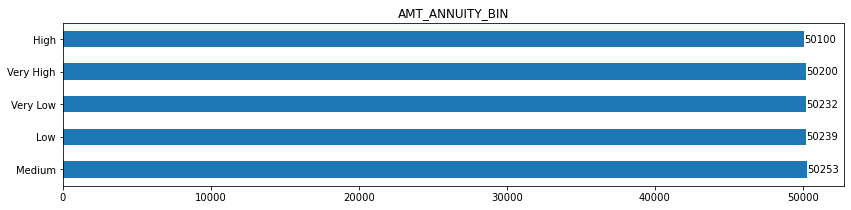

In [89]:
plt.figure(figsize=[14,3])
plt.title('AMT_ANNUITY_BIN')
df_application.AMT_ANNUITY_BIN.value_counts().plot.barh()
plt.bar_label(df_application.AMT_ANNUITY_BIN.value_counts().plot.barh().containers[0]);

In [90]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AMT_INCOME_TOTAL_BIN,AMT_CREDIT_BIN,AMT_ANNUITY_BIN
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6,High,Low,Medium
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1,Very High,Very High,High
2,100004,0,Revolving loans,M,Y,Y,0,67500,135000.0,6750.0,135000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260,2531,1,1,1,1,1,0,Laborers,1,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Male,1,52,1,12,7,Very Low,Very Low,Very Low
3,100006,0,Cash loans,F,N,Y,0,135000,312682.5,29686.5,297000,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833,2437,1,1,0,1,0,0,Laborers,2,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0,2,0,617,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,0,Female,1,52,8,27,7,Low,Low,High
4,100007,0,Cash loans,M,N,Y,0,121500,513000.0,21865.5,513000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311,3458,1,1,0,1,0,0,Core staff,1,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,1106,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Male,1,55,8,12,9,Low,Medium,Low


In [91]:
df_application.YEAR_BIRTH.describe() #min = 21 , max = 69   20 to 70

count    251025.000000
mean         40.474746
std          10.042986
min          21.000000
25%          32.000000
50%          40.000000
75%          48.000000
max          69.000000
Name: YEAR_BIRTH, dtype: float64

In [92]:
#Binning YEAR_BIRTH To AGE_BIN
quan= [20,30,40,50,60,70]
df_application['AGE_BIN']=pd.cut(df_application.YEAR_BIRTH,bins=quan,labels=['20-30','30-40','40-50','50-60','60-70'])

#Note- Number Of Bins(6) Must Be 1 More Than Number Of Labels(5)

In [93]:
df_application.AGE_BIN.value_counts()

30-40    81858
40-50    73237
20-30    48401
50-60    42368
60-70     5161
Name: AGE_BIN, dtype: int64

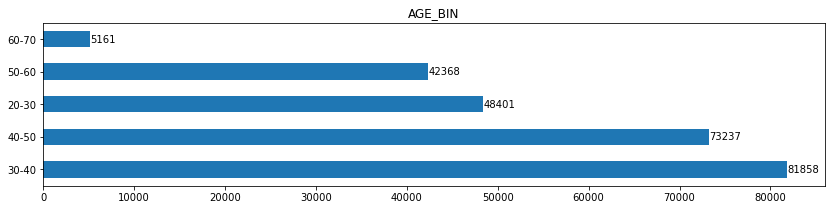

In [94]:
plt.figure(figsize=[14,3])        #Check Value Count.
plt.title('AGE_BIN')
df_application.AGE_BIN.value_counts().plot.barh()
plt.bar_label(df_application.AGE_BIN.value_counts().plot.barh().containers[0]);

In [95]:
df_application[['AGE_BIN','YEAR_BIRTH']].head(10) # Just Checking If It Worked Or Not.

,AGE_BIN,YEAR_BIRTH
0,20-30,26
1,40-50,46
2,50-60,52
3,50-60,52
4,50-60,55
5,40-50,46
6,30-40,38
7,50-60,52
9,30-40,40
10,20-30,28


#### TARGET = Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)

### 1 = True = Don't Have Money = Defaulters
### 0 = False = Have Money = Non-Defaulters

# 

## Creating A Function For Plot Titles

In [96]:
def plot_title(x,Size=16):
    a = {'family': 'serif',
        'color':  'darkred',    #With This Function We Can Manipulate title size,font,color,darkness Of a plot.
        'weight': 'normal',
        'size': Size,
        }
    return plt.title(x,fontdict=a)

### Checking For Data Imbalance,Univariate,Segmented Univariate And Bivariate Analysis And Correlation.

## Checking Imbalance In 'TARGET' Variable

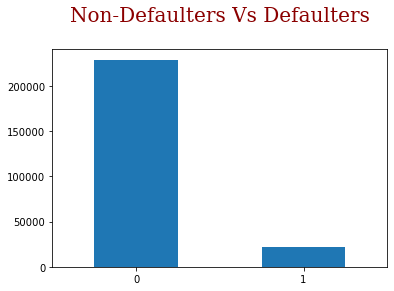

In [97]:
plot_title('Non-Defaulters Vs Defaulters\n',20)
df_application.TARGET.value_counts().plot.bar()
plt.xticks(rotation=0);

### Let's See In Percentage Value.

Imbalance Can Be Seen Clearly In The 'TARGET' Column


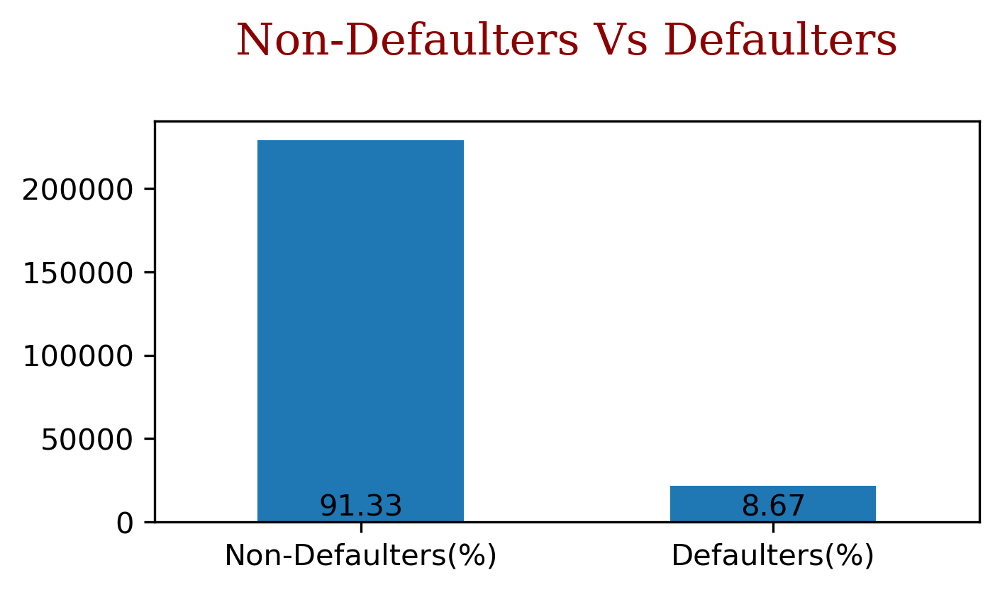

In [98]:
fig_with_dpi(5,2.5)
plot_title('Non-Defaulters Vs Defaulters\n',15) #title
percent_target=np.round(df_application.TARGET.value_counts(normalize=True)*100,2)
#percent_target.plot.bar()
percent_target.plot.bar()
plt.bar_label(df_application.TARGET.value_counts().plot.bar().containers[0])
plt.xticks(rotation=0,ticks=[0,1],labels=['Non-Defaulters(%)','Defaulters(%)']);
#df_application.TARGET.value_counts(normalize=True)*100
print("Imbalance Can Be Seen Clearly In The 'TARGET' Column")

In [99]:
df_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AMT_INCOME_TOTAL_BIN,AMT_CREDIT_BIN,AMT_ANNUITY_BIN,AGE_BIN
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6,High,Low,Medium,20-30
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1,Very High,Very High,High,40-50
2,100004,0,Revolving loans,M,Y,Y,0,67500,135000.0,6750.0,135000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260,2531,1,1,1,1,1,0,Laborers,1,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Male,1,52,1,12,7,Very Low,Very Low,Very Low,50-60
3,100006,0,Cash loans,F,N,Y,0,135000,312682.5,29686.5,297000,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833,2437,1,1,0,1,0,0,Laborers,2,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0,2,0,617,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,0,Female,1,52,8,27,7,Low,Low,High,50-60
4,100007,0,Cash loans,M,N,Y,0,121500,513000.0,21865.5,513000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311,3458,1,1,0,1,0,0,Core staff,1,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,1106,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Male,1,55,8,12,9,Low,Medium,Low,50-60


### Spliting Dataset Into Two Parts With Respect To 'Defaulter' And 'Non-Defaulter'

In [100]:
df_Target_NOND=df_application[df_application.TARGET == 0] # Non-Defaulter = df_Target_NOND dataset
df_Target_D=df_application[df_application.TARGET == 1] # Defaulter = df_Target_D dataset

#### Calculating Imbalance Percentage

In [101]:
imbalance = round(len(df_Target_NOND)/len(df_Target_D))
print(f'The Imbalance Percentage Is {imbalance}%')

The Imbalance Percentage Is 11%


In [102]:
df_Target_D.head() #Checking

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AMT_INCOME_TOTAL_BIN,AMT_CREDIT_BIN,AMT_ANNUITY_BIN,AGE_BIN
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6,High,Low,Medium,20-30
26,100031,1,Cash loans,F,N,Y,0,112500,979992.0,27076.5,702000,Unaccompanied,Working,Secondary / secondary special,Widow,House / apartment,0.018029,18724,2628,6573,1827,1,1,0,1,0,0,Cooking staff,1,3,2,MONDAY,9,0,0,0,0,0,0,Business Entity Type 3,0.548477,0.190706,0.9732,0.0417,0.9732,0.0417,0.9732,0.0417,0.0085,Yes,10,1,10,0,161,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,2,2,0,Female,1,51,7,18,5,Very Low,Very High,Medium,50-60
40,100047,1,Cash loans,M,N,Y,0,202500,1193580.0,35028.0,855000,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.025164,17482,1262,1182,1029,1,1,0,1,0,0,Laborers,2,2,2,TUESDAY,9,0,0,0,0,0,0,Business Entity Type 3,0.306841,0.320163,0.9960,0.2500,0.9960,0.2500,0.9960,0.2500,0.1463,No,0,0,0,0,1075,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,4,0,Male,1,48,3,3,3,High,Very High,High,40-50
42,100049,1,Cash loans,F,N,N,0,135000,288873.0,16258.5,238500,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.007305,13384,3597,45,4409,1,1,1,1,1,0,Sales staff,2,3,3,THURSDAY,11,0,0,0,0,0,0,Self-employed,0.674203,0.399676,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,1,0,1480,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Female,0,37,10,0,12,Low,Low,Low,30-40
94,100112,1,Cash loans,M,Y,Y,0,315000,953460.0,64107.0,900000,Family,Commercial associate,Incomplete higher,Single / not married,With parents,0.030755,10199,2015,4802,1038,1,1,0,1,0,0,NaN,1,2,2,SUNDAY,13,0,0,0,0,1,1,Industry: type 4,0.432340,0.077499,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,591,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,1,Male,1,28,6,13,3,Very High,Very High,Very High,20-30


In [103]:
df_Target_NOND.head() #Checking

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AMT_INCOME_TOTAL_BIN,AMT_CREDIT_BIN,AMT_ANNUITY_BIN,AGE_BIN
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1,Very High,Very High,High,40-50
2,100004,0,Revolving loans,M,Y,Y,0,67500,135000.0,6750.0,135000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260,2531,1,1,1,1,1,0,Laborers,1,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Male,1,52,1,12,7,Very Low,Very Low,Very Low,50-60
3,100006,0,Cash loans,F,N,Y,0,135000,312682.5,29686.5,297000,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833,2437,1,1,0,1,0,0,Laborers,2,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0,2,0,617,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,0,Female,1,52,8,27,7,Low,Low,High,50-60
4,100007,0,Cash loans,M,N,Y,0,121500,513000.0,21865.5,513000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311,3458,1,1,0,1,0,0,Core staff,1,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,1106,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Male,1,55,8,12,9,Low,Medium,Low,50-60
5,100008,0,Cash loans,M,N,Y,0,99000,490495.5,27517.5,454500,"Spouse, partner",State servant,Secondary / secondary special,Married,House / apartment,0.035792,16941,1588,4970,477,1,1,1,1,1,0,Laborers,2,2,2,WEDNESDAY,16,0,0,0,0,0,0,Other,0.354225,0.621226,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,2536,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Male,1,46,4,14,1,Very Low,Medium,Medium,40-50


# Univariate Analysis Of Categorical Value

#### Creating A Function For Univariate Analysis Of Categorical Value Of Application Dataset.

In [104]:
def univar(a,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal', 
        'size': 15 }            
    plt.figure(figsize=fig_size,dpi=300)
    plt.subplot(1,2,1)
    plt.title(f'Distribution of {a} for Non-Defaulters',fontsize=title_size)
    aa=sns.countplot(data=df_Target_NOND,x=a,palette='Purples_r',order = df_Target_NOND[a].value_counts().index) #x = a 
    plt.xlabel(xlabel='\nNon-Defaulters',fontdict= fon) # Plot 1 For Non-Defaulter
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count',size=xt)
    plt.bar_label(aa.containers[0],rotation=barot,label_type=labe)
    plt.subplot(1,2,2)
    plt.title(f'Distribution of {a} for Defaulters',fontsize=title_size)
    bb=sns.countplot(data=df_Target_D,x=a,palette='Purples_r',order = df_Target_D[a].value_counts().index) #x=a
    plt.xlabel(xlabel='\nDefaulters',fontdict= fon) # Plot 2 For Defaulter
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count',size=xt)
    plt.bar_label(bb.containers[0],rotation=barot,label_type=labe)
    plt.tight_layout(pad=7)
    
    # Using 2 Subplots,one for Defaulters and another for non-defaulters
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size

In [105]:
categorical_Val #These Are All Categorical Columns In Application Dataframe.

Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE',
       'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE',
       'EMERGENCYSTATE_MODE', 'GENDER'],
      dtype='object')

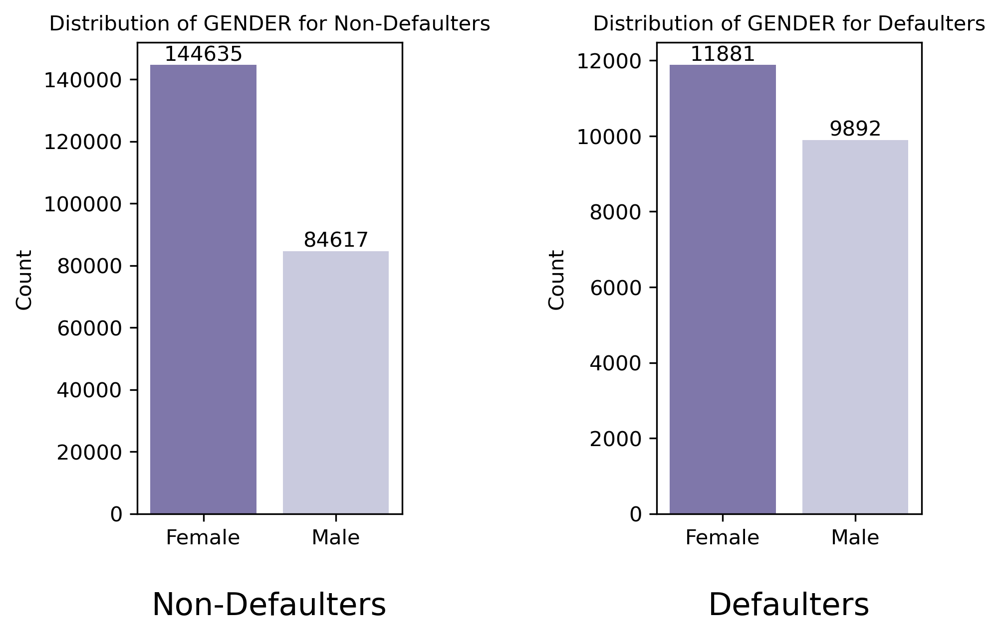

In [106]:
univar('GENDER')

#'Females' Are High In Both Non-Defaulters and Defaulters As Compared To 'Males'.

plt.savefig('female_male.svg',transparent=True,bbox_inches='tight')

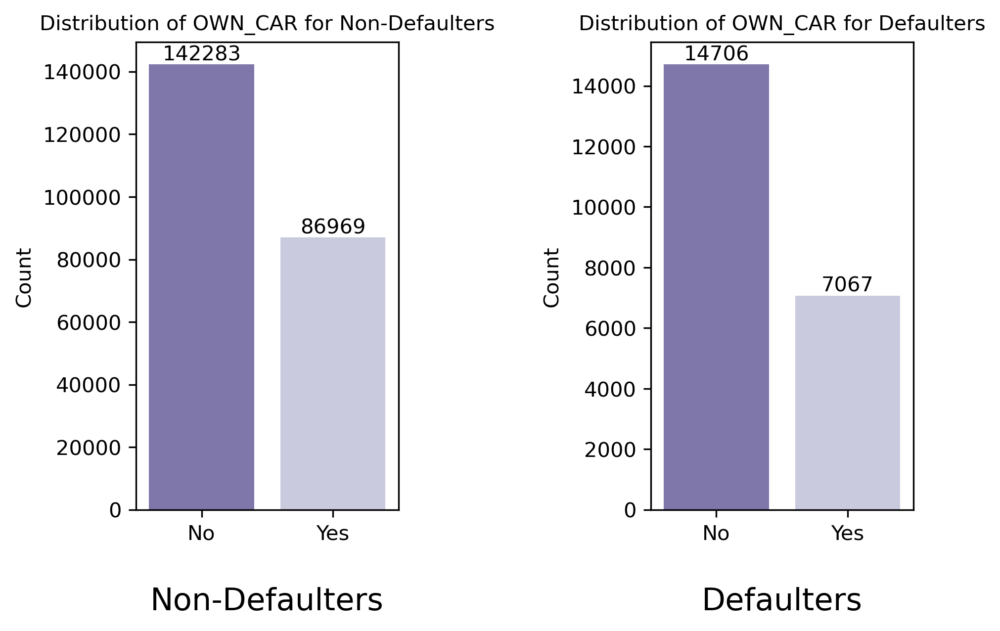

In [107]:
univar('OWN_CAR',tic=[0,1],lab=['No','Yes'])

#People Who Own Car Is 'Less' Than People Who 'Don't' Own Car In Both Non-Defaulters And Defaulters. (No>Yes)

plt.savefig('nocar.svg',transparent=True,bbox_inches='tight')

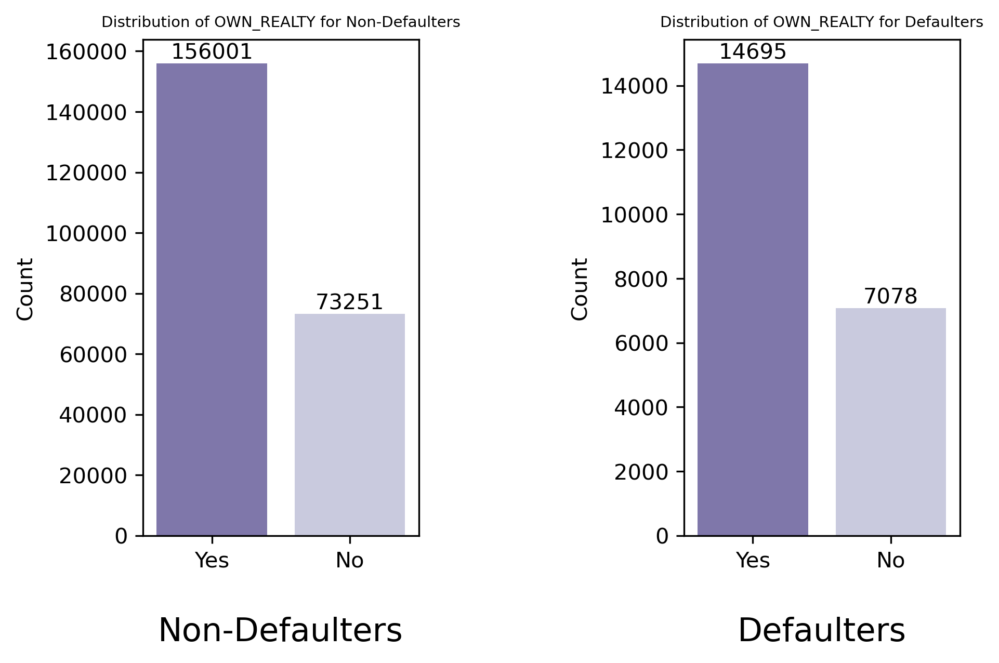

In [108]:
univar('OWN_REALTY',tic=[0,1],lab=['Yes','No'],title_size=7)

# People Who Said 'Yes' Have Property Rate More Than The People Who Said 'No' In Both Defaulters And Non-Defaulters
# People With Property Deals Make More Loans.

plt.savefig('Realty.svg',transparent=True,bbox_inches='tight')

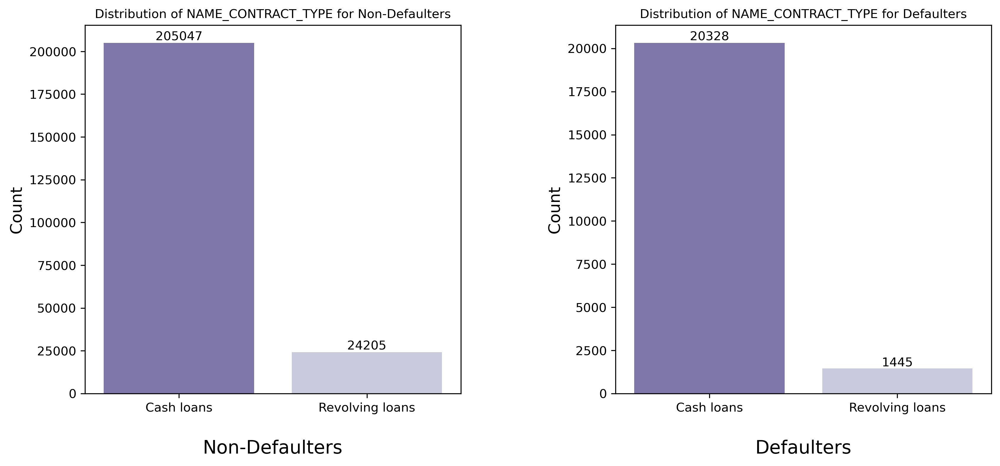

In [109]:
univar('NAME_CONTRACT_TYPE',rot=0,fig_size=[13,7],xt=13)

#People With 'Cash Loans' Are More In Both Defaulters And Non-Defaulters Than The One With Revolving loans.

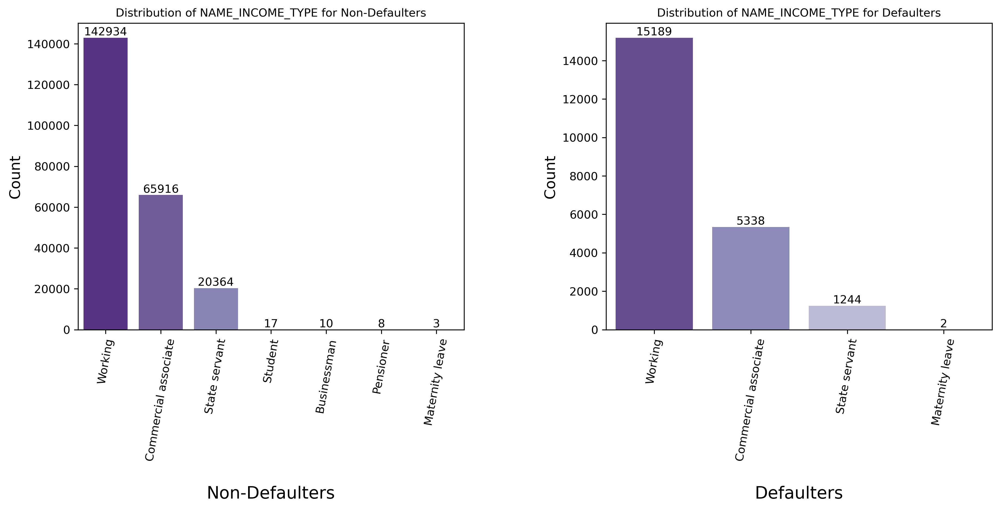

In [110]:
univar('NAME_INCOME_TYPE',rot=80,fig_size=[14,8],xt=13)

# People With 'Working' Income Type Take More Loans In Both Defaulters And Non-Defaulters 

plt.savefig('name_inc.svg',transparent=True,bbox_inches='tight')

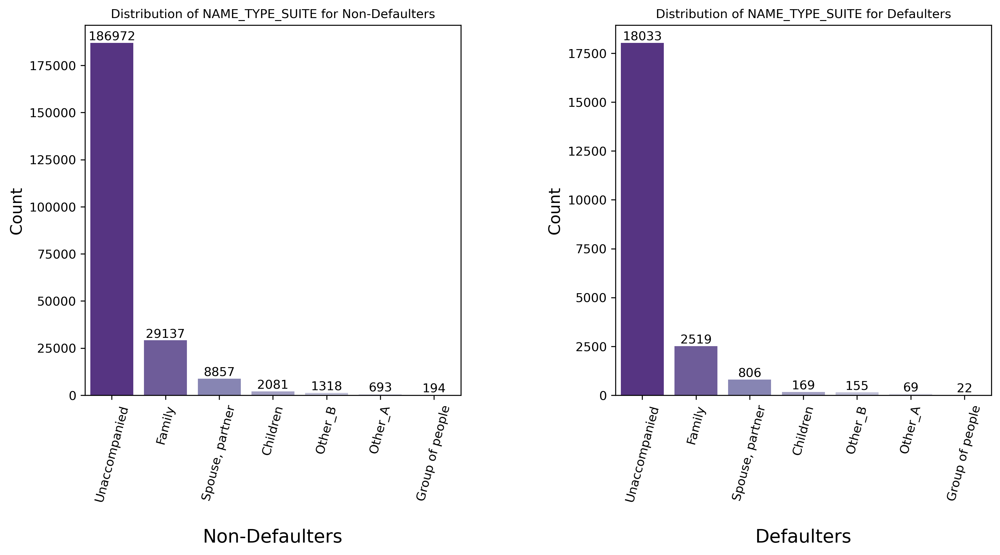

In [111]:
univar('NAME_TYPE_SUITE',rot=75,fig_size=[13,8],xt=13)

# People With 'Unaccompanied' Name Type Take More Loans In Both Defaulters And Non-Defaulters 
# Name Type With 'Family' Comes 2nd.

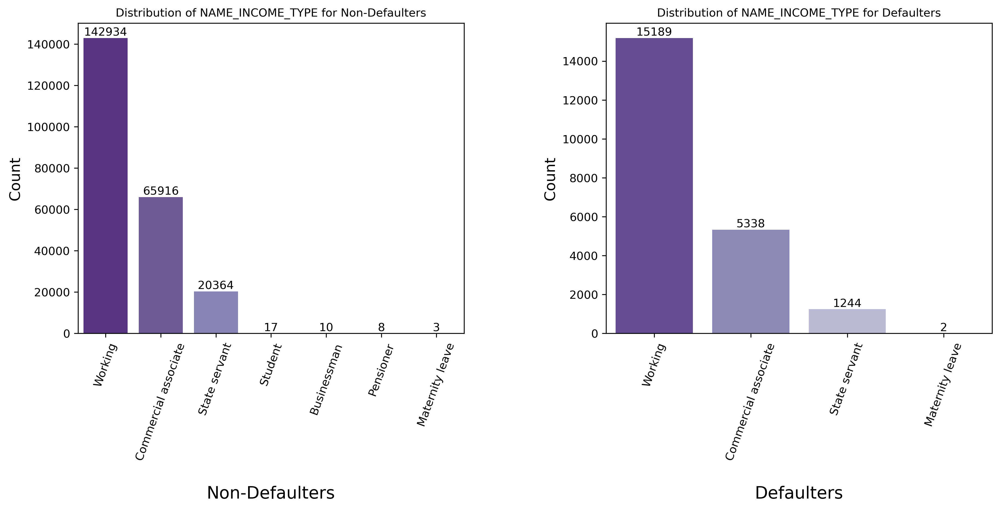

In [112]:
univar('NAME_INCOME_TYPE',rot=70,fig_size=[14,8],xt=13)

#People With Income Type 'Working' Take More Loans
#People With Income Type 'Commercial Associate' Comes Second In Both Defaulters And Non-Defaulters.

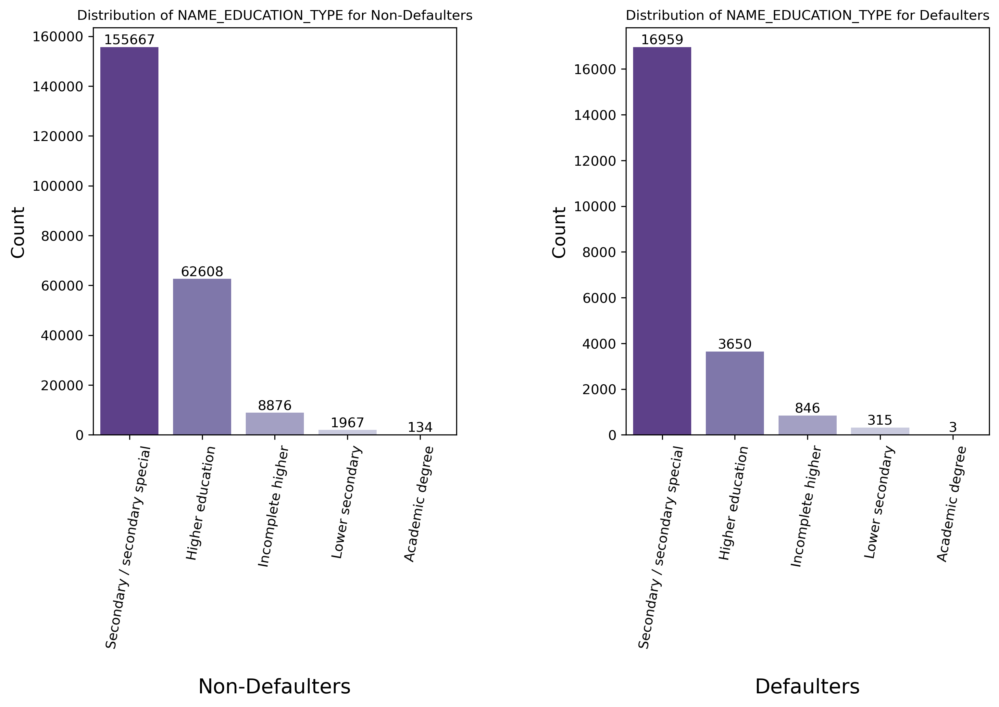

In [113]:
univar('NAME_EDUCATION_TYPE',rot=80,fig_size=[12,9],fsize=10,xt=13)

#People WIth 'Secondary' Education Type Takes More Loans.
#People With 'Higher' Comes Second In Both Defaultes and Non-Defaulters.

plt.savefig('education.svg',transparent=True,bbox_inches='tight')

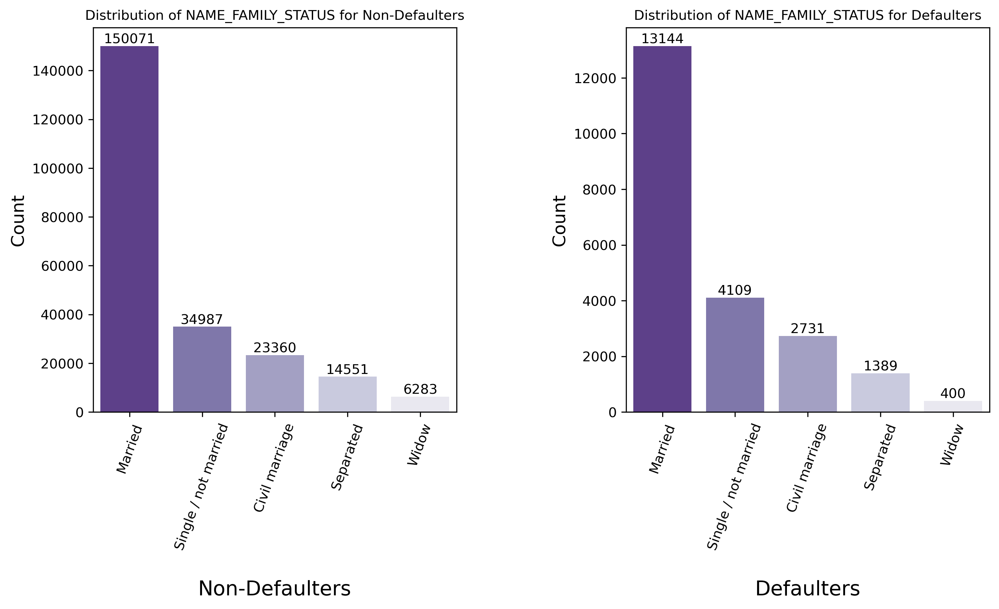

In [114]:
univar('NAME_FAMILY_STATUS',rot=70,fig_size=[12,8],fsize=10,xt=13)

#People With 'Married' Family Status Take More Loans.
#People With 'Single' Family Status Comes Second In Both Defaulters and Non-Defaulters.

plt.savefig('famstatus.svg',transparent=True,bbox_inches='tight')

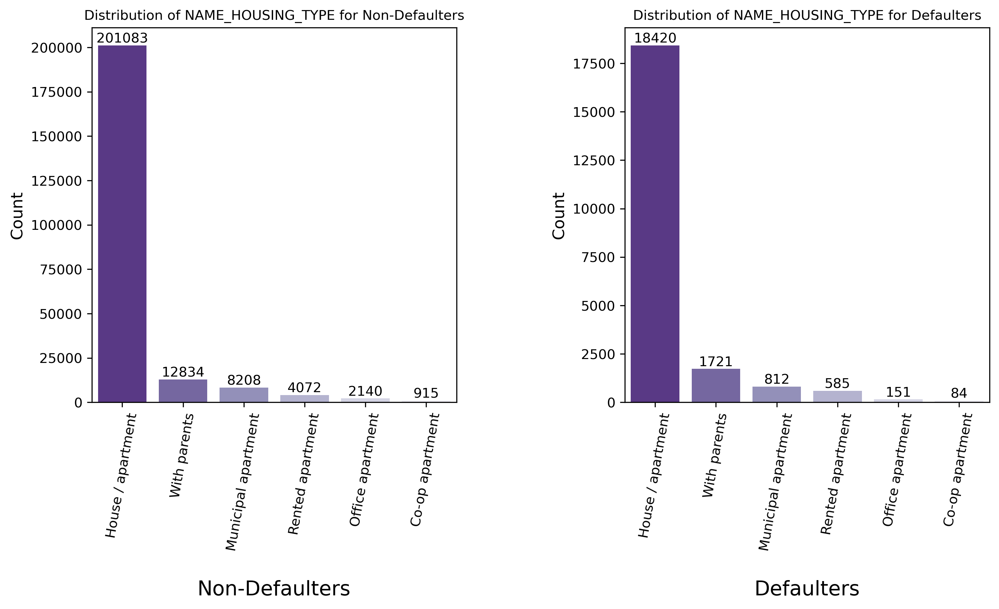

In [115]:
univar('NAME_HOUSING_TYPE',rot=80,fig_size=[12,8],fsize=10,xt=12)

# Peope Having 'House/Apartment' Take More Loans In Both Defaulters And Non-Defaulters

plt.savefig('housetype.svg',transparent=True,bbox_inches='tight')

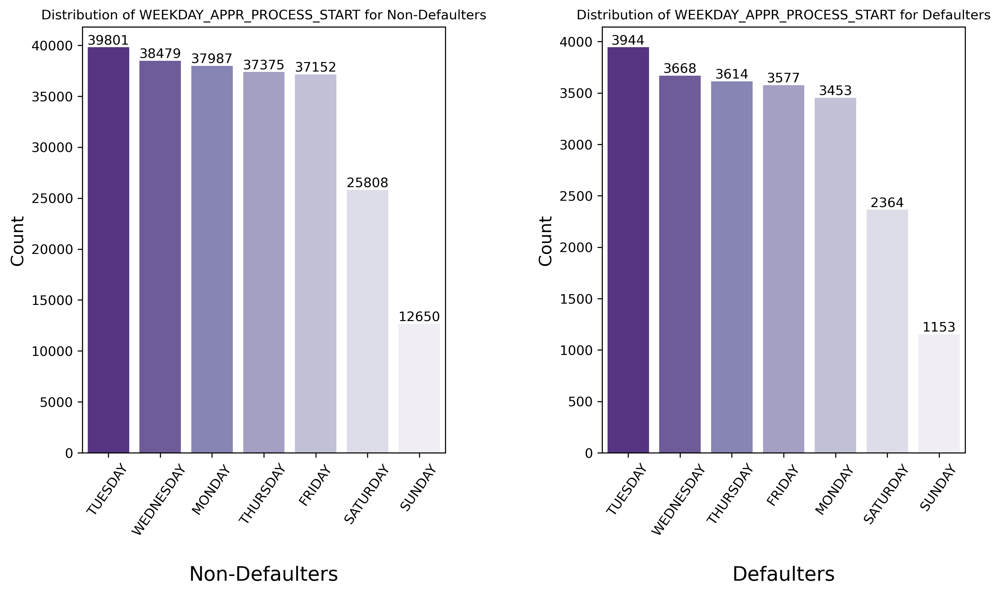

In [116]:
univar('WEEKDAY_APPR_PROCESS_START',rot=55,fig_size=[12,8],xt=13)

#Most Loans Were Applied On 'Tuesday' And Least Loans Were Applied On 'Sunday'.

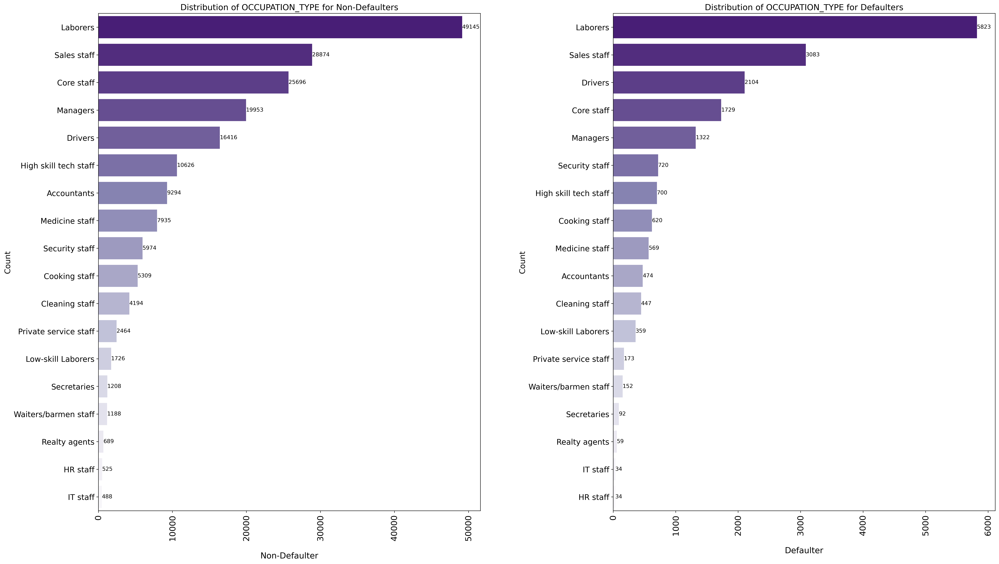

In [117]:
fon = { 'weight': 'normal',
        'size': 15 }
plt.figure(figsize=[27,16],dpi=300)
plt.subplot(1,2,1)
plt.title(f'Distribution of OCCUPATION_TYPE for Non-Defaulters',fontsize=15)
aa=sns.countplot(data=df_Target_NOND,y=df_Target_NOND.OCCUPATION_TYPE,palette='Purples_r',order = df_Target_NOND.OCCUPATION_TYPE.value_counts().index) #x = a 
plt.xlabel(xlabel='\nNon-Defaulter',fontdict= fon) # Plot 1 For Non-Defaulter
plt.xticks(size=15,rotation=90)
plt.ylabel('Count',size=14)
plt.yticks(size=14)
plt.bar_label(aa.containers[0],rotation=0)
plt.subplot(1,2,2)
plt.title(f'Distribution of OCCUPATION_TYPE for Defaulters',fontsize=15)
bb=sns.countplot(data=df_Target_D,y=df_Target_D.OCCUPATION_TYPE,palette='Purples_r',order = df_Target_D.OCCUPATION_TYPE.value_counts().index) #x=a
plt.xlabel(xlabel='\nDefaulter',fontdict= fon) # Plot 2 For Defaulter
plt.xticks(size=15,rotation=90)
plt.ylabel('Count',size=14)
plt.yticks(size=14)
plt.bar_label(bb.containers[0],rotation=0)
plt.tight_layout(pad=7)

#### Remove '#' Below To See Count plot Instead Of Count.

# plt.figure(figsize=[16,11],dpi=300)
# plt.subplot(1,2,1)
# plt.title(f'Distribution of OCCUPATION_TYPE for Non-Defaulters',fontsize=15)
# bbb=list(df_Target_NOND.OCCUPATION_TYPE.value_counts().head(10).index)
# plt.pie(x=df_Target_NOND.OCCUPATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
# plt.subplot(1,2,2)
# plt.title(f'Distribution of OCCUPATION_TYPE for Defaulters',fontsize=15)
# bbb=list(df_Target_D.OCCUPATION_TYPE.value_counts().head(10).index)
# plt.pie(x=df_Target_D.OCCUPATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
# plt.tight_layout(pad=5);

# Only Taken Top 10 Categories In Pie Because There Were Lot Of Categories.

#Most Of The Loans Are Taken By 'Laborers' And Than 'Sales Staff'.

plt.savefig('occupation.svg',transparent=True,bbox_inches='tight')

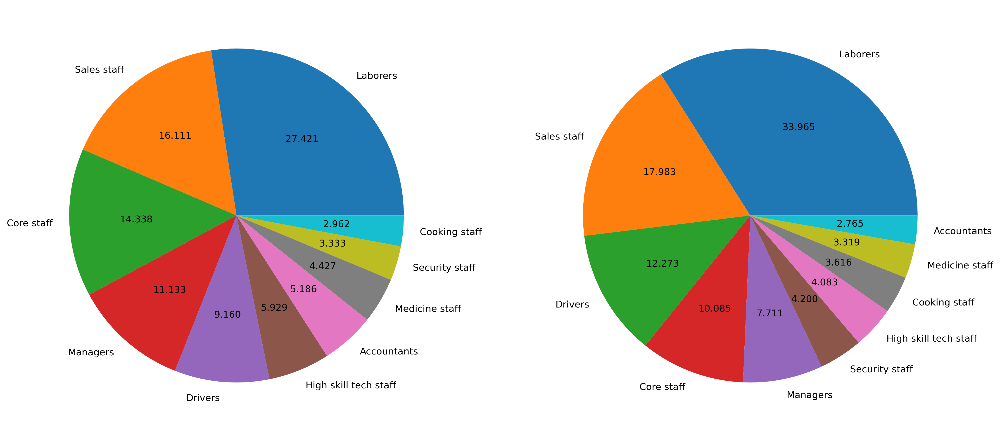

In [118]:
plt.figure(figsize=[16,11],dpi=300)
plt.subplot(1,2,1)
#plt.title(f'Distribution of OCCUPATION_TYPE for Non-Defaulters',fontsize=15)
bbb=list(df_Target_NOND.OCCUPATION_TYPE.value_counts().head(10).index)
plt.pie(x=df_Target_NOND.OCCUPATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
plt.subplot(1,2,2)
#plt.title(f'Distribution of OCCUPATION_TYPE for Defaulters',fontsize=15)
bbb=list(df_Target_D.OCCUPATION_TYPE.value_counts().head(10).index)
plt.pie(x=df_Target_D.OCCUPATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
plt.tight_layout(pad=5);

#Top 10 OCCUPATION Type Of Above Graph For Better Clarity.


plt.savefig('occupation_pie.svg',transparent=True,bbox_inches='tight')

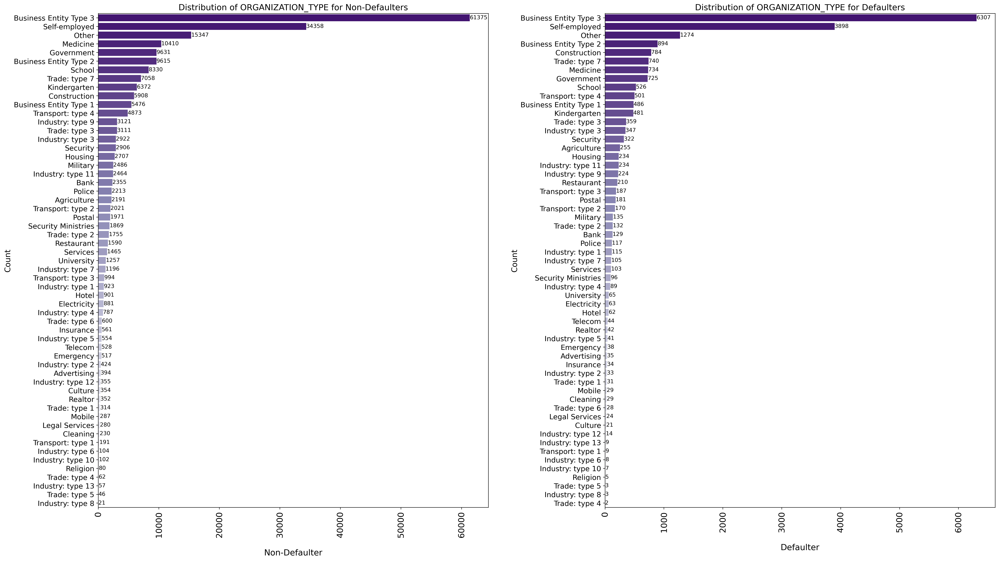

In [119]:
fon = { 'weight': 'normal',
        'size': 15 }
plt.figure(figsize=[26,15],dpi=300)
plt.subplot(1,2,1)
plt.title(f'Distribution of ORGANIZATION_TYPE for Non-Defaulters',fontsize=15)
aa=sns.countplot(data=df_Target_NOND,y=df_Target_NOND.ORGANIZATION_TYPE,palette='Purples_r',order = df_Target_NOND.ORGANIZATION_TYPE.value_counts().index) #x = a 
plt.xlabel(xlabel='\nNon-Defaulter',fontdict= fon) # Plot 1 For Non-Defaulter
plt.xticks(size=15,rotation=90)
plt.ylabel('Count',size=14)
plt.yticks(size=13)
plt.bar_label(aa.containers[0],rotation=0)
plt.subplot(1,2,2)
plt.title(f'Distribution of ORGANIZATION_TYPE for Defaulters',fontsize=15)
bb=sns.countplot(data=df_Target_D,y=df_Target_D.ORGANIZATION_TYPE,palette='Purples_r',order = df_Target_D.ORGANIZATION_TYPE.value_counts().index) #x=a
plt.xlabel(xlabel='\nDefaulter',fontdict= fon) # Plot 2 For Defaulter
plt.xticks(size=15,rotation=90)
plt.ylabel('Count',size=14)
plt.yticks(size=13)
plt.bar_label(bb.containers[0],rotation=0)
plt.tight_layout(pad=4)

#### Remove '#' Below To See Pie plot Instead Of Count Plot.

# plt.figure(figsize=[14,9],dpi=300)
# plt.subplot(1,2,1)
# plt.title(f'Distribution of ORGANIZATION_TYPE for Non-Defaulters',fontsize=15)
# bbb=list(df_Target_NOND.ORGANIZATION_TYPE.value_counts().head(10).index)
# plt.pie(x=df_Target_NOND.ORGANIZATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
# plt.subplot(1,2,2)
# plt.title(f'Distribution of ORGANIZATION_TYPE for Defaulters',fontsize=15)
# bbb=list(df_Target_D.ORGANIZATION_TYPE.value_counts().head(10).index)
# plt.pie(x=df_Target_D.ORGANIZATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f');





# Only Taken Top 10 Categories In Pie Because There Were Lot Of Categories.

# People With Organization Type 'Busuness Entity Type 3' and 'Unknown Type' Take More Loans In Non-Defaulters.
# People With Organization Type 'Busuness Entity Type 3' and 'Self-Employed' Take More Loans In Defaulters.

plt.savefig('organisation.svg',transparent=True,bbox_inches='tight')

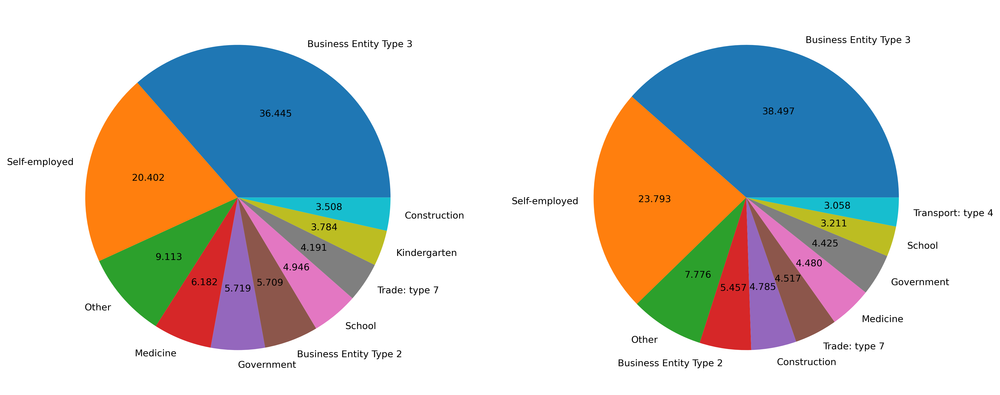

In [120]:
plt.figure(figsize=[16,11],dpi=300)
plt.subplot(1,2,1)
#plt.title(f'Distribution of ORGANIZATION_TYPE for Non-Defaulters',fontsize=15)
bbb=list(df_Target_NOND.ORGANIZATION_TYPE.value_counts().head(10).index)
plt.pie(x=df_Target_NOND.ORGANIZATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
plt.subplot(1,2,2)
#plt.title(f'Distribution of ORGANIZATION_TYPE for Defaulters',fontsize=15)
bbb=list(df_Target_D.ORGANIZATION_TYPE.value_counts().head(10).index)
plt.pie(x=df_Target_D.ORGANIZATION_TYPE.value_counts().head(10),labels=bbb,autopct='%.3f')
plt.tight_layout(pad=5);

#Top 10 Organisation Type Of Above Graph For Better Clarity.

plt.savefig('organisation_pie.svg',transparent=True,bbox_inches='tight')

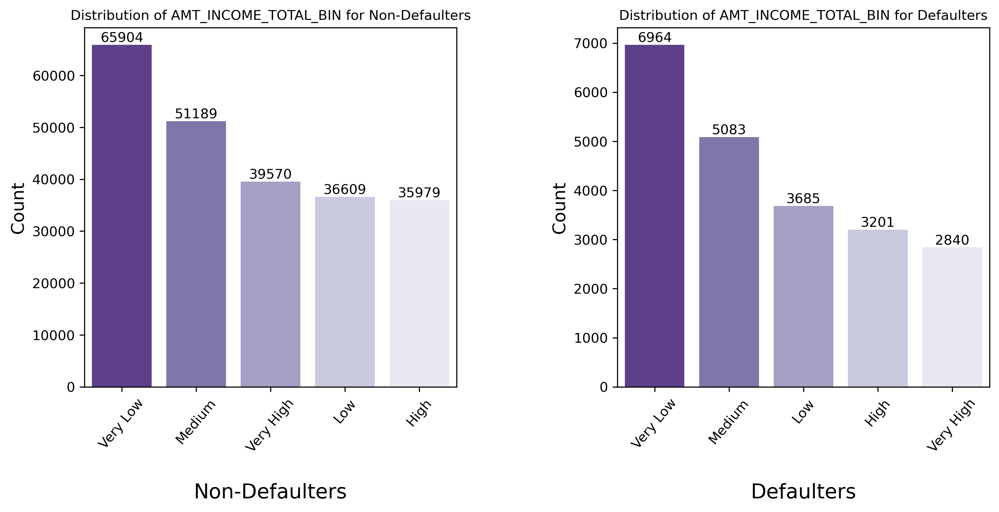

In [121]:
univar('AMT_INCOME_TOTAL_BIN',rot=50,fig_size=[12,7],xt=13)

# People With Total Income 'Low' Take More Loans.
# People With Total Income 'High' Comes Second.
# People With Total Income 'Medium' And 'Very High' Take Least Loans.

plt.savefig('incm.svg',bbox_inches='tight',transparent=True)

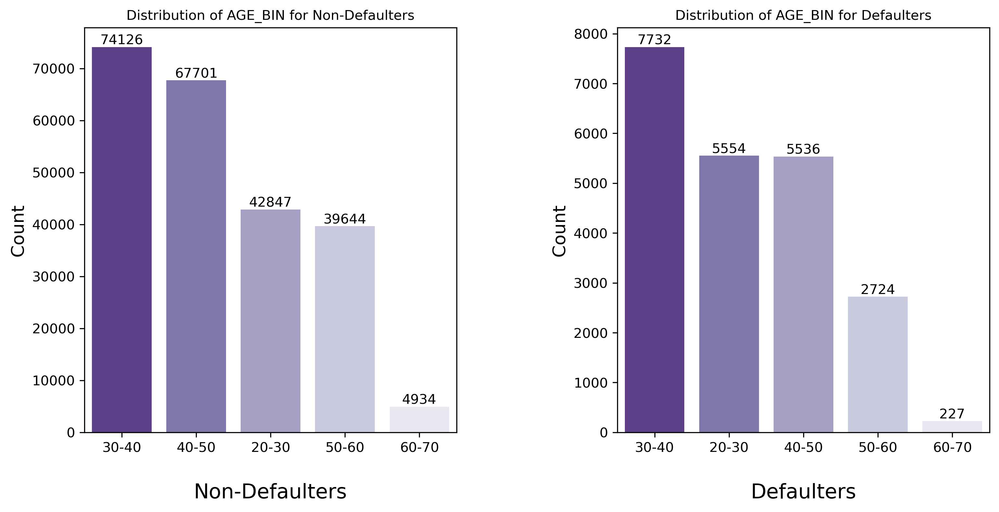

In [122]:
univar('AGE_BIN',rot=0,fig_size=[12,7],xt=13)
#People With Age 30-40 Take More Loans.
#People With Age 40-50 Comes Second.
#People With Age 60-70 Comes Last.

plt.savefig('age.svg',bbox_inches='tight',transparent=True)

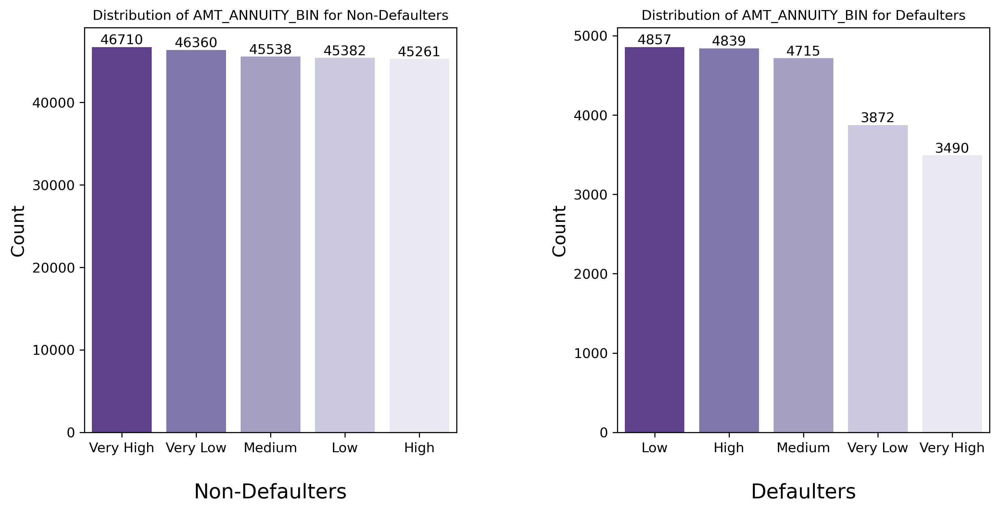

In [123]:
univar('AMT_ANNUITY_BIN',rot=0,fig_size=[12,7],xt=13)

# People With 'Very High' Annuity Amount Take Least Loans In Defaulters.

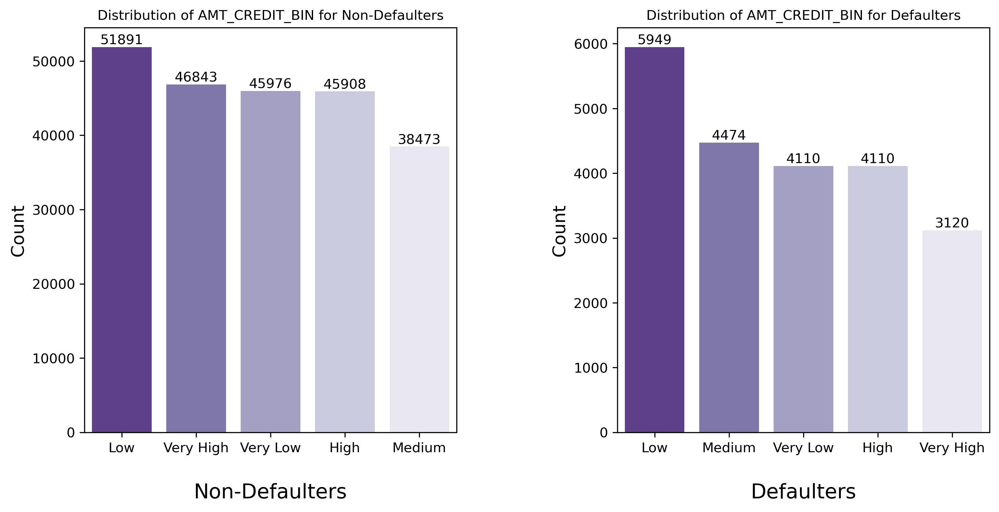

In [124]:
univar('AMT_CREDIT_BIN',rot=0,fig_size=[12,7],xt=13)

#People With 'Very High' Credit Amount Takes Least Loan In Defaulters
#People With 'Medium' Credit Amount Takes More Loan In Defaulters

## Univariate Analysis Of Numerical Variable.

In [125]:
numerical_var # Checking For All Numerical Columns In Application Dataset.

#I Have Masked And Saved Different DataType To Variables So That I Could Use Them Later To Find Different dtype Columns Easily.

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL', 'FLAG_EMP_PHONE',
       'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'YEARS_BEGINEXPLUATATION_AVG', 'FLOORSMAX_AVG',
       'YEARS_BEGINEXPLUATATION_MODE', 'FLOORSMAX_MODE',
       'YEARS_BEGINEXPLUATATION_MEDI', 'FLOORSMAX_MEDI', 'TOTALAREA_MODE',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
      

#### Creating Function For Univariate Analysis Of Continuous Variable.

In [126]:
def univarcon(a,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 10 }
    plt.figure(figsize=fig_size,dpi=300)
    plt.subplot(1,2,1)
    plt.title(f'Distribution of {a} In Target',fontsize=title_size)
    aa=sns.distplot(df_Target_NOND[a],hist=False,label='Non-Defaulters',color='violet') #x = a 
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    bb=sns.distplot(df_Target_D[a],hist=False,label='Defaulters',color='purple') #x=a
    plt.tight_layout(pad=7) #By Assigning pad,I can Manipulate Distance Between Two Subplots.
    plt.legend()
    
    # Using Dist Plot.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size
    # With This Function I Can Manipulate Size,Shape,rotation,ticks,titles,etc Very Easily.

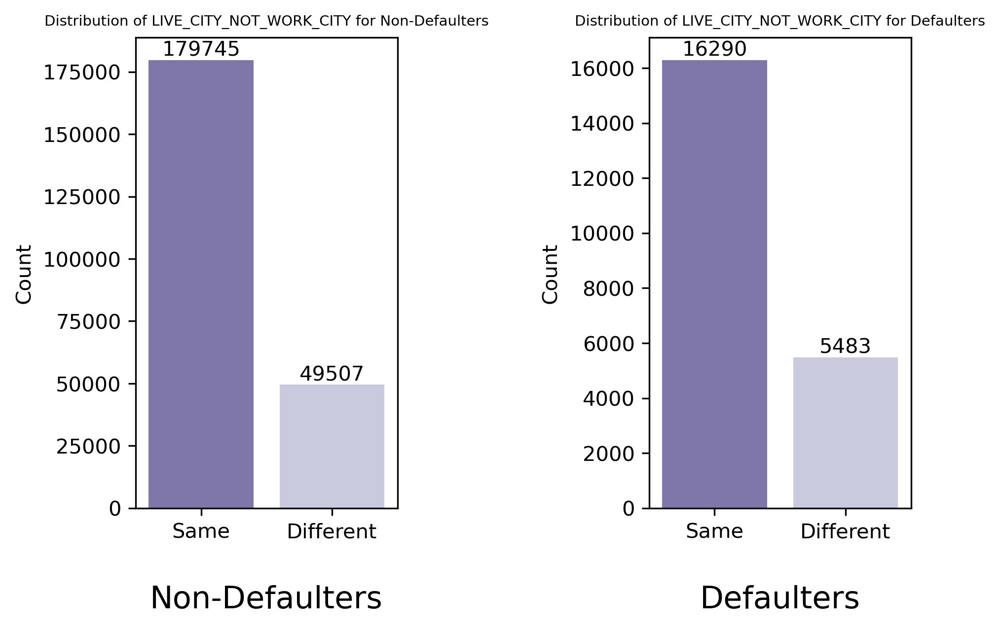

In [127]:
univar('LIVE_CITY_NOT_WORK_CITY',tic=[0,1],lab=['Same','Different'],title_size=7)

#Flag if client's contact address does not match work address (1=different, 0=same, at region level)

# People With 'Same' Living City And Work City Take More Loans.

plt.savefig('samecity.svg',transparent=True,bbox_inches='tight')

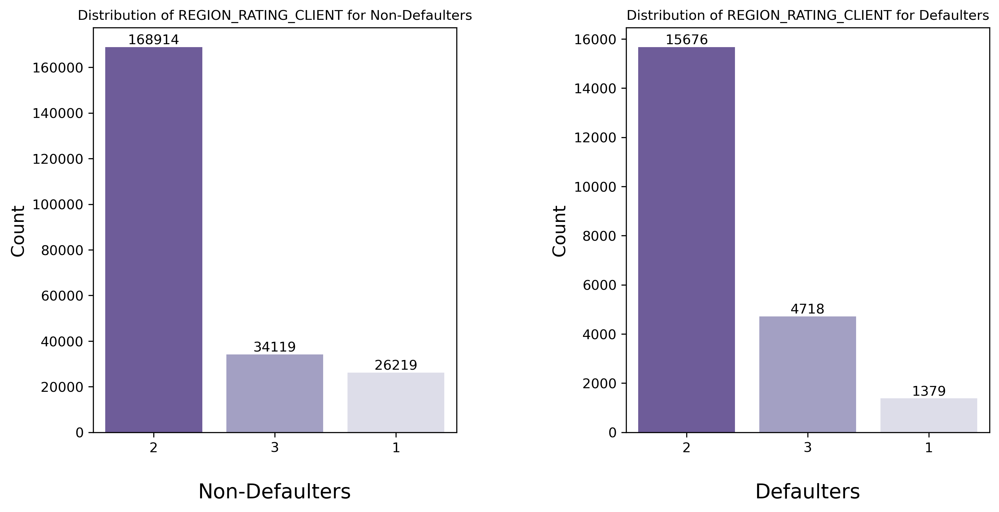

In [128]:
univar('REGION_RATING_CLIENT',rot=0,fig_size=[12,7],xt=13)

#REGION_RATING_CLIENT = Our rating of the region where client lives (1,2,3)

#People With Rating Of Region '2' Take More Loans.

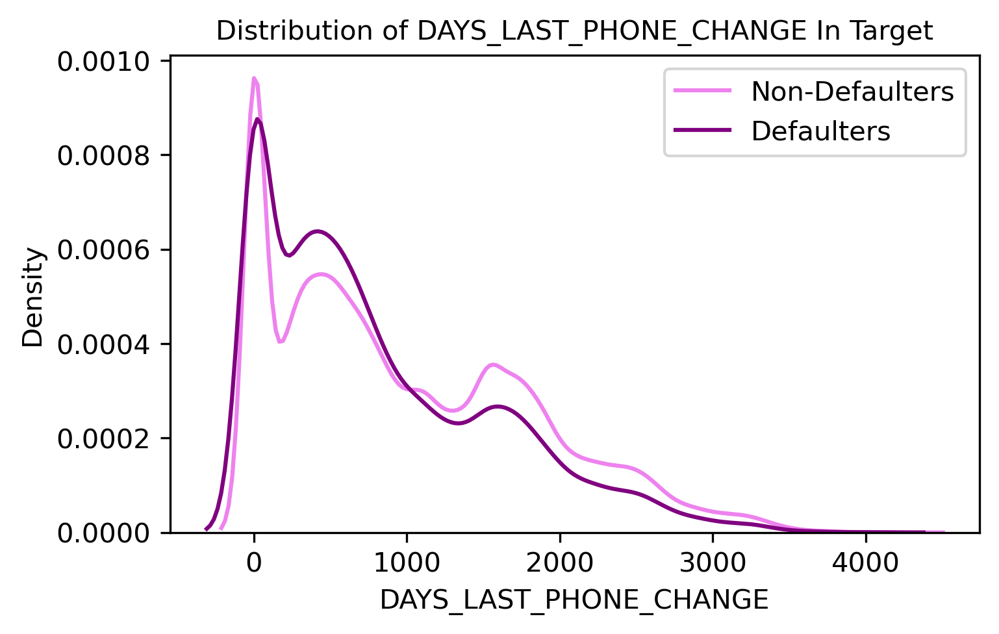

In [129]:
univarcon('DAYS_LAST_PHONE_CHANGE',rot=0,fig_size=[12,5],xt=None,title_size=None)

#DAYS_LAST_PHONE_CHANGE=How many days before application did client change phone.

#People Who Take More Loans Changed Their Phone 'Recently'.


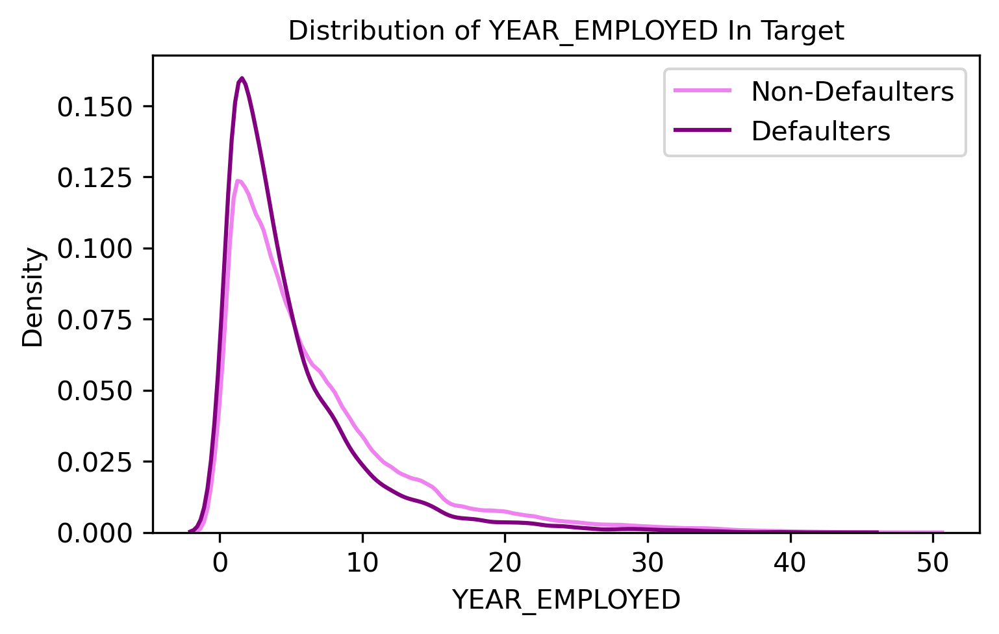

In [130]:
univarcon('YEAR_EMPLOYED',rot=0,fig_size=[12,5],xt=13)

#Fresh Employees Take More Loans.

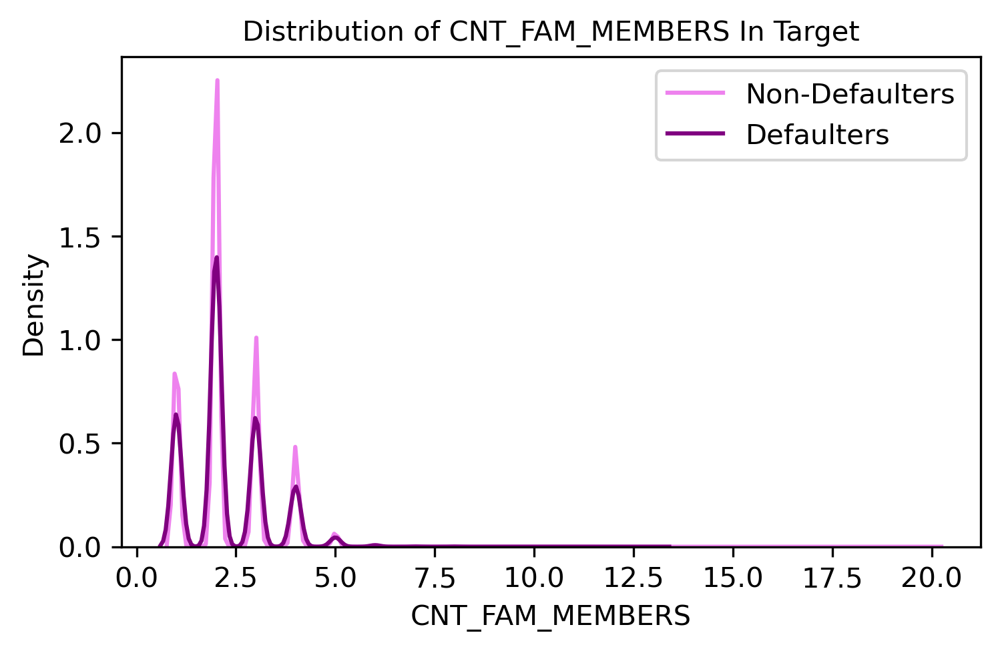

In [131]:
univarcon('CNT_FAM_MEMBERS',rot=0,fig_size=[12,5],xt=13)

#CNT_FAM_MEMBERS = How many family members does client have.

#People With Family Members '2' Take More Loans.

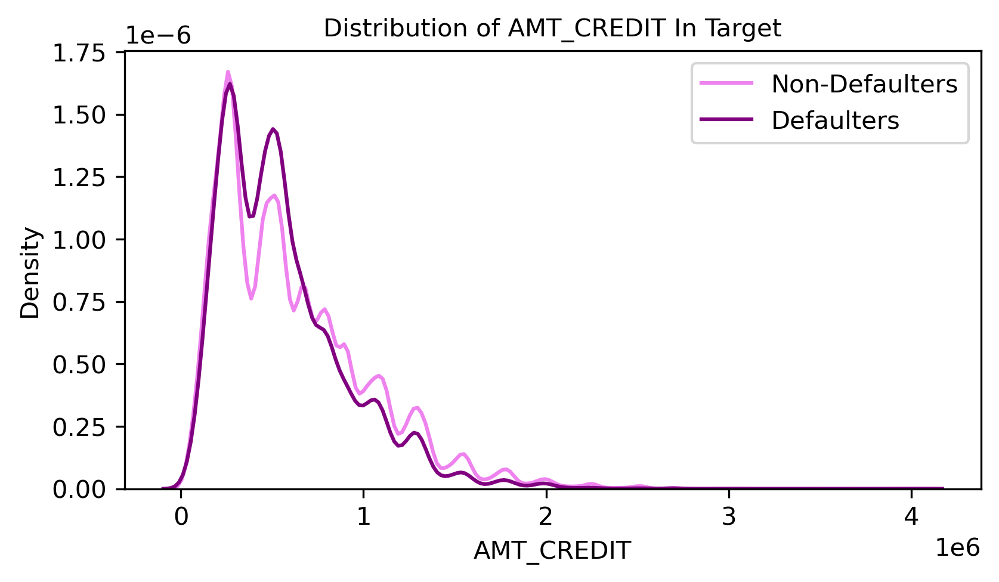

In [132]:
univarcon('AMT_CREDIT',rot=0,fig_size=[13,5],xt=13)

#People With 'Less' Credit Amount Take More Loans.

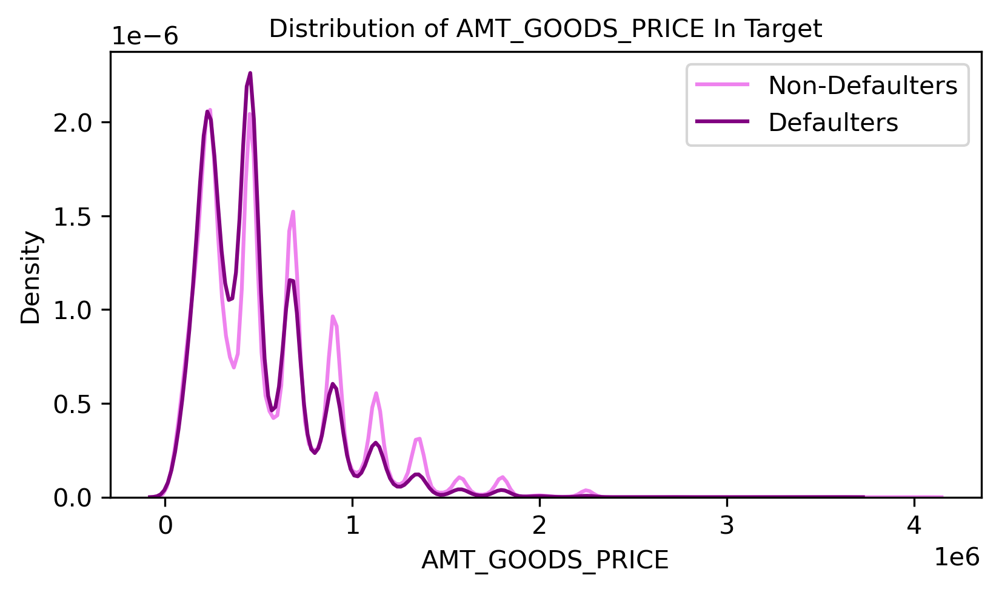

In [133]:
univarcon('AMT_GOODS_PRICE',rot=0,fig_size=[13,5],xt=13)

#People With Less Good's Price Amount Take More Loans.

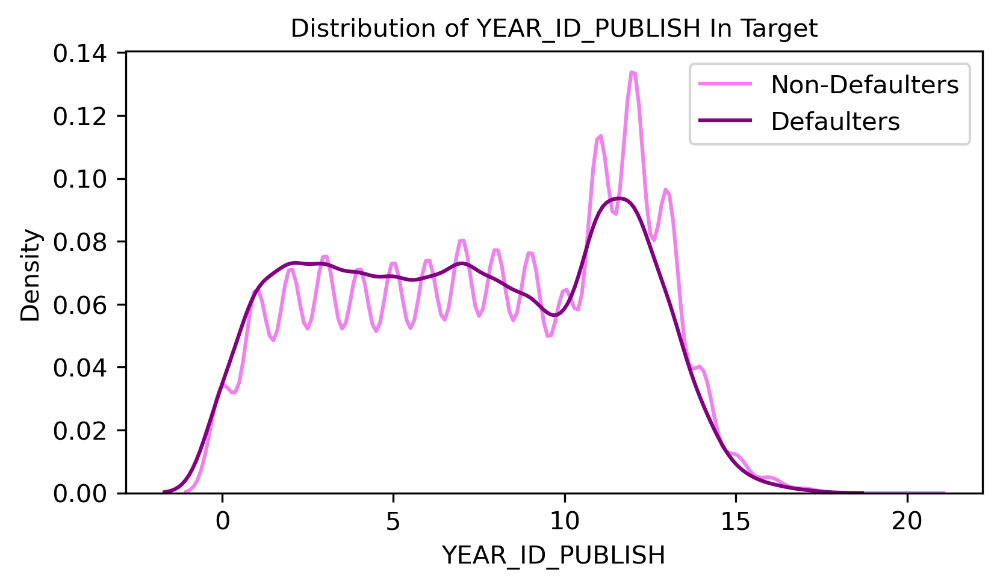

In [134]:
univarcon('YEAR_ID_PUBLISH',rot=0,fig_size=[13,5],xt=13)

#DAYS_ID_PUBLISH = How many days before the application did client change the identity document with which he applied for the loan.

#People Who Changed Their Identity Document 'Many' Years(10 to 15) Before Applying For Loans,Take More Loans.

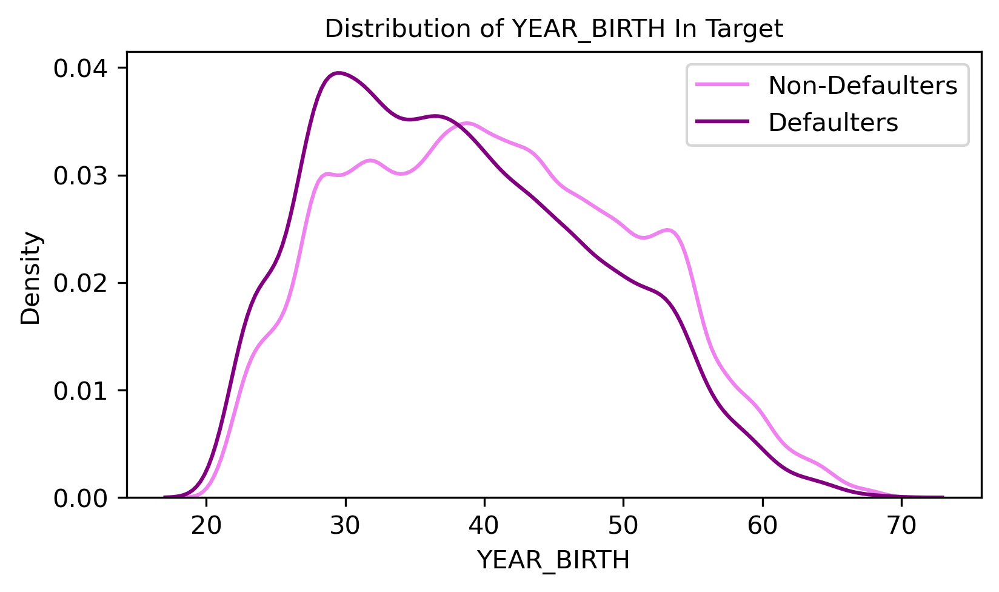

In [135]:
univarcon('YEAR_BIRTH',rot=0,fig_size=[13,5],xt=13)

#People With Age 28 To 38 Take More Loans And There Are More Defaulters With Age Around 28 To 30.

plt.savefig('defaulter_age.svg',transparent=True,bbox_inches='tight')

plt.savefig('default_age.svg',transparent=True,bbox_inches='tight')

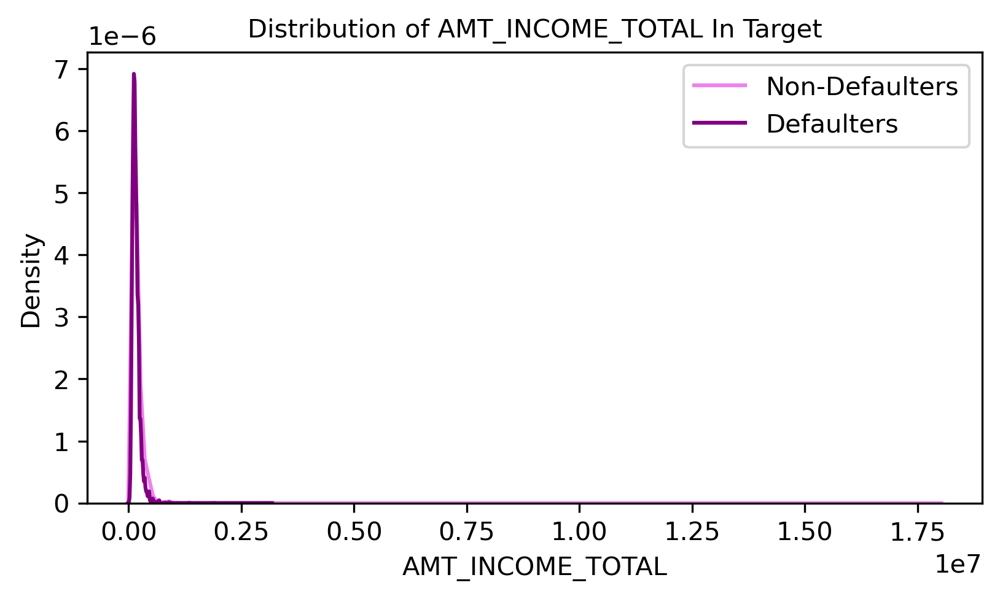

In [136]:
univarcon('AMT_INCOME_TOTAL',rot=0,fig_size=[13,5],xt=13)

#People With Less Total Income Amount Take More Loans.

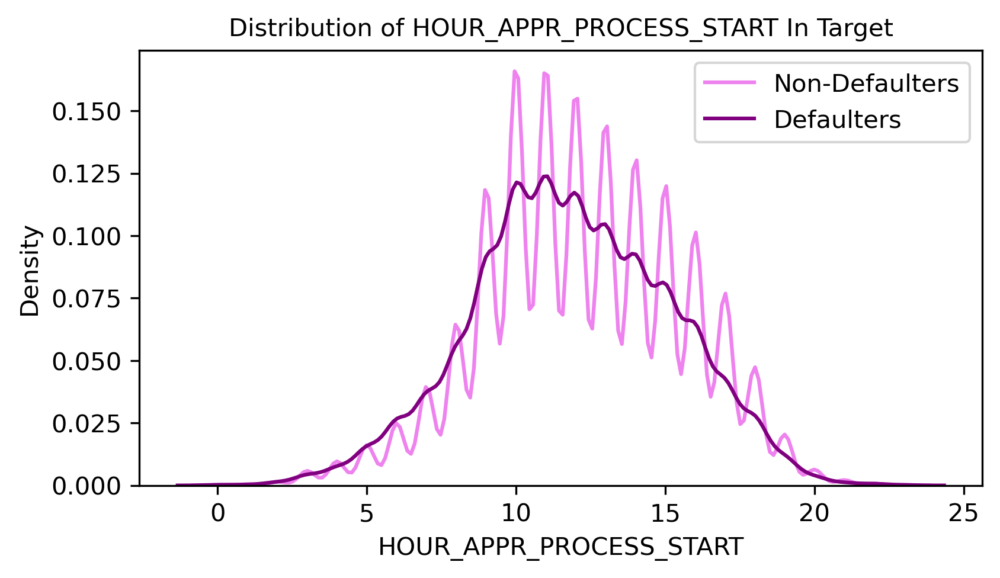

In [137]:
univarcon('HOUR_APPR_PROCESS_START',rot=0,fig_size=[13,5],xt=13)

#Most Loan Applications Were Applied Between 10AM to 1PM.

## Bivariate Analysis Of Numerical Variables.

In [138]:
list(numerical_var) #List Of All Numerical Variables.

['SK_ID_CURR',
 'TARGET',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'F

In [139]:
def bivar(v1,v2,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 10 }
    plt.figure(figsize=fig_size,dpi=300)
    plt.subplot(1,2,1)
    plt.title(f'{v1} V/S {v2} By Target',fontsize=10)
    sns.scatterplot(x=v1,data=df_Target_NOND,y=v2,label='Non-Defaulters',color='violet')
    sns.scatterplot(x=v1,data=df_Target_D,y=v2,label='Defaulters',color='purple')
    plt.tight_layout(); #I Use ';' In Place Of plt.show
    
    # Using Scatter Plot.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size
    # With This Function I Can Manipulate Size,Shape,rotation,ticks,titles,etc Very Easily.

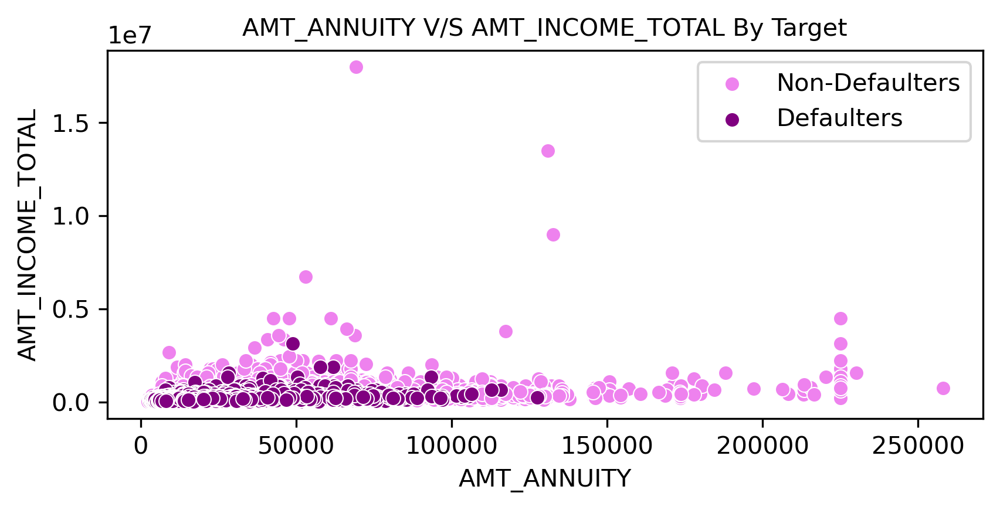

In [140]:
bivar('AMT_ANNUITY','AMT_INCOME_TOTAL',fig_size=[11,3])

# Most Defaulters Has 'Very Less' Total Income Amount And 'Low-Medium' Annuity Amount.
# Non-Defaulters Has 'Medium-Very High' Annuity Amount.
# We Can Also See A Outlier At 11000 and 1.1 As Well.
# We Can Drop That Outlier To Get Better View Of The Plot.

plt.savefig('inc_annu.png',transparent=True,bbox_inches='tight')

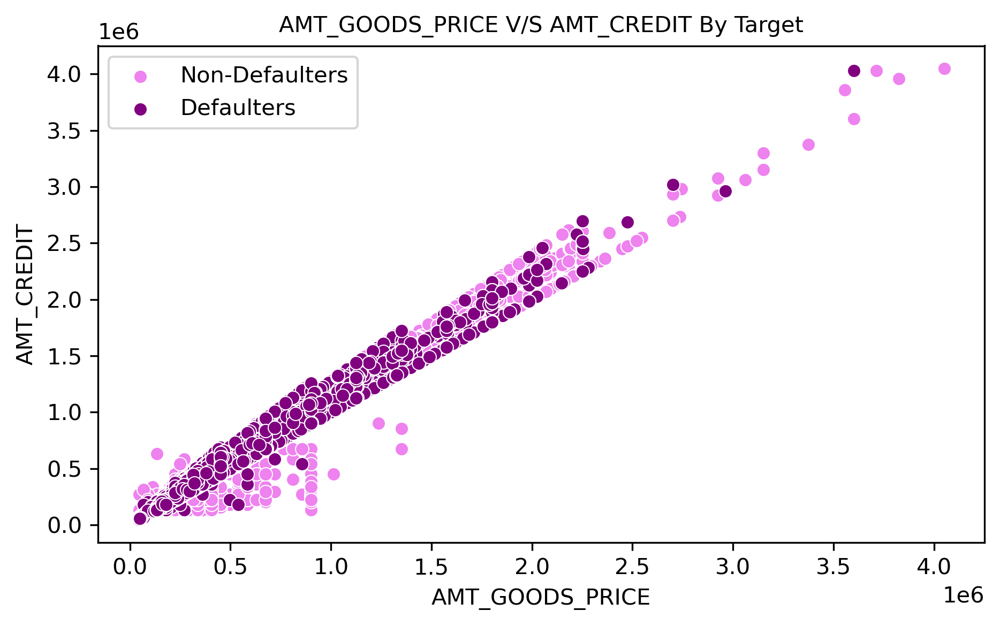

In [141]:
bivar('AMT_GOODS_PRICE','AMT_CREDIT',fig_size=[12,4])

#Credit Amount And Good's Price Amount Is Directly Proportional In Case Of Both Non-Defaulters And Defaulters.
#A Cluster Of People With Less Credit Amount And Slightly Less But Increasing Good's Price Amount Can Also Be Seen In Non-Defaulters.

plt.savefig('bigoopvscred.png',transparent=True,bbox_inches='tight')

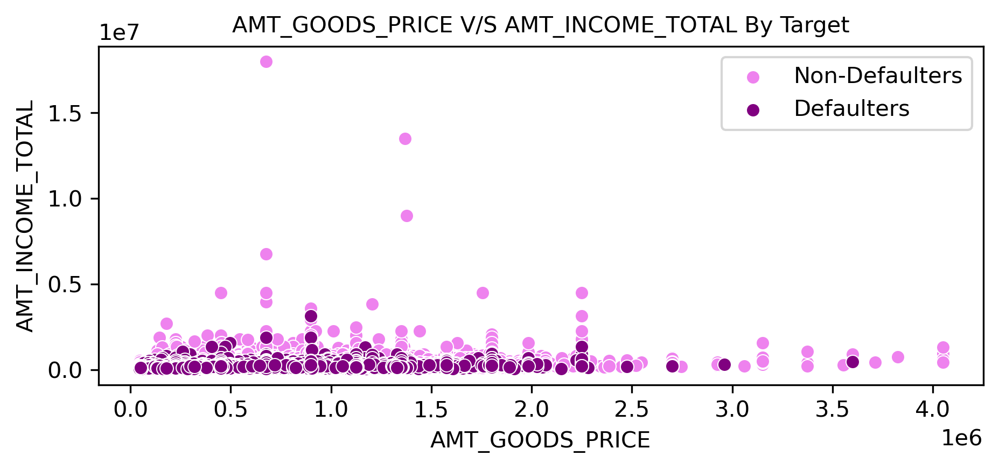

In [142]:
bivar('AMT_GOODS_PRICE','AMT_INCOME_TOTAL',fig_size=[12,3])
# Most Peope Have Amount Good Price From Low-Medium For Defaulters.
# There Was A Outlier At 0.5 and 1.1 in Income Total As Well Thats Why Dropped It In Earlier Steps Of Data Cleaning.

plt.savefig('inc_goods.png',transparent=True,bbox_inches='tight')

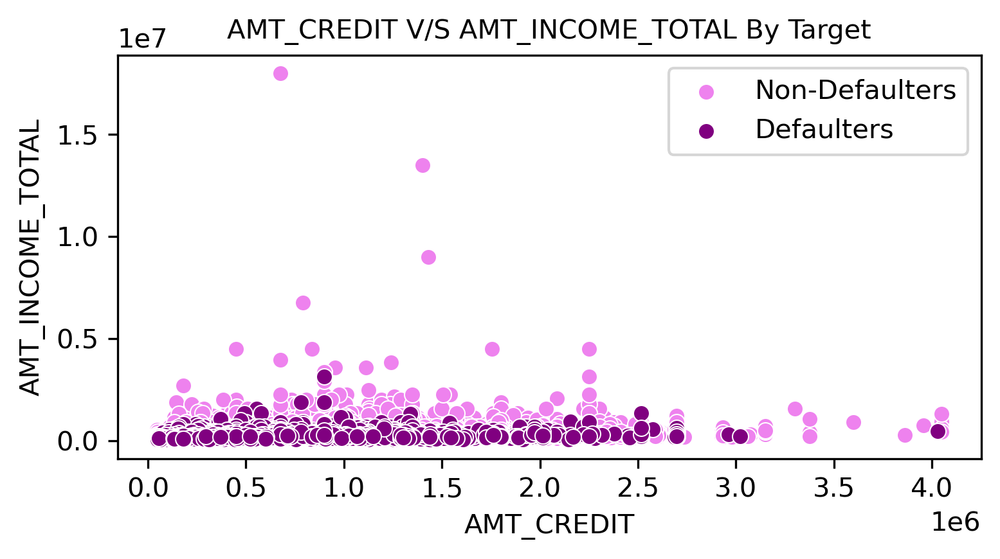

In [143]:
bivar('AMT_CREDIT','AMT_INCOME_TOTAL',fig_size=[10,3])

#Most Defaulters Lie Between Low To Medium Of Credit Amount.

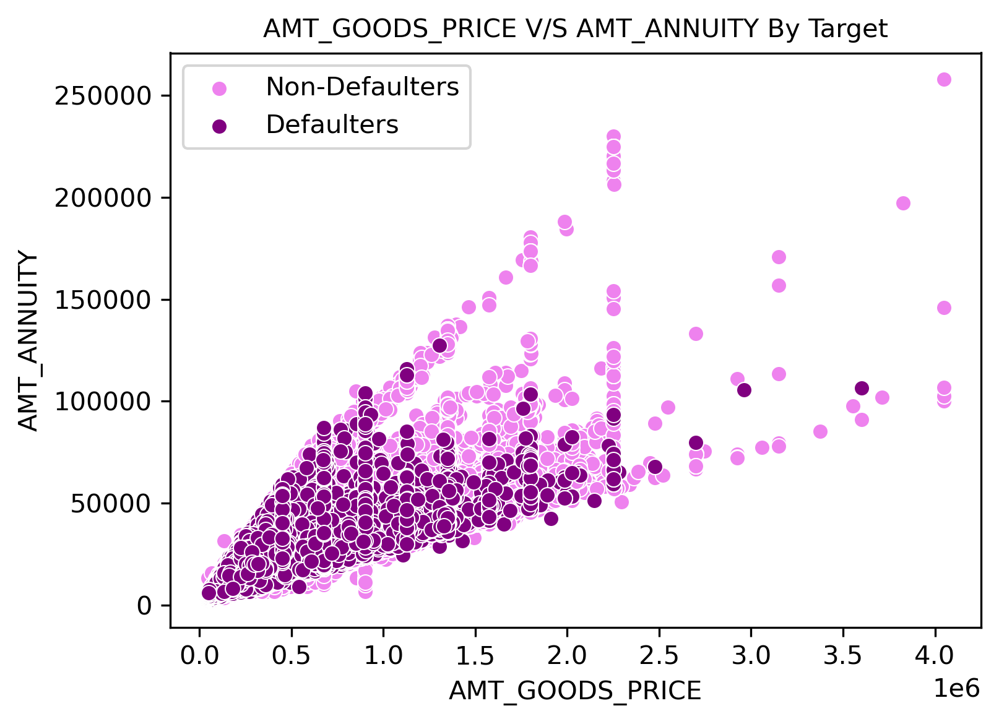

In [144]:
bivar('AMT_GOODS_PRICE','AMT_ANNUITY',fig_size=[10,4])

#Good's Price Amount Is Directly Proportional To Annuity Amount.
#Most Defaulters Lie In Bottom Left Side Of Plot.
#Cluster Of Defaulters Can Be Seen With Low Annuity And Good's Price Amount As Compared To Non-Defaulters.

plt.savefig('good_annu.png',transparent=True,bbox_inches='tight')

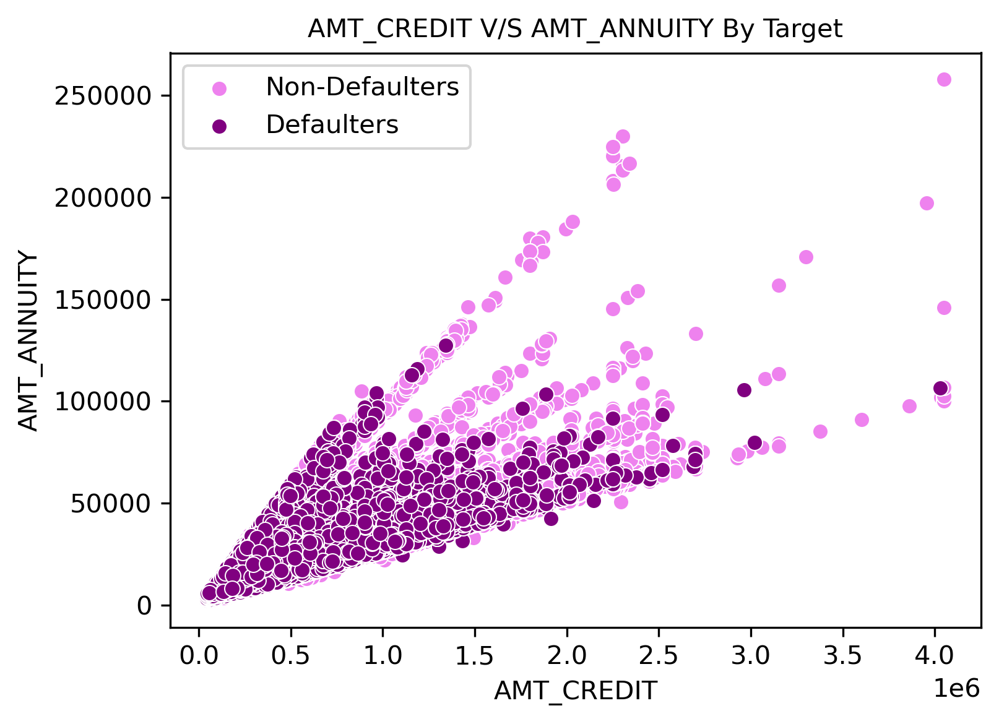

In [145]:
bivar('AMT_CREDIT','AMT_ANNUITY',fig_size=[10,4])

#Credit Amount Is Directly Proportional To Annuity Amount.
#Most Defaulters Lie In Bottom Left Side Of Plot.
#Cluster Of Defaulters Can Be Seen With Low Credit And Annuity Amount As Compared To Non-Defaulters.

plt.savefig('cred_annu.png',transparent=True,bbox_inches='tight')

## Correlation Of Application Dataset With Respect To 'Target' Variable.

In [146]:
list(numerical_var)

['SK_ID_CURR',
 'TARGET',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'F

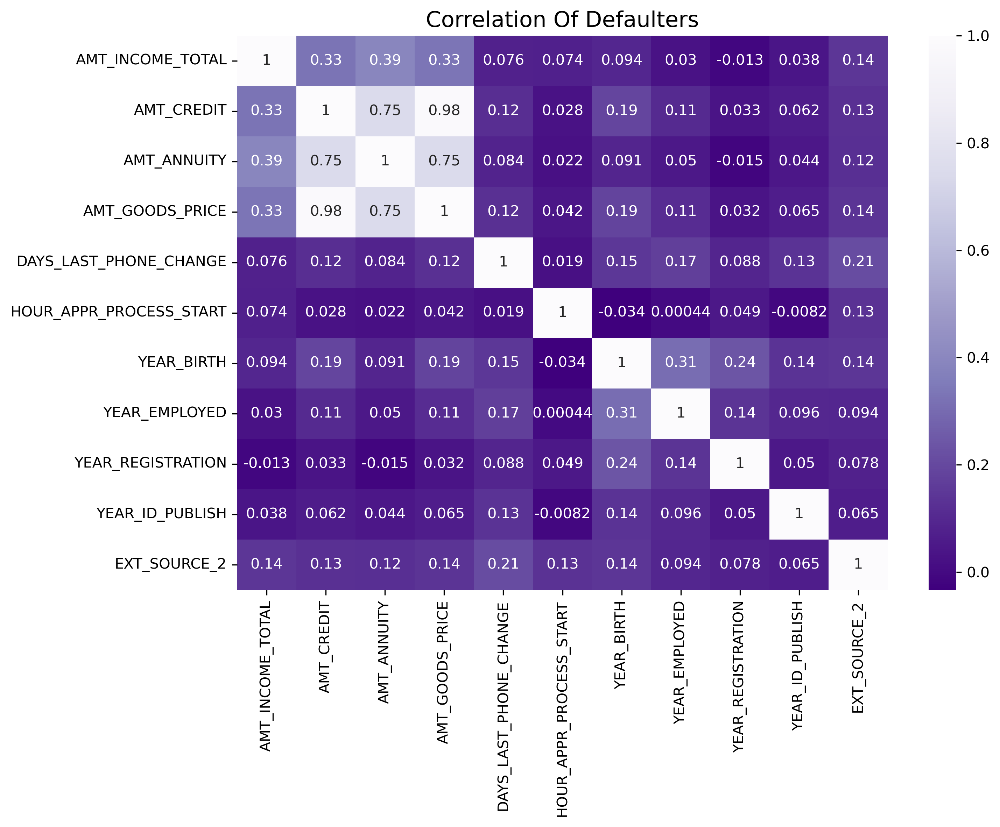

In [147]:
l = ['AMT_INCOME_TOTAL',
                    'AMT_CREDIT',
                    'AMT_ANNUITY',
                    'AMT_GOODS_PRICE',
                    'DAYS_LAST_PHONE_CHANGE',
                    'HOUR_APPR_PROCESS_START',
                    'YEAR_BIRTH',                          #Selected 11 Columns For Correlation.
                    'YEAR_EMPLOYED',
                    'YEAR_REGISTRATION',
                    'YEAR_ID_PUBLISH',
                    'EXT_SOURCE_2']
cor_DNUM = df_Target_D[l].corr()
plt.figure(figsize=[10,7],dpi=300)
plt.title('Correlation Of Defaulters',size=15)
sns.heatmap(data=cor_DNUM,annot=True,cmap='Purples_r');

# It Can Be Seen Clearly That Credit Amount And Good's Price Amount Are Highly Correlated For Defaulters.

plt.savefig('corrdefaulters.svg',transparent=True,bbox_inches='tight')

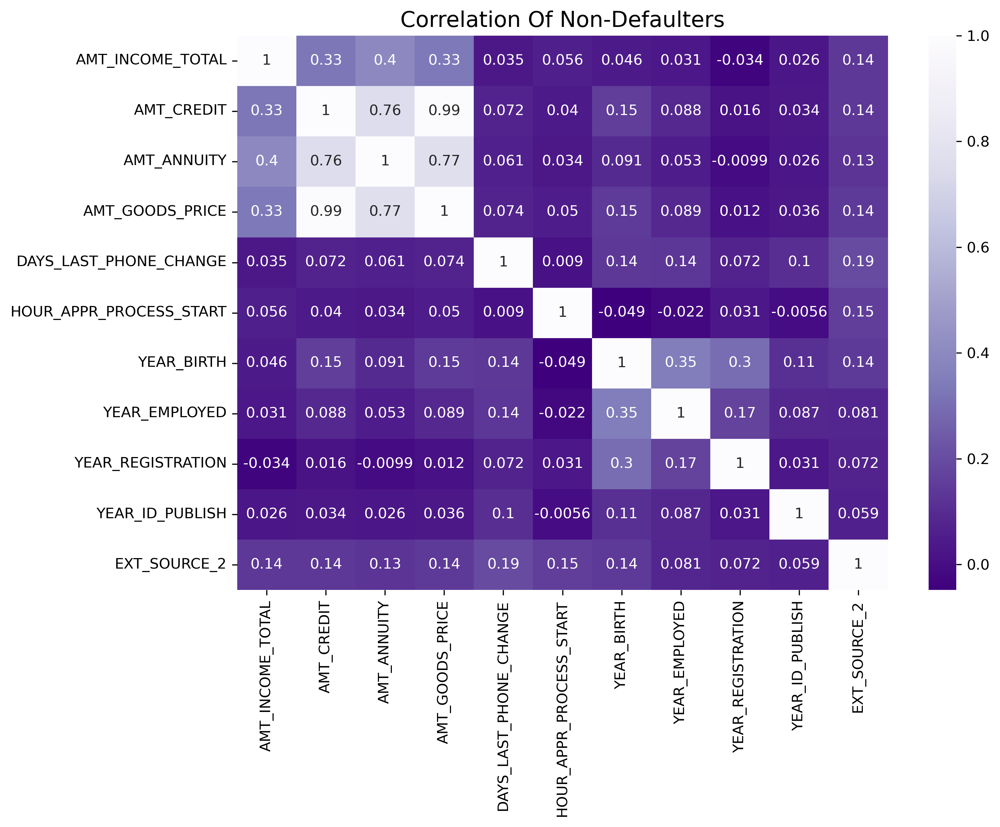

In [148]:
cor_NDNUM = df_Target_NOND[l].corr()
plt.figure(figsize=[10,7],dpi=300)
plt.title('Correlation Of Non-Defaulters',size=15)
sns.heatmap(data=cor_NDNUM,annot=True,cmap='Purples_r');

# It Can Be Seen Clearly That Credit Amount And Good's Price Amount Are Highly Correlated For Non-Defaulters.

plt.savefig('corrnondefaulter.svg',transparent=True,bbox_inches='tight')

### Importing Previous Application dataset.

In [149]:
df_preapp=pd.read_csv('D:\\Upgrad\\EDA Assignment\\previous_application.csv') #Assigned a variable named df_preapp to "Application Data" dataset

## Checking Previous Application Dataset.

In [150]:
df_preapp.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [151]:
df_preapp.shape #Checking Dimensions (Rows:1670214, Columns:37)

(1670214, 37)

In [152]:
df_preapp.info() #Checking Datatypes.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [153]:
df_preapp.describe() #Checking All Numerical Columns.

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [154]:
nu = np.round(df_preapp.isna().sum().sort_values(ascending=False)/len(df_preapp)*100,2)
nu[nu>0] #Taking More Than zero,To Get Columns With All Null Values.

#These Columns Contain Null Values (Descending Order)

RATE_INTEREST_PRIVILEGED     99.64
RATE_INTEREST_PRIMARY        99.64
AMT_DOWN_PAYMENT             53.64
RATE_DOWN_PAYMENT            53.64
NAME_TYPE_SUITE              49.12
NFLAG_INSURED_ON_APPROVAL    40.30
DAYS_TERMINATION             40.30
DAYS_LAST_DUE                40.30
DAYS_LAST_DUE_1ST_VERSION    40.30
DAYS_FIRST_DUE               40.30
DAYS_FIRST_DRAWING           40.30
AMT_GOODS_PRICE              23.08
AMT_ANNUITY                  22.29
CNT_PAYMENT                  22.29
PRODUCT_COMBINATION           0.02
dtype: float64

## Masking And Filtering Columns With Less Than 50% Null Values

In [155]:
df_pre_application = df_preapp.loc[:,(df_preapp.isnull().sum()/len(df_preapp)*100) < 50] #Taking <50 Will Only Keep Columns Having Null Values <50%
print(f'After Excluding Columns With Null Value More Than 50 Percent,Columns Remaining = {df_pre_application.shape[1]} .Earlier It Was 37')

After Excluding Columns With Null Value More Than 50 Percent,Columns Remaining = 33 .Earlier It Was 37


In [156]:
df_pre_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,Y,1,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,Y,1,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,Y,1,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,Y,1,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,Y,1,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [157]:
nul = np.round(df_pre_application.isna().sum().sort_values(ascending=False)/len(df_pre_application)*100,2)
nul[nul>0]

# These Columns Still Contains Null Values (Descending Order)

NAME_TYPE_SUITE              49.12
DAYS_FIRST_DRAWING           40.30
DAYS_TERMINATION             40.30
DAYS_LAST_DUE                40.30
DAYS_LAST_DUE_1ST_VERSION    40.30
DAYS_FIRST_DUE               40.30
NFLAG_INSURED_ON_APPROVAL    40.30
AMT_GOODS_PRICE              23.08
AMT_ANNUITY                  22.29
CNT_PAYMENT                  22.29
PRODUCT_COMBINATION           0.02
dtype: float64

#### Imputing Product Combination Column.
###### We Can Also Impute 'AMT_GOODS_PRICE',  'AMT_ANNUITY',  'CNT_PAYMENT' With Mean Or Median,Depending On The Spread Of The Outliers. For EDA Purpose,Imputing Is Not Required But In Case Of Machine Learning, We Would Had Imputed These Columns.

In [158]:
df_pre_application.PRODUCT_COMBINATION.value_counts() #Categorical Column,Imputing With Mode. i.e 'Cash'.

Cash                              285990
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: PRODUCT_COMBINATION, dtype: int64

In [159]:
df_pre_application.PRODUCT_COMBINATION.fillna('Cash',inplace=True) #Imputed With Mode ('Cash')

In [160]:
df_pre_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,Y,1,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,Y,1,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,Y,1,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,Y,1,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,Y,1,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [161]:
df_pre_application[['DAYS_DECISION','SELLERPLACE_AREA','DAYS_FIRST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_LAST_DUE','DAYS_TERMINATION','DAYS_FIRST_DRAWING']].describe()

#Checking Information About All Numerical Variables In Previous Application Dataframe.

,DAYS_DECISION,SELLERPLACE_AREA,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,DAYS_FIRST_DRAWING
count,1.670214e+06,1.670214e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,-8.806797e+02,3.139511e+02,13826.269337,33767.774054,76582.403064,81992.343838,342209.855039
std,7.790997e+02,7.127443e+03,72444.869708,106857.034789,149647.415123,153303.516729,88916.115834
min,-2.922000e+03,-1.000000e+00,-2892.000000,-2801.000000,-2889.000000,-2874.000000,-2922.000000
25%,-1.300000e+03,-1.000000e+00,-1628.000000,-1242.000000,-1314.000000,-1270.000000,365243.000000
50%,-5.810000e+02,3.000000e+00,-831.000000,-361.000000,-537.000000,-499.000000,365243.000000
75%,-2.800000e+02,8.200000e+01,-411.000000,129.000000,-74.000000,-44.000000,365243.000000
max,-1.000000e+00,4.000000e+06,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000


### Changing All Non-Meaningful Negative Value Column To Absolute Value.

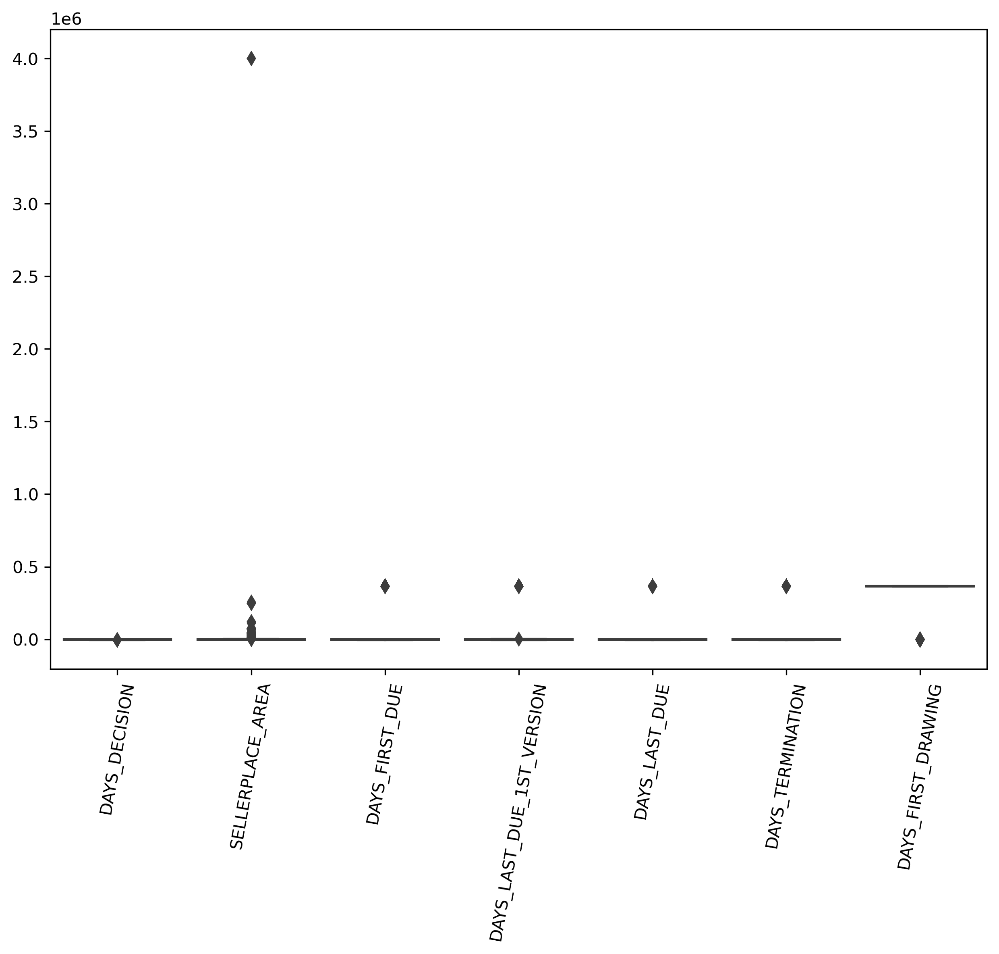

In [162]:
fig_with_dpi()
sns.boxplot(data=df_pre_application[['DAYS_DECISION','SELLERPLACE_AREA','DAYS_FIRST_DUE',
                    'DAYS_LAST_DUE_1ST_VERSION','DAYS_LAST_DUE','DAYS_TERMINATION',
                    'DAYS_FIRST_DRAWING']])
plt.xticks(rotation=80);

# As We Can See These Value Need To Be Changed To Absolute Value.

#### Changing All These Columns To Absolute Value.

In [163]:
df_pre_application[['DAYS_DECISION','SELLERPLACE_AREA','DAYS_FIRST_DUE',
                    'DAYS_LAST_DUE_1ST_VERSION','DAYS_LAST_DUE','DAYS_TERMINATION',
                    'DAYS_FIRST_DRAWING']]=df_pre_application[['DAYS_DECISION','SELLERPLACE_AREA','DAYS_FIRST_DUE',
                                                               'DAYS_LAST_DUE_1ST_VERSION','DAYS_LAST_DUE','DAYS_TERMINATION',
                                                               'DAYS_FIRST_DRAWING']].abs()

In [164]:
df_pre_application.head() #Checking 

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,Y,1,XAP,Approved,73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,42.0,300.0,42.0,37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,Y,1,XNA,Approved,164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,Y,1,XNA,Approved,301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,1,XNA,12.0,high,Cash X-Sell: high,365243.0,271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,Y,1,XNA,Approved,512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,482.0,152.0,182.0,177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,Y,1,Repairs,Refused,781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


## Merging Application Data and Previous Application Data

In [165]:
df_merged = pd.merge(df_application,df_pre_application,how='inner',on='SK_ID_CURR')

# Merging By Inner Join.
# Common Column = 'SK_ID_CURR'
# Assigning New Variable df_merged.

In [166]:
df_merged.head() #Checking

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,NAME_TYPE_SUITE_x,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START_x,HOUR_APPR_PROCESS_START_x,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,OWN_CAR,GENDER,OWN_REALTY,YEAR_BIRTH,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AMT_INCOME_TOTAL_BIN,AMT_CREDIT_BIN,AMT_ANNUITY_BIN,AGE_BIN,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_GOODS_PRICE_y,WEEKDAY_APPR_PROCESS_START_y,HOUR_APPR_PROCESS_START_y,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_y,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,202500,406597.5,24700.5,351000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2,2,2,2,1134,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,Male,1,26,2,10,6,High,Low,Medium,20-30,1038818,Consumer loans,9251.775,179055.0,179055.0,179055.0,SATURDAY,9,Y,1,XAP,Approved,606,XNA,XAP,NaN,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.0,low_normal,POS other with interest,365243.0,565.0,125.0,25.0,17.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1,Very High,Very High,High,40-50,1810518,Cash loans,98356.995,900000.0,1035882.0,900000.0,FRIDAY,12,Y,1,XNA,Approved,746,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,1,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,716.0,386.0,536.0,527.0,1.0
2,100003,0,Cash loans,F,N,N,0,270000,1293502.5,35698.5,1129500,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1,0,1,0,828,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Female,0,46,3,3,1,Very High,Very High,High,40-50,2636178,Consumer loans,64567.665,337500.0,348637.5,

In [167]:
mer = (df_merged.dtypes ==  'object') | (df_merged.dtypes == 'category')
merged_cat = mer[mer].index
list(merged_cat)

#List Of All Categorical Variables Of Merged Dataset.

['NAME_CONTRACT_TYPE_x',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE_x',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START_x',
 'ORGANIZATION_TYPE',
 'EMERGENCYSTATE_MODE',
 'GENDER',
 'AMT_INCOME_TOTAL_BIN',
 'AMT_CREDIT_BIN',
 'AMT_ANNUITY_BIN',
 'AGE_BIN',
 'NAME_CONTRACT_TYPE_y',
 'WEEKDAY_APPR_PROCESS_START_y',
 'FLAG_LAST_APPL_PER_CONTRACT',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CONTRACT_STATUS',
 'NAME_PAYMENT_TYPE',
 'CODE_REJECT_REASON',
 'NAME_TYPE_SUITE_y',
 'NAME_CLIENT_TYPE',
 'NAME_GOODS_CATEGORY',
 'NAME_PORTFOLIO',
 'NAME_PRODUCT_TYPE',
 'CHANNEL_TYPE',
 'NAME_SELLER_INDUSTRY',
 'NAME_YIELD_GROUP',
 'PRODUCT_COMBINATION']

In [168]:
merg = (df_merged.dtypes ==  'int64') | (df_merged.dtypes == 'float64') | (df_merged.dtypes == 'int32')
merged_num = merg[merg].index
list(merged_num)

#List Of All Numerical Variables Of Merged Dataset.

['SK_ID_CURR',
 'TARGET',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT_x',
 'AMT_ANNUITY_x',
 'AMT_GOODS_PRICE_x',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START_x',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT

In [169]:
merged_num.difference(numerical_var) 

# Taking Difference To See All New Numerical Columns From Previous Application.
# Uncommon Numerical Columns Or New Numerical Columns From Merged Data Frame.

Index(['AMT_ANNUITY_x', 'AMT_ANNUITY_y', 'AMT_APPLICATION', 'AMT_CREDIT_x',
       'AMT_CREDIT_y', 'AMT_GOODS_PRICE_x', 'AMT_GOODS_PRICE_y', 'CNT_PAYMENT',
       'DAYS_DECISION', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_TERMINATION',
       'HOUR_APPR_PROCESS_START_x', 'HOUR_APPR_PROCESS_START_y',
       'NFLAG_INSURED_ON_APPROVAL', 'NFLAG_LAST_APPL_IN_DAY',
       'SELLERPLACE_AREA', 'SK_ID_PREV'],
      dtype='object')

In [170]:
merged_cat.difference(categorical_Val)

# Taking Difference To See All New Categorical Columns From Previous Application.
# Uncommon Categorical Columns Or New Categorical Columns From Merged Data Frame.

Index(['AGE_BIN', 'AMT_ANNUITY_BIN', 'AMT_CREDIT_BIN', 'AMT_INCOME_TOTAL_BIN',
       'CHANNEL_TYPE', 'CODE_REJECT_REASON', 'FLAG_LAST_APPL_PER_CONTRACT',
       'NAME_CASH_LOAN_PURPOSE', 'NAME_CLIENT_TYPE', 'NAME_CONTRACT_STATUS',
       'NAME_CONTRACT_TYPE_x', 'NAME_CONTRACT_TYPE_y', 'NAME_GOODS_CATEGORY',
       'NAME_PAYMENT_TYPE', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'NAME_SELLER_INDUSTRY', 'NAME_TYPE_SUITE_x', 'NAME_TYPE_SUITE_y',
       'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'WEEKDAY_APPR_PROCESS_START_x', 'WEEKDAY_APPR_PROCESS_START_y'],
      dtype='object')

In [171]:
df_merged.NAME_CONTRACT_STATUS.value_counts() #Checking

Approved        714182
Canceled        201274
Refused         200852
Unused offer     20791
Name: NAME_CONTRACT_STATUS, dtype: int64

### Checking Duplicates Merged Application

In [172]:
df_merged.duplicated().sum()
print(f'There Are {df_merged.duplicated().sum()} Duplicates In Merged Dataset Because There Were No Duplicates In Application Dataset Too')

There Are 0 Duplicates In Merged Dataset Because There Were No Duplicates In Application Dataset Too


### Checking Unique Values In Merged Dataset Categorical Columns.

In [173]:
# ['AGE_BIN', 'AMT_ANNUITY_BIN', 'AMT_CREDIT_BIN', 'AMT_INCOME_TOTAL_BIN',
#        'CHANNEL_TYPE', 'CODE_REJECT_REASON', 'FLAG_LAST_APPL_PER_CONTRACT',
#        'NAME_CASH_LOAN_PURPOSE', 'NAME_CLIENT_TYPE', 'NAME_CONTRACT_STATUS',
#        'NAME_CONTRACT_TYPE_x', 'NAME_CONTRACT_TYPE_y', 'NAME_GOODS_CATEGORY',
#        'NAME_PAYMENT_TYPE', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',              'Just Collection Of All Categorical Variables'
#        'NAME_SELLER_INDUSTRY', 'NAME_TYPE_SUITE_x', 'NAME_TYPE_SUITE_y',
#        'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
#        'WEEKDAY_APPR_PROCESS_START_x', 'WEEKDAY_APPR_PROCESS_START_y']

### Finding Number Of Unique Values In Categorical Columns.

In [174]:
df_merged[['AGE_BIN', 'AMT_ANNUITY_BIN', 'AMT_CREDIT_BIN', 'AMT_INCOME_TOTAL_BIN',
       'CHANNEL_TYPE', 'CODE_REJECT_REASON', 'FLAG_LAST_APPL_PER_CONTRACT',
       'NAME_CASH_LOAN_PURPOSE', 'NAME_CLIENT_TYPE', 'NAME_CONTRACT_STATUS',
       'NAME_CONTRACT_TYPE_x', 'NAME_CONTRACT_TYPE_y', 'NAME_GOODS_CATEGORY',
       'NAME_PAYMENT_TYPE', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'NAME_SELLER_INDUSTRY', 'NAME_TYPE_SUITE_x', 'NAME_TYPE_SUITE_y',
       'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'WEEKDAY_APPR_PROCESS_START_x', 'WEEKDAY_APPR_PROCESS_START_y']].nunique()

AGE_BIN                          5
AMT_ANNUITY_BIN                  5
AMT_CREDIT_BIN                   5
AMT_INCOME_TOTAL_BIN             5
CHANNEL_TYPE                     8
CODE_REJECT_REASON               9
FLAG_LAST_APPL_PER_CONTRACT      2
NAME_CASH_LOAN_PURPOSE          25
NAME_CLIENT_TYPE                 4
NAME_CONTRACT_STATUS             4
NAME_CONTRACT_TYPE_x             2
NAME_CONTRACT_TYPE_y             4
NAME_GOODS_CATEGORY             27
NAME_PAYMENT_TYPE                4
NAME_PORTFOLIO                   5
NAME_PRODUCT_TYPE                3
NAME_SELLER_INDUSTRY            11
NAME_TYPE_SUITE_x                7
NAME_TYPE_SUITE_y                7
NAME_YIELD_GROUP                 5
PRODUCT_COMBINATION             17
WEEKDAY_APPR_PROCESS_START_x     7
WEEKDAY_APPR_PROCESS_START_y     7
dtype: int64

#### Checking 'Names' Of All Unique Values In Categorical Columns Of Merged Dataframe.

In [175]:
print(f'Unique Values In "AGE_BIN" -> {df_merged.AGE_BIN.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_ANNUITY_BIN" -> {df_merged.AMT_ANNUITY_BIN.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_CREDIT_BIN" -> {df_merged.AMT_CREDIT_BIN.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_INCOME_TOTAL_BIN" -> {df_merged.AMT_INCOME_TOTAL_BIN.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "CHANNEL_TYPE" -> {df_merged.CHANNEL_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "CODE_REJECT_REASON" -> {df_merged.CODE_REJECT_REASON.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "FLAG_LAST_APPL_PER_CONTRACT" -> {df_merged.FLAG_LAST_APPL_PER_CONTRACT.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CASH_LOAN_PURPOSE" -> {df_merged.NAME_CASH_LOAN_PURPOSE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CLIENT_TYPE" -> {df_merged.NAME_CLIENT_TYPE.unique()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AGE_BIN" -> {df_merged.AGE_BIN.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_STATUS" -> {df_merged.NAME_CONTRACT_STATUS.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_TYPE_x" -> {df_merged.NAME_CONTRACT_TYPE_x.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_TYPE_y" -> {df_merged.NAME_CONTRACT_TYPE_y.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_GOODS_CATEGORY" -> {df_merged.NAME_GOODS_CATEGORY.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PAYMENT_TYPE" -> {df_merged.NAME_PAYMENT_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PORTFOLIO" -> {df_merged.NAME_PORTFOLIO.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PRODUCT_TYPE" -> {df_merged.NAME_PRODUCT_TYPE.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_SELLER_INDUSTRY" -> {df_merged.NAME_SELLER_INDUSTRY.unique()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_TYPE_SUITE_x" -> {df_merged.NAME_TYPE_SUITE_x.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_TYPE_SUITE_y" -> {df_merged.NAME_TYPE_SUITE_y.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_YIELD_GROUP" -> {df_merged.NAME_YIELD_GROUP.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "PRODUCT_COMBINATION" -> {df_merged.PRODUCT_COMBINATION.unique()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "WEEKDAY_APPR_PROCESS_START_x" -> {df_merged.WEEKDAY_APPR_PROCESS_START_x.unique()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "WEEKDAY_APPR_PROCESS_START_y" -> {df_merged.WEEKDAY_APPR_PROCESS_START_y.unique()}')

Unique Values In "AGE_BIN" -> ['20-30', '40-50', '50-60', '30-40', '60-70']
Categories (5, object): ['20-30' < '30-40' < '40-50' < '50-60' < '60-70']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_ANNUITY_BIN" -> ['Medium', 'High', 'Very Low', 'Low', 'Very High', NaN]
Categories (5, object): ['Very Low' < 'Low' < 'Medium' < 'High' < 'Very High']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_CREDIT_BIN" -> ['Low', 'Very High', 'Very Low', 'Medium', 'High', NaN]
Categories (5, object): ['Very Low' < 'Low' < 'Medium' < 'High' < 'Very High']

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_INCOME_TOTAL_BIN" -> ['High', 'Very High', 'Very Low', 'Low', 'Medium', NaN]
Categories (5, object): ['Very Low' < 'Low' < 'Medium' < 'High' < 'Very High']

----------X----------X-

### Value Count In Categorical Columns Of Merged Dataset.

In [176]:
print(f'Unique Values In "AGE_BIN" ->\n {df_merged.AGE_BIN.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_ANNUITY_BIN" ->\n {df_merged.AMT_ANNUITY_BIN.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_CREDIT_BIN" ->\n {df_merged.AMT_CREDIT_BIN.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AMT_INCOME_TOTAL_BIN" ->\n {df_merged.AMT_INCOME_TOTAL_BIN.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "CHANNEL_TYPE" ->\n {df_merged.CHANNEL_TYPE.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "CODE_REJECT_REASON" ->\n {df_merged.CODE_REJECT_REASON.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "FLAG_LAST_APPL_PER_CONTRACT" ->\n {df_merged.FLAG_LAST_APPL_PER_CONTRACT.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CASH_LOAN_PURPOSE" ->\n {df_merged.NAME_CASH_LOAN_PURPOSE.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CLIENT_TYPE" ->\n {df_merged.NAME_CLIENT_TYPE.value_counts()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "AGE_BIN" ->\n {df_merged.AGE_BIN.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_STATUS" ->\n {df_merged.NAME_CONTRACT_STATUS.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_TYPE_x" ->\n {df_merged.NAME_CONTRACT_TYPE_x.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_CONTRACT_TYPE_y" ->\n {df_merged.NAME_CONTRACT_TYPE_y.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_GOODS_CATEGORY" ->\n {df_merged.NAME_GOODS_CATEGORY.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PAYMENT_TYPE" ->\n {df_merged.NAME_PAYMENT_TYPE.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PORTFOLIO" ->\n {df_merged.NAME_PORTFOLIO.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_PRODUCT_TYPE" ->\n {df_merged.NAME_PRODUCT_TYPE.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_SELLER_INDUSTRY" ->\n {df_merged.NAME_SELLER_INDUSTRY.value_counts()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_TYPE_SUITE_x" ->\n {df_merged.NAME_TYPE_SUITE_x.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_TYPE_SUITE_y" ->\n {df_merged.NAME_TYPE_SUITE_y.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "NAME_YIELD_GROUP" ->\n {df_merged.NAME_YIELD_GROUP.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "PRODUCT_COMBINATION" ->\n {df_merged.PRODUCT_COMBINATION.value_counts()}\n')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "WEEKDAY_APPR_PROCESS_START_x" ->\n {df_merged.WEEKDAY_APPR_PROCESS_START_x.value_counts()}')
print('----------X----------X----------X----------X----------X----------X----------X----------X----------\n')
print(f'Unique Values In "WEEKDAY_APPR_PROCESS_START_y" ->\n {df_merged.WEEKDAY_APPR_PROCESS_START_y.value_counts()}')

Unique Values In "AGE_BIN" ->
 30-40    370067
40-50    344235
50-60    198023
20-30    196381
60-70     28393
Name: AGE_BIN, dtype: int64

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_ANNUITY_BIN" ->
 Low          234644
Medium       233352
High         233338
Very High    222416
Very Low     213340
Name: AMT_ANNUITY_BIN, dtype: int64

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_CREDIT_BIN" ->
 Low          267638
High         226821
Very Low     224110
Very High    216127
Medium       201466
Name: AMT_CREDIT_BIN, dtype: int64

----------X----------X----------X----------X----------X----------X----------X----------X----------

Unique Values In "AMT_INCOME_TOTAL_BIN" ->
 Very Low     293761
Medium       264846
Very High    207858
High         192457
Low          178176
Name: AMT_INCOME_TOTAL_BIN, dtype: int64

----------X----------X--

## Bivariate Analysis Of Categorical Variables

#### Creating Function For Bivariate Analysis Of Categorical Variables In Merged Dataframe

In [177]:
def bivarmerg(a,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 15 }
    plt.figure(figsize=fig_size,dpi=300)
    plt.title(f'Distribution of {a} By NAME_CONTRACT_STATUS',fontsize=title_size)
    aa=sns.countplot(data=df_merged,x=a,palette='rocket',hue='NAME_CONTRACT_STATUS',order = df_merged[a].value_counts().index) #x = a 
    plt.xlabel(xlabel=a,fontdict= fon) # Plot 1 For Non-Defaulter
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count',size=xt)
    plt.bar_label(aa.containers[0],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[1],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[2],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[3],rotation=barot,label_type=labe);
    
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size
    # Using This Function I Can Manipulate Size,title,rotation,ticks,etc of the bivariate plot.

#### In This Analysis,I Will Be Using 'Contract Status' As Target Variable In Merged Dataset.
#### As It Will Be Easy To Analyze In Terms Of [ 'Approved','Canceled','Refused','Unused Offer' ]

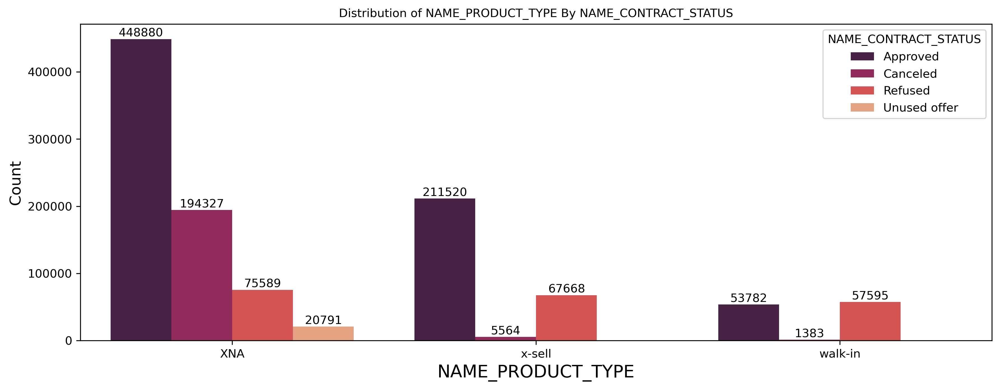

In [178]:
bivarmerg('NAME_PRODUCT_TYPE',rot=0,fig_size=[14,5],fsize=10,xt=13)

#Highest Number Of 'Approved' Status Is From XNA('Unknown') Product Category.

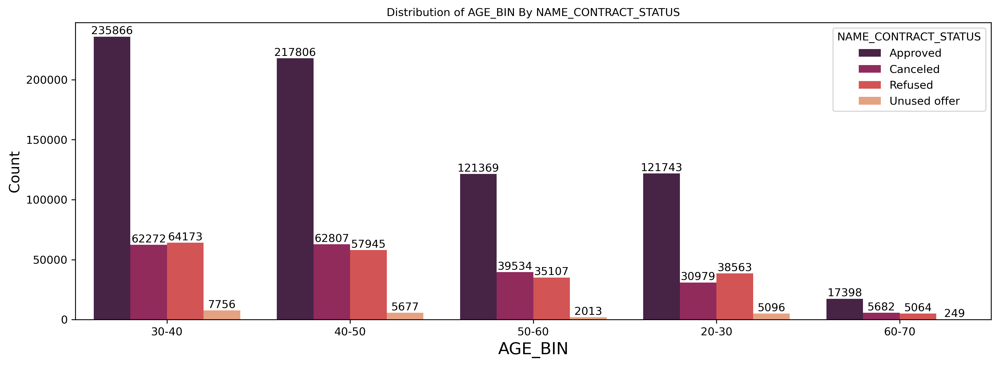

In [179]:
bivarmerg('AGE_BIN',rot=0,fig_size=[15,5],fsize=10,xt=13)

# Age With '30-40' Segment Got Highest 'Approval' Rate.
# Second Is Age Category '40-50'

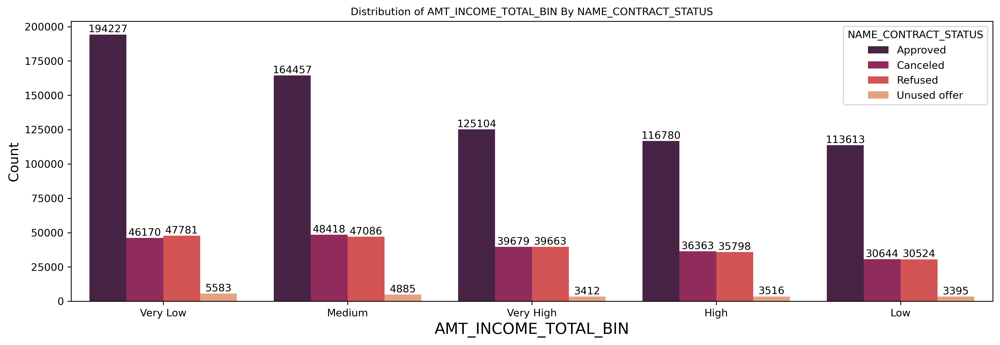

In [180]:
bivarmerg('AMT_INCOME_TOTAL_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13)

# People With Income Total Amount 'Very Low' Got Highest Number Of Approvals.

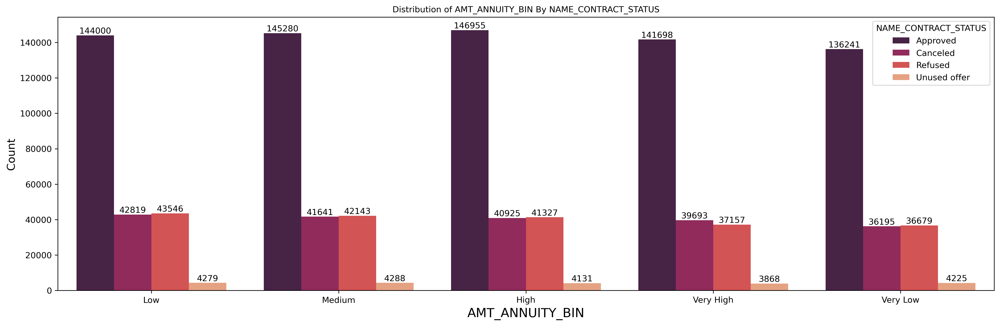

In [181]:
bivarmerg('AMT_ANNUITY_BIN',rot=0,fig_size=[20,6],fsize=10,xt=13) 

#People With Annuity Amount 'High','Medium','Low' Got Highest Approvals.

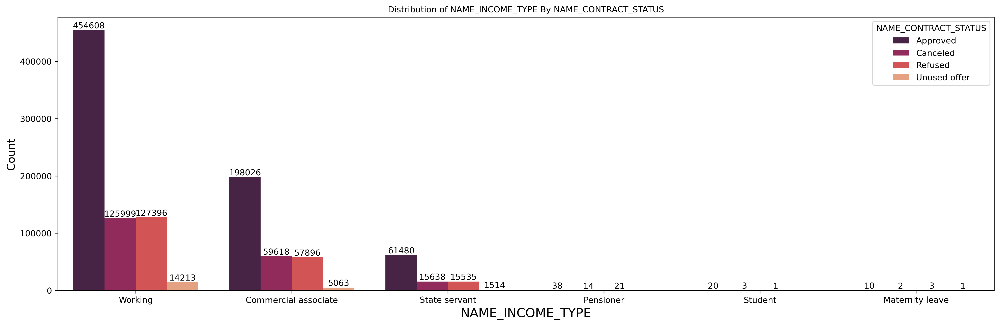

In [182]:
bivarmerg('NAME_INCOME_TYPE',rot=0,fig_size=[20,6],fsize=10,xt=13) 

#People With Income Type Working Got Highest Approvals.

plt.savefig('name_incom_bi.svg',transparent=True,bbox_inches='tight')

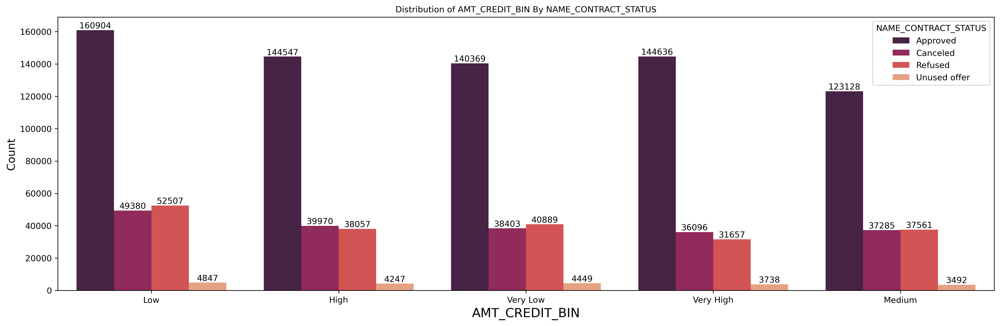

In [183]:
bivarmerg('AMT_CREDIT_BIN',rot=0,fig_size=[20,6],fsize=10,xt=13)

# People With 'Low' Credit Amount Got Highest Approval.
# Last Approval Number Is Made By 'Medium'.

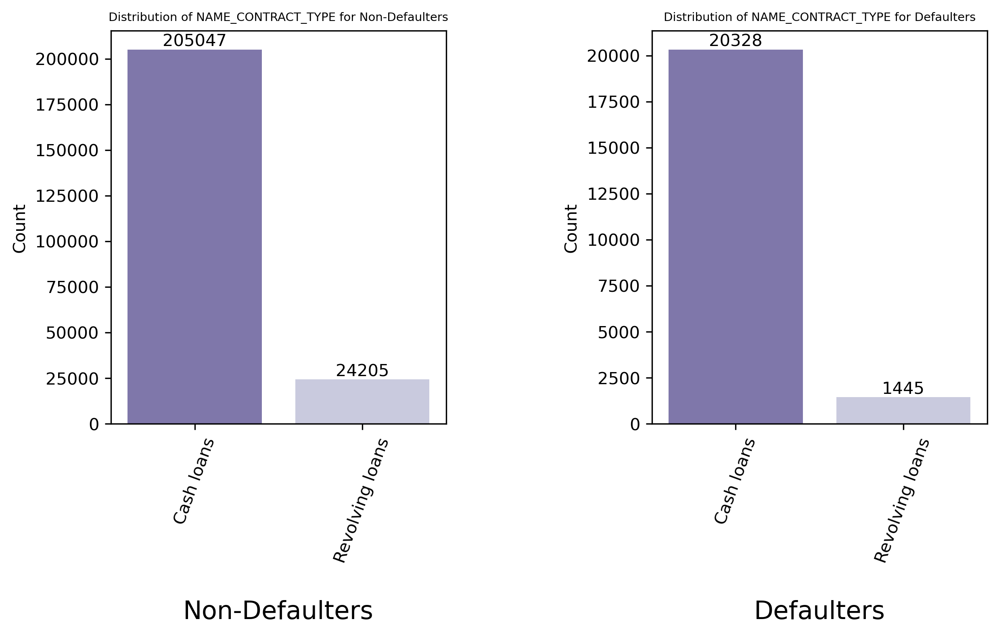

In [184]:
univar('NAME_CONTRACT_TYPE',rot=70,title_size=7,fig_size=[10,7])

#There Are Less Defaulters From Revolving Loans.

plt.savefig('namecontract.svg',transparent=True,bbox_inches='tight')

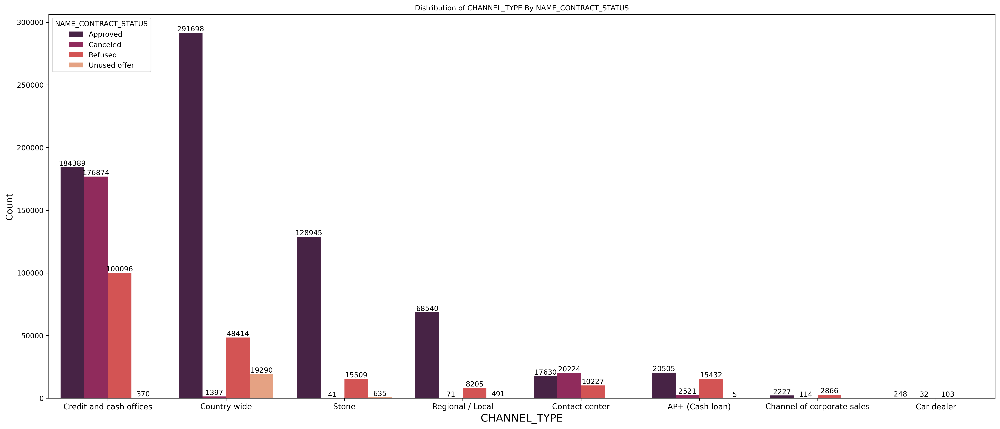

In [185]:
bivarmerg('CHANNEL_TYPE',rot=0,fig_size=[24,10],fsize=11,xt=13)

#CHANNEL_TYPE = Through which channel we acquired the client on the previous application.

# People With 'Country-Wide' Channel Got Highest Approvals.
# Whereas 'Car Dealer' Channel Got The Least Approvals.
# But People 'Credit And Cash Offices' Got Highest Number Of Cancelations.

plt.savefig('channel.svg',transparent=True,bbox_inches='tight')

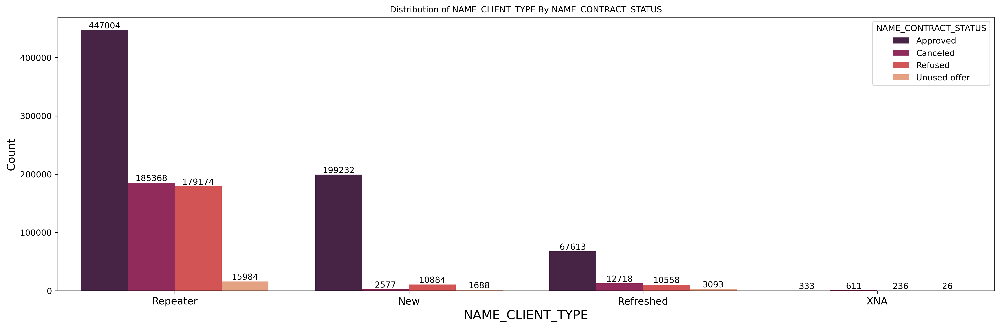

In [186]:
bivarmerg('NAME_CLIENT_TYPE',rot=0,fig_size=[20,6],fsize=12,xt=13)

# People With 'Repeater' Client Got Highest Approvals.
# Whereas Rate Of Cancelation For 'New' Client Is Very Less.

plt.savefig('repeaterapp.svg',transparent=True,bbox_inches='tight')

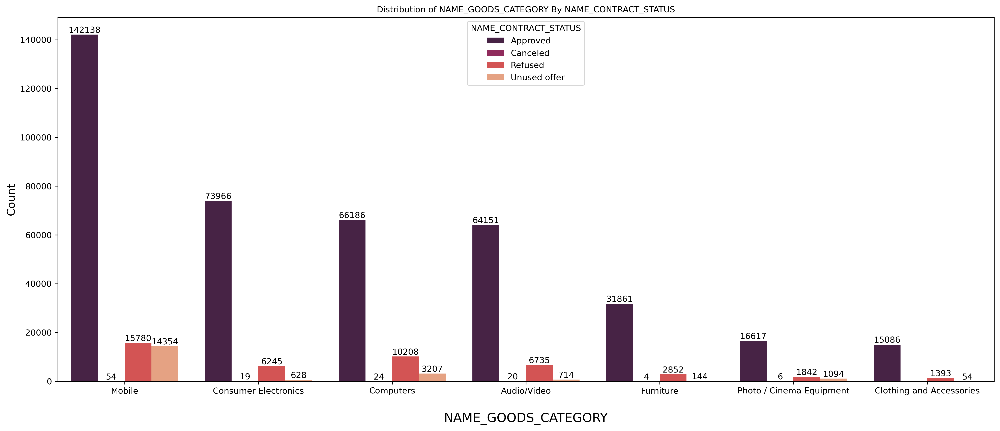

In [187]:
fon = { 'weight': 'normal',
        'size': 15 }
plt.figure(figsize=[20,8],dpi=300)
#     plt.subplot(1,2,1)
plt.title(f'Distribution of NAME_GOODS_CATEGORY By NAME_CONTRACT_STATUS',fontsize=10)
aa=sns.countplot(data=df_merged,x=df_merged.NAME_GOODS_CATEGORY,palette='rocket',hue='NAME_CONTRACT_STATUS',
                order = df_merged['NAME_GOODS_CATEGORY'].value_counts()[1:8].index) #x = a 
plt.xlabel(xlabel='\nNAME_GOODS_CATEGORY',fontdict= fon) # Plot 1 For Non-Defaulter
plt.ylabel('Count',size=13)
plt.xticks(rotation=0,size=10)
plt.bar_label(aa.containers[0],rotation=0,label_type='edge')
plt.bar_label(aa.containers[1],rotation=0,label_type='edge')
plt.bar_label(aa.containers[2],rotation=0,label_type='edge')
plt.bar_label(aa.containers[3],rotation=0,label_type='edge');

#There Were Many Categories,That's Why Had To Take Top 7 Categories.

# NAME_GOODS_CATEGORY = What kind of goods did the client apply for in the previous application.
# People Who Applied Loan For 'Mobile' Got Highest Approvals.

plt.savefig('mobile.svg',transparent=True,bbox_inches='tight')

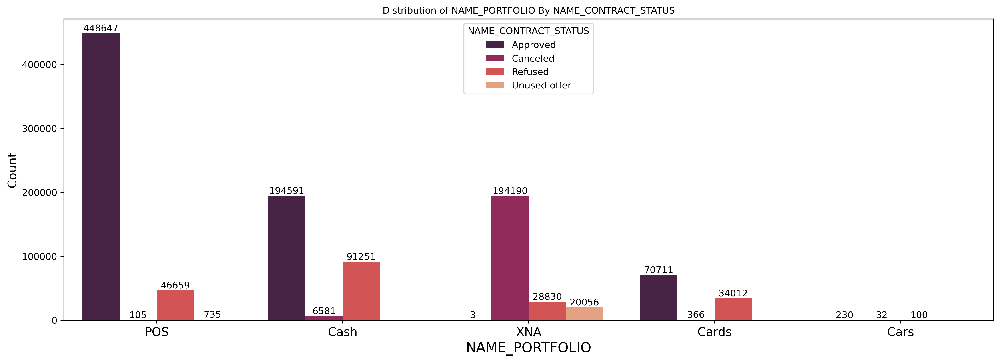

In [188]:
bivarmerg('NAME_PORTFOLIO',rot=0,fig_size=[18,6],fsize=13,xt=13)

# People With 'POS' Got Highest Approvals And Less Cancelations In Previous Application.

plt.savefig('posvsnamecon.svg',transparent=True,bbox_inches='tight')

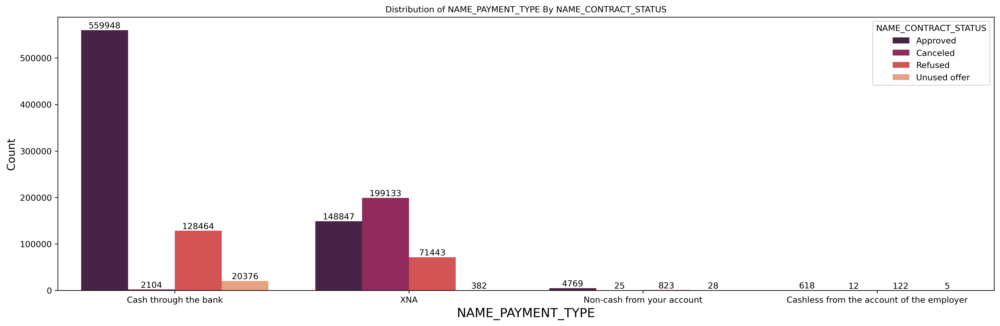

In [189]:
bivarmerg('NAME_PAYMENT_TYPE',rot=0,fig_size=[20,6],fsize=10,xt=13)

# People Who Opted Payment Method 'Cash Through The Bank' Got Highest Approvals.

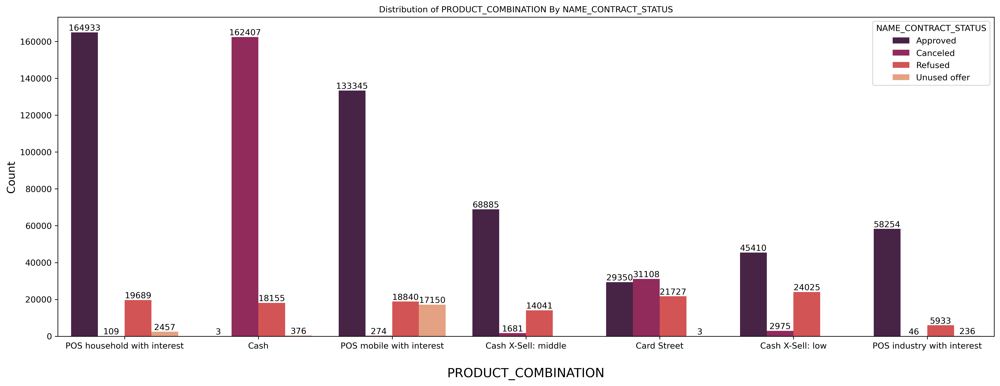

In [190]:
fon = { 'weight': 'normal',
        'size': 15 }
plt.figure(figsize=[20,7],dpi=300)
plt.title(f'Distribution of PRODUCT_COMBINATION By NAME_CONTRACT_STATUS',fontsize=10)
aa=sns.countplot(data=df_merged,x=df_merged.PRODUCT_COMBINATION,palette='rocket',hue='NAME_CONTRACT_STATUS',
                order = df_merged['PRODUCT_COMBINATION'].value_counts()[0:7].index) #x = a 
plt.xlabel(xlabel='\nPRODUCT_COMBINATION',fontdict= fon)
plt.ylabel('Count',size=13)
plt.xticks(rotation=0,size=10)
plt.bar_label(aa.containers[0],rotation=0,label_type='edge')
plt.bar_label(aa.containers[1],rotation=0,label_type='edge')
plt.bar_label(aa.containers[2],rotation=0,label_type='edge')
plt.bar_label(aa.containers[3],rotation=0,label_type='edge');

#There Were Many Categories,That's Why Had To Take Top 7 Categories.

#People With 'Pos Household With Interest' Product Combination Got 'Highest' Approvals.
#Whereas People With 'Cash' Product Combination Got 'Highest' Cancelations.

plt.savefig('name_convsproduc.svg',transparent=True,bbox_inches='tight')

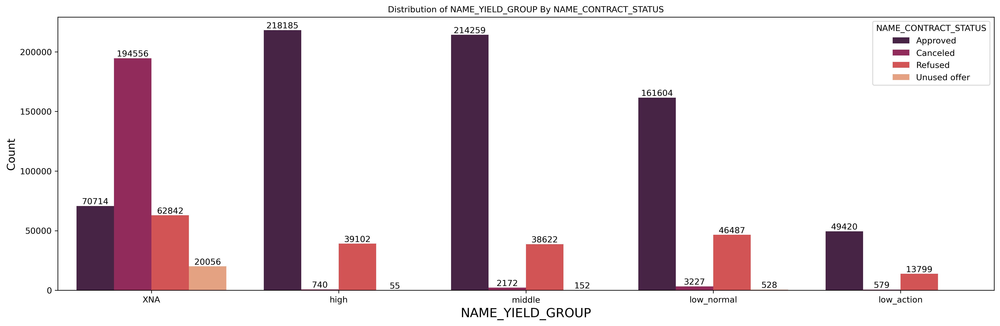

In [191]:
bivarmerg('NAME_YIELD_GROUP',rot=0,fig_size=[20,6],fsize=10,xt=13)

# NAME_YIELD_GROUP = Grouped interest rate into small medium and high of the previous application.

#People Whose Yield Is 'Unknown' Got 'Highest' Cancelations.
#People Whose Yield Is 'High','Middle' Got 'Highest' Approvals.

plt.savefig('yield.svg',transparent=True,bbox_inches='tight')

### Univariate Analysis Of Numerical Variable

In [192]:
merged_num.difference(numerical_var) 

# Uncommon Numerical Columns Or New Numerical Columns From Merged Data Frame.

Index(['AMT_ANNUITY_x', 'AMT_ANNUITY_y', 'AMT_APPLICATION', 'AMT_CREDIT_x',
       'AMT_CREDIT_y', 'AMT_GOODS_PRICE_x', 'AMT_GOODS_PRICE_y', 'CNT_PAYMENT',
       'DAYS_DECISION', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_TERMINATION',
       'HOUR_APPR_PROCESS_START_x', 'HOUR_APPR_PROCESS_START_y',
       'NFLAG_INSURED_ON_APPROVAL', 'NFLAG_LAST_APPL_IN_DAY',
       'SELLERPLACE_AREA', 'SK_ID_PREV'],
      dtype='object')

In [193]:
df_merged.AMT_ANNUITY_x #Checking

0          24700.5
1          35698.5
2          35698.5
3          35698.5
4           6750.0
            ...   
1137094    49117.5
1137095    49117.5
1137096    49117.5
1137097    49117.5
1137098    49117.5
Name: AMT_ANNUITY_x, Length: 1137099, dtype: float64

### Before Analysis Checking For Datatypes Of All New Numerical Variables In Merged Dataframe.

In [194]:
df_merged[['AMT_ANNUITY_x', 'AMT_ANNUITY_y', 'AMT_APPLICATION', 'AMT_CREDIT_x',
       'AMT_CREDIT_y', 'AMT_GOODS_PRICE_x', 'AMT_GOODS_PRICE_y', 'CNT_PAYMENT',
       'DAYS_DECISION', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_TERMINATION',
       'HOUR_APPR_PROCESS_START_x', 'HOUR_APPR_PROCESS_START_y',
       'NFLAG_INSURED_ON_APPROVAL', 'NFLAG_LAST_APPL_IN_DAY',
       'SELLERPLACE_AREA', 'SK_ID_PREV']]

,AMT_ANNUITY_x,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_x,AMT_CREDIT_y,AMT_GOODS_PRICE_x,AMT_GOODS_PRICE_y,CNT_PAYMENT,DAYS_DECISION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_TERMINATION,HOUR_APPR_PROCESS_START_x,HOUR_APPR_PROCESS_START_y,NFLAG_INSURED_ON_APPROVAL,NFLAG_LAST_APPL_IN_DAY,SELLERPLACE_AREA,SK_ID_PREV
0,24700.5,9251.775,179055.0,406597.5,179055.0,351000,179055.0,24.0,606,365243.0,565.0,25.0,125.0,17.0,10,9,0.0,1,500,1038818
1,35698.5,98356.995,900000.0,1293502.5,1035882.0,1129500,900000.0,12.0,746,365243.0,716.0,536.0,386.0,527.0,11,12,1.0,1,1,1810518
2,35698.5,64567.665,337500.0,1293502.5,348637.5,1129500,337500.0,6.0,828,365243.0,797.0,647.0,647.0,639.0,11,17,0.0,1,1400,2636178
3,35698.5,6737.310,68809.5,1293502.5,68053.5,1129500,68809.5,12.0,2341,365243.0,2310.0,1980.0,1980.0,1976.0,11,15,1.0,1,200,2396755
4,6750.0,5357.250,24282.0,135000.0,20106.0,135000,24282.0,4.0,815,365243.0,784.0,724.0,694.0,714.0,9,5,0.0,1,30,1564014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1137094,49117.5,16400.610,229500.0,675000.0,254340.0,675000,229500.0,24.0,648,365243.0,618.0,558.0,72.0,528.0,20,12,1.0,1,1,2073384
1137095,49117.5,2250.000,45000.0,675000.0,45000.0,675000,45000.0,0.0,456,NaN,NaN,NaN,NaN,NaN,20,14,NaN,1,20,1708056
1137096,49117.5,30737.655,765000.0,675000.0,1067940.0,675000,765000.0,60.0,171,NaN,NaN,NaN,NaN,NaN,20,14,NaN,1,1,1296007
1137097,49117.5,54022.140,1170000.0,675000.0,1271929.5,675000,1170000.0,36.0,787,365243.0,756.0,66.0,294.0,64.0,20,14,0.0,1,6,2631384


In [195]:
df_merged[['CNT_PAYMENT','DAYS_DECISION','DAYS_FIRST_DRAWING','DAYS_FIRST_DUE',
'DAYS_LAST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_TERMINATION','HOUR_APPR_PROCESS_START_y',
  'NFLAG_INSURED_ON_APPROVAL','NFLAG_LAST_APPL_IN_DAY','SELLERPLACE_AREA','SK_ID_PREV']]

#These Datatypes Are In Float And Should Be In Integer Datatype.

,CNT_PAYMENT,DAYS_DECISION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_TERMINATION,HOUR_APPR_PROCESS_START_y,NFLAG_INSURED_ON_APPROVAL,NFLAG_LAST_APPL_IN_DAY,SELLERPLACE_AREA,SK_ID_PREV
0,24.0,606,365243.0,565.0,25.0,125.0,17.0,9,0.0,1,500,1038818
1,12.0,746,365243.0,716.0,536.0,386.0,527.0,12,1.0,1,1,1810518
2,6.0,828,365243.0,797.0,647.0,647.0,639.0,17,0.0,1,1400,2636178
3,12.0,2341,365243.0,2310.0,1980.0,1980.0,1976.0,15,1.0,1,200,2396755
4,4.0,815,365243.0,784.0,724.0,694.0,714.0,5,0.0,1,30,1564014
...,...,...,...,...,...,...,...,...,...,...,...,...
1137094,24.0,648,365243.0,618.0,558.0,72.0,528.0,12,1.0,1,1,2073384
1137095,0.0,456,NaN,NaN,NaN,NaN,NaN,14,NaN,1,20,1708056
1137096,60.0,171,NaN,NaN,NaN,NaN,NaN,14,NaN,1,1,1296007
1137097,36.0,787,365243.0,756.0,66.0,294.0,64.0,14,0.0,1,6,2631384


In [196]:
df_merged[['CNT_PAYMENT','DAYS_DECISION','DAYS_FIRST_DRAWING','DAYS_FIRST_DUE',
'DAYS_LAST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_TERMINATION','HOUR_APPR_PROCESS_START_y',
  'NFLAG_INSURED_ON_APPROVAL','NFLAG_LAST_APPL_IN_DAY','SELLERPLACE_AREA','SK_ID_PREV']]=df_merged[['CNT_PAYMENT','DAYS_DECISION','DAYS_FIRST_DRAWING','DAYS_FIRST_DUE',
'DAYS_LAST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_TERMINATION','HOUR_APPR_PROCESS_START_y',
  'NFLAG_INSURED_ON_APPROVAL','NFLAG_LAST_APPL_IN_DAY','SELLERPLACE_AREA','SK_ID_PREV']].astype('Int64')

#Used Astype('Int64') So That I Don't Get Any Error If Null Values Are Present.

In [197]:
df_merged[['CNT_PAYMENT','DAYS_DECISION','DAYS_FIRST_DRAWING','DAYS_FIRST_DUE',
'DAYS_LAST_DUE','DAYS_LAST_DUE_1ST_VERSION','DAYS_TERMINATION','HOUR_APPR_PROCESS_START_y',
  'NFLAG_INSURED_ON_APPROVAL','NFLAG_LAST_APPL_IN_DAY','SELLERPLACE_AREA','SK_ID_PREV']] 

# Checking If Columns Are Changed To 'Int64' Or Not.

,CNT_PAYMENT,DAYS_DECISION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_TERMINATION,HOUR_APPR_PROCESS_START_y,NFLAG_INSURED_ON_APPROVAL,NFLAG_LAST_APPL_IN_DAY,SELLERPLACE_AREA,SK_ID_PREV
0,24,606,365243,565,25,125,17,9,0,1,500,1038818
1,12,746,365243,716,536,386,527,12,1,1,1,1810518
2,6,828,365243,797,647,647,639,17,0,1,1400,2636178
3,12,2341,365243,2310,1980,1980,1976,15,1,1,200,2396755
4,4,815,365243,784,724,694,714,5,0,1,30,1564014
...,...,...,...,...,...,...,...,...,...,...,...,...
1137094,24,648,365243,618,558,72,528,12,1,1,1,2073384
1137095,0,456,<NA>,<NA>,<NA>,<NA>,<NA>,14,<NA>,1,20,1708056
1137096,60,171,<NA>,<NA>,<NA>,<NA>,<NA>,14,<NA>,1,1,1296007
1137097,36,787,365243,756,66,294,64,14,0,1,6,2631384


In [198]:
df_merged['YEAR_DECISION'] = np.round(df_merged.DAYS_DECISION/365,2) #Converting Days To Year And Assigning New Variable.

#### Creating Function For Univariate Analysis Of Numerical Columns

In [199]:
app=df_merged[df_merged.NAME_CONTRACT_STATUS == 'Approved']
can=df_merged[df_merged.NAME_CONTRACT_STATUS == 'Canceled']        #Categorized 4 Different Dataframe By Contract Status.
ref=df_merged[df_merged.NAME_CONTRACT_STATUS == 'Refused']
uno=df_merged[df_merged.NAME_CONTRACT_STATUS == 'Unused offer']

In [200]:
def UnivarNum(a,b,figsiz=[20,8],tfsize=13):   #Using distplot Without histogram For This.
    fon = { 'weight': 'normal',
            'size': 15 }
    plt.figure(figsize=figsiz,dpi=300)
    plt.subplot(1,2,1)
    plt.title(f'Distribution Of NAME_CONTRACT_STATUS in {a}\n',fontsize=tfsize)
    sns.distplot(app[a],label='Approved',hist=False) #for approved
    sns.distplot(can[a],label='Canceled',hist=False)  #for Canceled
    sns.distplot(ref[a],label='Refused',hist=False)  #for Refused
    sns.distplot(uno[a],label='Unused offer',hist=False)  #for Unused Offer
    plt.xlabel(xlabel=f'\n{a} (Current)',fontdict= fon)
    plt.ylabel('Density',size=13)
    plt.xticks(rotation=0,size=10)
    plt.legend()
    plt.subplot(1,2,2)
    plt.title(f'Distribution Of NAME_CONTRACT_STATUS in {b}\n',fontsize=tfsize)
    sns.distplot(app[b],label='Approved',hist=False) #for approved
    sns.distplot(can[b],label='Canceled',hist=False) #for Canceled
    sns.distplot(ref[b],label='Refused',hist=False)  #for Refused
    sns.distplot(uno[b],label='Unused offer',hist=False)  #for Unused Offer
    plt.xlabel(xlabel=f'\n{b} (Previous)',fontdict= fon)
    plt.ylabel('Density',size=13)
    plt.xticks(rotation=0,size=10)
    plt.legend()
    plt.tight_layout(pad=7)
    
    # Here I Made A Function Especially To Compare 'x' and 'y' Variables Side By Side.
    # Can Use Kde plot Too.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size.

In [201]:
merged_num.difference(numerical_var)  #Uncommon Numerical Variables From Previous DataSet.

Index(['AMT_ANNUITY_x', 'AMT_ANNUITY_y', 'AMT_APPLICATION', 'AMT_CREDIT_x',
       'AMT_CREDIT_y', 'AMT_GOODS_PRICE_x', 'AMT_GOODS_PRICE_y', 'CNT_PAYMENT',
       'DAYS_DECISION', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_TERMINATION',
       'HOUR_APPR_PROCESS_START_x', 'HOUR_APPR_PROCESS_START_y',
       'NFLAG_INSURED_ON_APPROVAL', 'NFLAG_LAST_APPL_IN_DAY',
       'SELLERPLACE_AREA', 'SK_ID_PREV'],
      dtype='object')

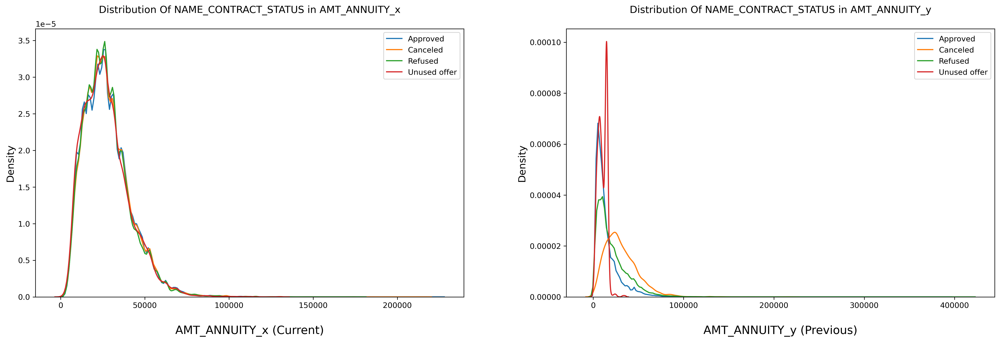

In [202]:
UnivarNum('AMT_ANNUITY_x','AMT_ANNUITY_y')

#People With AMT_ANNUITY_y (Previous) 200 to 300,Got Highest 'Unused Offer' As Compared To AMT_ANNUITY_x (Current).
#People With Annuity Amount Between 25000 to 30000 Applied For More Loans.

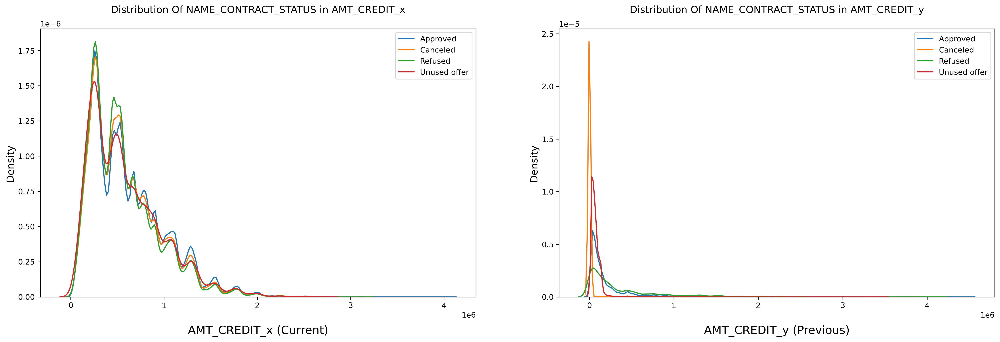

In [203]:
UnivarNum('AMT_CREDIT_x','AMT_CREDIT_y')

# People With 'Less' Credit Amount Applied For More Loans.
#In Previous Credit Amount,Most Loan Got Canceled For People With 'Very Low' Credit Amount As Compared To Current Credit Amount.

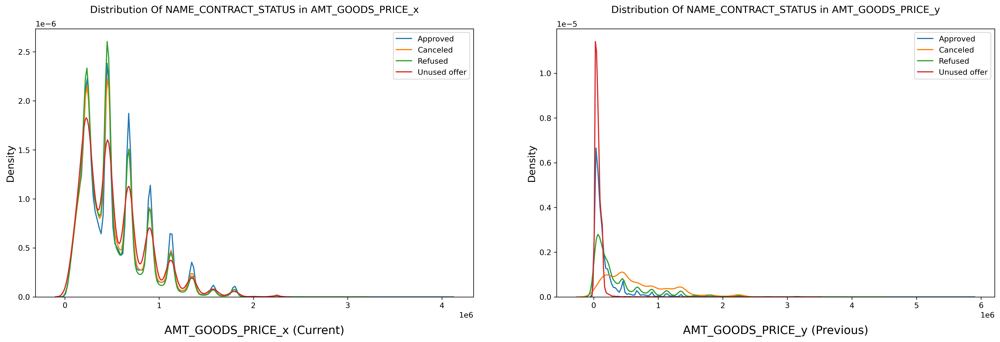

In [204]:
UnivarNum('AMT_GOODS_PRICE_x','AMT_GOODS_PRICE_y')

#In Previous Good's Price,Most 'Offeres Were Unused' With 'Very Low' Good's Price As Compared To Current Good's Price.
# Most Of The Loans Were Taken For Low Good's Price.

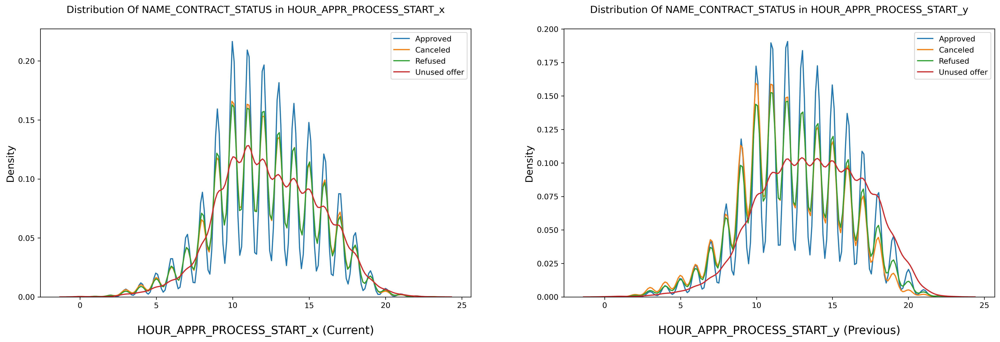

In [205]:
UnivarNum('HOUR_APPR_PROCESS_START_x','HOUR_APPR_PROCESS_START_y')

#Most Loans Are Applied Between 10AM To 2PM, 10AM To 2PM Could Also Be Busiest Hours In Both Current And Previous.

In [206]:
def UnivarNumsin(a,figsiz=[12,5],tfsize=13):
    fon = { 'weight': 'normal',
            'size': 15 }
    plt.figure(figsize=figsiz,dpi=300)
    plt.title(f'Distribution Of NAME_CONTRACT_STATUS in {a}\n',fontsize=tfsize)
    sns.distplot(app[a],label='Approved',hist=False)
    sns.distplot(can[a],label='Canceled',hist=False)          #Separate Function For Univariate Analysis Of Only One Column.
    sns.distplot(ref[a],label='Refused',hist=False)           #As Comparision Of  All Current And Previous Are Finished Now.
    sns.distplot(uno[a],label='Unused offer',hist=False)
    plt.xlabel(xlabel=a,fontdict= fon)
    plt.ylabel('Density',size=13)
    plt.xticks(rotation=0,size=10)
    plt.legend()
    
    #figsiz=figure size,tfsize=title font size

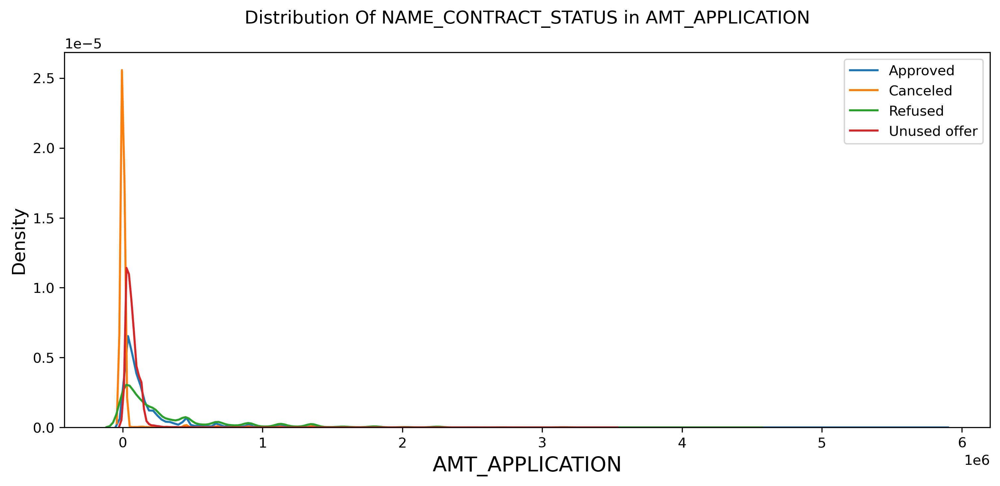

In [207]:
UnivarNumsin('AMT_APPLICATION')

#People With 'Very Low' Application Amount,Were Mostly 'Canceled'.

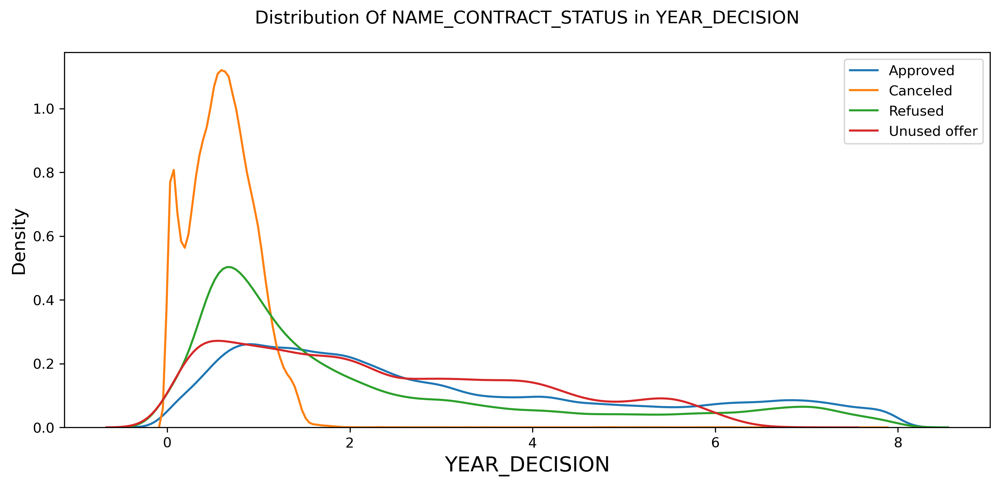

In [208]:
UnivarNumsin('YEAR_DECISION')

#DAYS_DECISION = Relative to current application when was the decision about previous application made.

#People Who Made Their Decision Between 6 Months To 1.5 Years Got Their Application Canceled.

plt.savefig('yeardicide.svg',transparent=True,bbox_inches='tight')

## Correlation 

In [209]:
list(merged_num.difference(numerical_var)) #Checking All New Columns In Merged Dataset (Previous Application)

['AMT_ANNUITY_x',
 'AMT_ANNUITY_y',
 'AMT_APPLICATION',
 'AMT_CREDIT_x',
 'AMT_CREDIT_y',
 'AMT_GOODS_PRICE_x',
 'AMT_GOODS_PRICE_y',
 'CNT_PAYMENT',
 'DAYS_DECISION',
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_TERMINATION',
 'HOUR_APPR_PROCESS_START_x',
 'HOUR_APPR_PROCESS_START_y',
 'NFLAG_INSURED_ON_APPROVAL',
 'NFLAG_LAST_APPL_IN_DAY',
 'SELLERPLACE_AREA',
 'SK_ID_PREV']

In [210]:
corrr = df_pre_application[['AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'CNT_PAYMENT',
 'DAYS_DECISION',                  #Assigning Variable 'corrr' To Correlation Of Selected Columns.
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_TERMINATION',
 'HOUR_APPR_PROCESS_START',
 'SELLERPLACE_AREA']].corr()

In [211]:
corrr

,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,CNT_PAYMENT,DAYS_DECISION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_TERMINATION,HOUR_APPR_PROCESS_START,SELLERPLACE_AREA
AMT_ANNUITY,1.000000,0.808872,0.816429,0.820895,0.394535,-0.279051,0.052608,-0.059027,0.080280,-0.073375,0.065780,-0.036201,-0.014978
AMT_APPLICATION,0.808872,1.000000,0.975824,0.999884,0.680630,-0.133660,0.074145,-0.055209,0.170500,-0.089943,0.146623,-0.014415,-0.007619
AMT_CREDIT,0.816429,0.975824,1.000000,0.993087,0.674278,-0.133763,-0.037060,-0.002888,0.222601,0.038805,0.212177,-0.021039,-0.009534
AMT_GOODS_PRICE,0.820895,0.999884,0.993087,1.000000,0.672129,-0.290422,-0.024452,-0.027262,0.209450,0.010172,0.207092,-0.045267,-0.015788
CNT_PAYMENT,0.394535,0.680630,0.674278,0.672129,1.000000,-0.246453,0.309900,-0.209351,0.087042,-0.386446,0.053454,-0.055511,-0.010602
DAYS_DECISION,-0.279051,-0.133660,-0.133763,-0.290422,-0.246453,1.000000,0.013510,-0.155793,-0.441149,-0.076110,-0.393206,0.039962,0.018328
DAYS_FIRST_DRAWING,0.052608,0.074145,-0.037060,-0.024452,0.309900,0.013510,1.000000,0.005124,-0.258234,-0.803504,-0.396110,0.014340,0.007396
DAYS_FIRST_DUE,-0.059027,-0.055209,-0.002888,-0.027262,-0.209351,-0.155793,0.005124,1.000000,0.393431,0.512906,0.315712,-0.002717,-0.002048
DAYS_LAST_DUE,0.080280,0.170500,0.222601,0.209450,0.087042,-0.441149,-0.258234,0.393431,1.000000,0.418371,0.927777,-0.017980,-0.006254
DAYS_LAST_DUE_1ST_VERSION,-0.073375,-0.089943,0.038805,0.010172,-0.386446,-0.076110,-0.803504,0.512906,0.418371,1.000000,0.487760,-0.016352,-0.007430


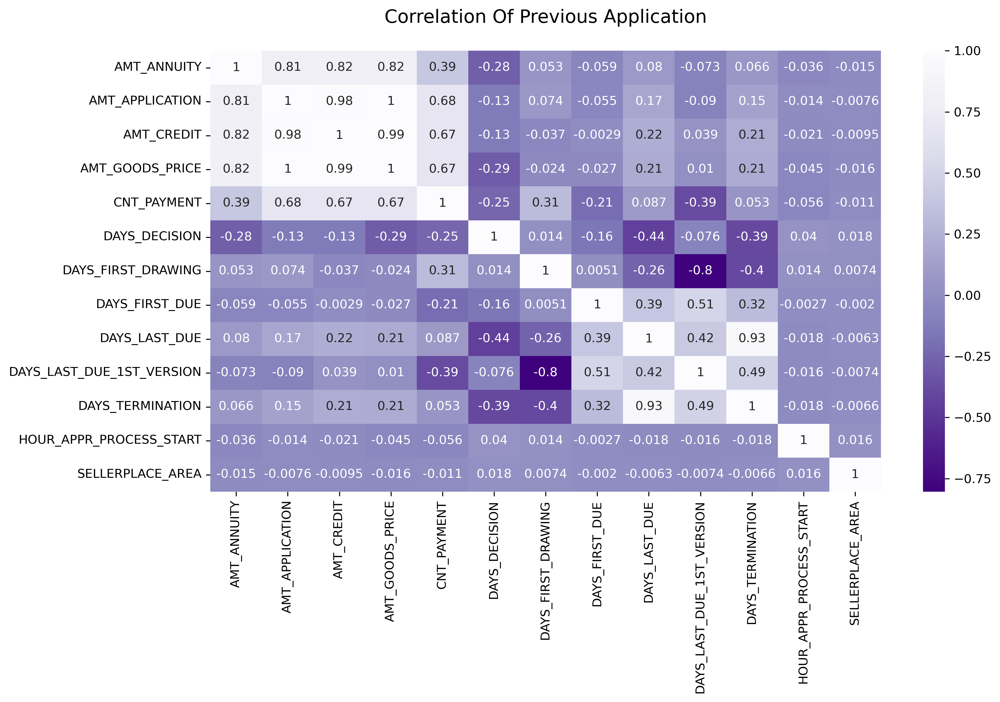

In [212]:
plt.figure(figsize=[12,8],dpi=300)
plt.title('Correlation Of Previous Application\n',size=15)
sns.heatmap(data=corrr,annot=True,cmap='Purples_r')
plt.tight_layout();

#Annuity Amount Column Is Little Correlated With Application Amount,Credit Amount,Good's Price Amount.
#Application Amount Is Correlated With Credit Amount,Good's Price Amount,And little Correlated To Annuity Amount.
#Credit Amount Is Correlated With Application Amount,Good's Price Amount,And Little Correlated To Annuity Amount.
#Good's Price Amount Is Correlated With Application Amount,Credit Amount,And Little Correlated To Annuity Amount.
#Days Last Due Is Correlated To Days Termination.

plt.savefig('preappcorr.svg',transparent=True,bbox_inches='tight')

## Bivariate Analysis Of Categorical Variable

In [213]:
list(merged_cat.difference(categorical_Val))  #List Of All New Categorical Columns From Merged DataFrame (Previous Application)

['AGE_BIN',
 'AMT_ANNUITY_BIN',
 'AMT_CREDIT_BIN',
 'AMT_INCOME_TOTAL_BIN',
 'CHANNEL_TYPE',
 'CODE_REJECT_REASON',
 'FLAG_LAST_APPL_PER_CONTRACT',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CLIENT_TYPE',
 'NAME_CONTRACT_STATUS',
 'NAME_CONTRACT_TYPE_x',
 'NAME_CONTRACT_TYPE_y',
 'NAME_GOODS_CATEGORY',
 'NAME_PAYMENT_TYPE',
 'NAME_PORTFOLIO',
 'NAME_PRODUCT_TYPE',
 'NAME_SELLER_INDUSTRY',
 'NAME_TYPE_SUITE_x',
 'NAME_TYPE_SUITE_y',
 'NAME_YIELD_GROUP',
 'PRODUCT_COMBINATION',
 'WEEKDAY_APPR_PROCESS_START_x',
 'WEEKDAY_APPR_PROCESS_START_y']

#### Function For Bivariate Analysis Of Categorical Variable

In [214]:
def bivarmergcat(a,b,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 15 }
    plt.figure(figsize=fig_size,dpi=300)
#     plt.subplot(1,2,1)
    plt.title(f'{a}     v/s     {b}\n',fontsize=title_size)
    aa=sns.countplot(data=df_merged,x=a,palette='rocket',hue=b,order = df_merged[a].value_counts().head(7).index) #x = a 
    plt.xlabel(xlabel=f'\n{a}',fontdict= fon)
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count\n',size=xt)
    plt.bar_label(aa.containers[0],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[1],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[2],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[3],rotation=barot,label_type=labe)
    plt.tight_layout();
    
    # Using Countplot.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size.
    # This Function Can Manipulate plot size,ticks,title,rotation,labels,etc.

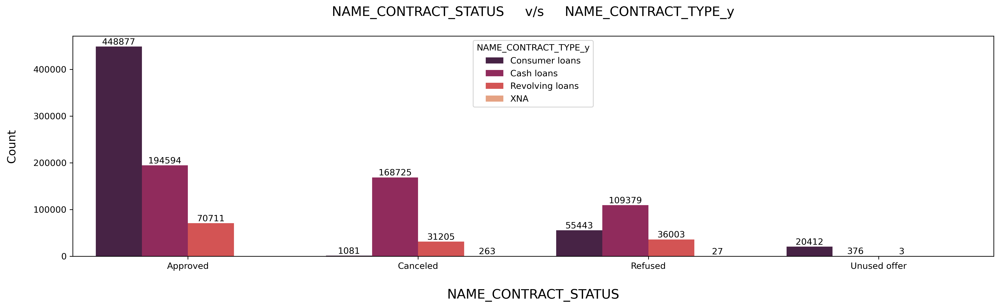

In [215]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_CONTRACT_TYPE_y',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

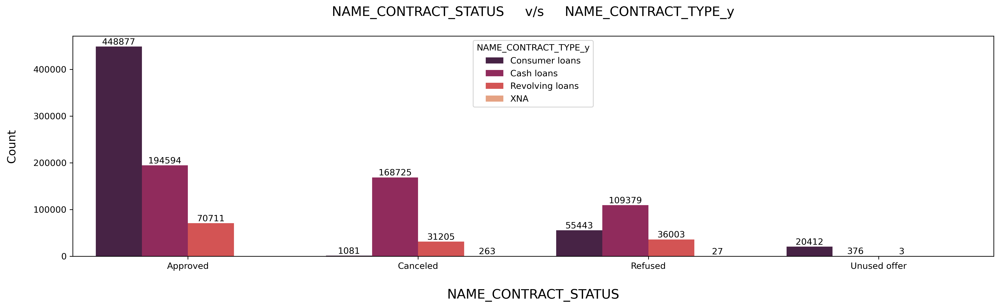

In [216]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_CONTRACT_TYPE_y',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#People With 'Consumer Loans' Got Most Approvals.

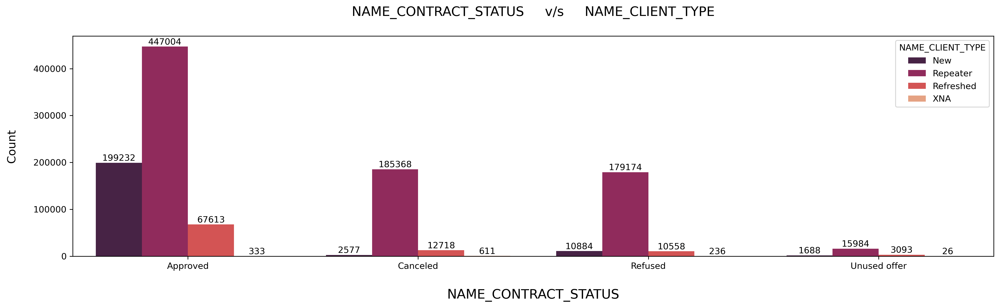

In [217]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_CLIENT_TYPE',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

# 'Repeater' Client Got Most Approvals.

plt.savefig('repeaters.svg',transparent=True,bbox_inches='tight')

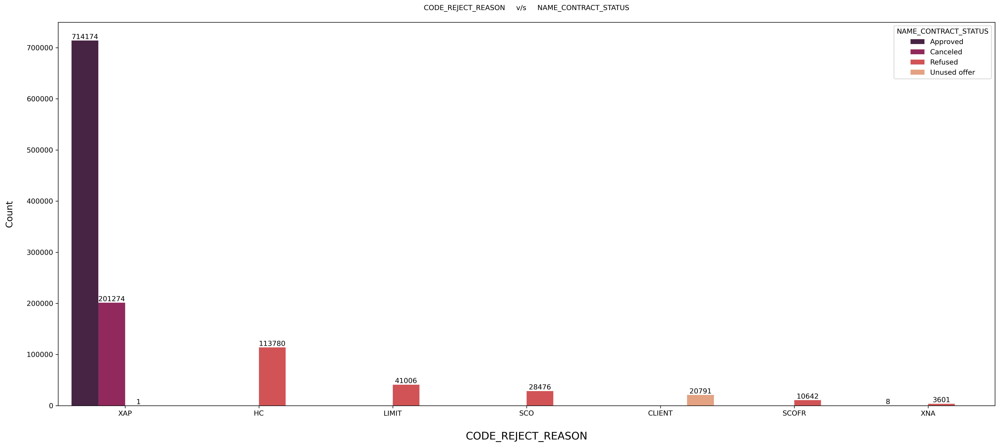

In [218]:
bivarmergcat('CODE_REJECT_REASON','NAME_CONTRACT_STATUS',rot=0,fig_size=[20,9],fsize=10,xt=13)

#People With Code Reject Reason 'XAP' Got Most Approvals.
#All The Other Code Reject Reason Were Refused.
#Reject Reason Code 'HC' Got More Refusals.

plt.savefig('xap.svg',transparent=True,bbox_inches='tight')

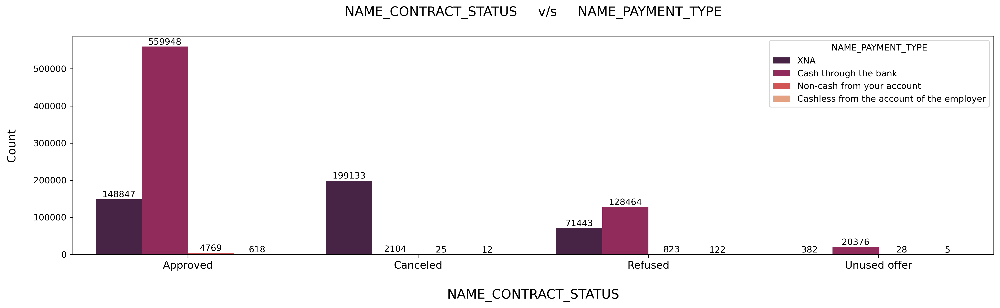

In [219]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_PAYMENT_TYPE',rot=0,fig_size=[16,5],fsize=12,xt=13,title_size=15)

# People With Payment_Type Cash Through Bank Got Most Approvals.
# People With Unknown Payment Type Got Most Cancelation.

plt.savefig('cashthrbank.svg',transparent=True,bbox_inches='tight')

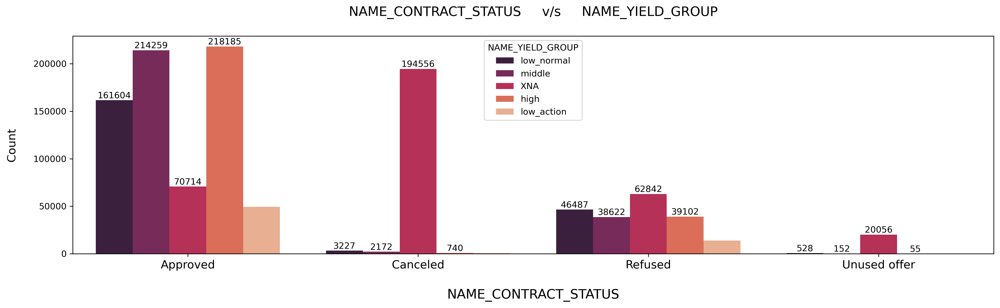

In [220]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_YIELD_GROUP',rot=0,fig_size=[16,5],fsize=13,xt=13,title_size=15)

# People With High And Middle Yield Got Most Approvals.
# People With Unknown Yield Got Most Cancelation.

plt.savefig('binacon.svg',transparent=True,bbox_inches='tight')

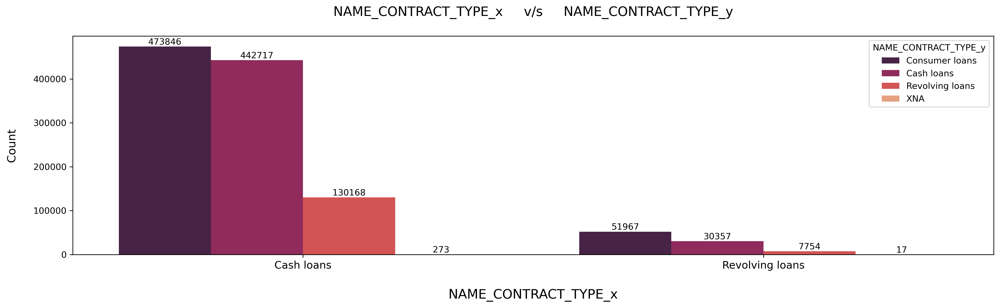

In [221]:
bivarmergcat('NAME_CONTRACT_TYPE_x','NAME_CONTRACT_TYPE_y',rot=0,fig_size=[16,5],fsize=12,xt=13,title_size=15)

#People With Consumer Loans Were Mostly Covered In Cash Loans.

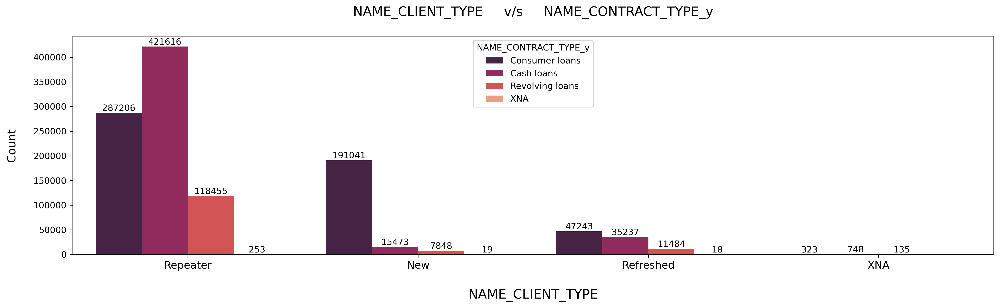

In [222]:
bivarmergcat('NAME_CLIENT_TYPE','NAME_CONTRACT_TYPE_y',rot=0,fig_size=[16,5],fsize=12,xt=13,title_size=15)

# People With Most Cash Loans Were Repeater Client.

plt.savefig('cli_contrtype.svg',transparent=True,bbox_inches='tight')

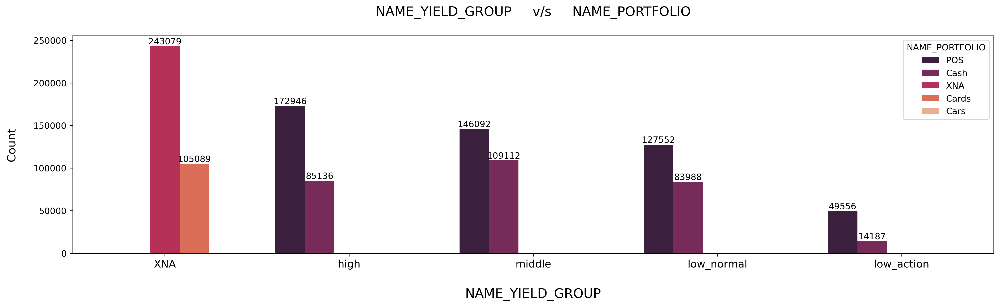

In [223]:
bivarmergcat('NAME_YIELD_GROUP','NAME_PORTFOLIO',rot=0,fig_size=[16,5],fsize=12,xt=13,title_size=15)

#People With 'High Yield' Are Mostly With 'POS' Portfolio.
#People With Portfolio Cards Are Also Counted In Unknown Yield.

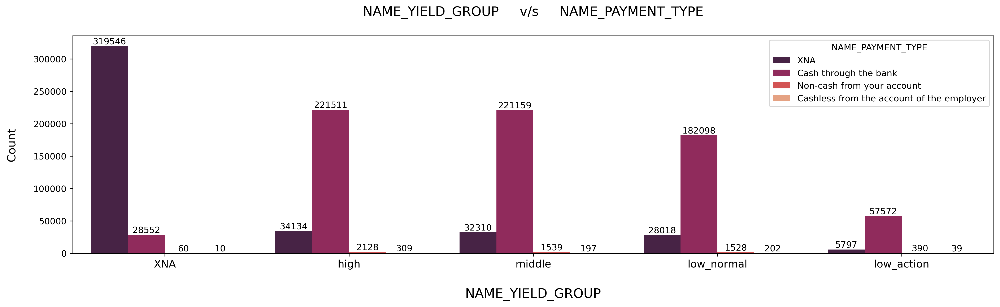

In [224]:
bivarmergcat('NAME_YIELD_GROUP','NAME_PAYMENT_TYPE',rot=0,fig_size=[16,5],fsize=12,xt=13,title_size=15)

#People With High And Middle Yield Used More Cash Through The Bank Payment Type.

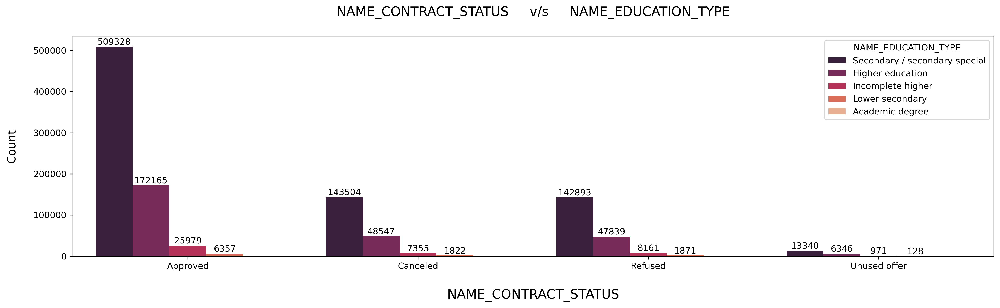

In [225]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_EDUCATION_TYPE',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#People With Secondary/secondary special Education Got Most Approvals.

plt.savefig('educatio.svg',transparent=True,bbox_inches='tight')

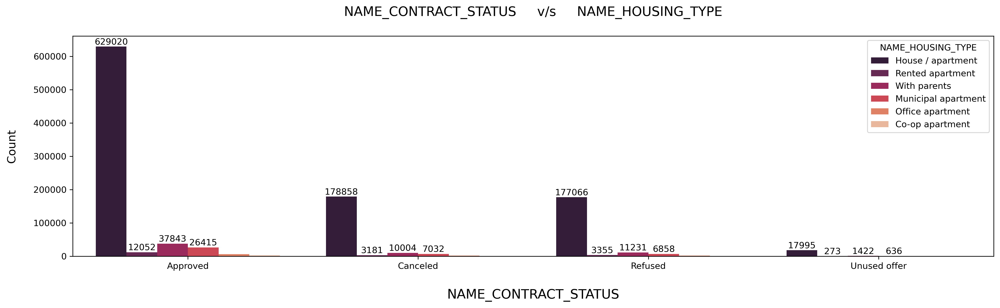

In [226]:
bivarmergcat('NAME_CONTRACT_STATUS','NAME_HOUSING_TYPE',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#People With House /apartment Got Most Approvals.

plt.savefig('housing.svg',transparent=True,bbox_inches='tight')

In [227]:
categorical_Val # Checking Categorical Columns.

Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE',
       'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE',
       'EMERGENCYSTATE_MODE', 'GENDER'],
      dtype='object')

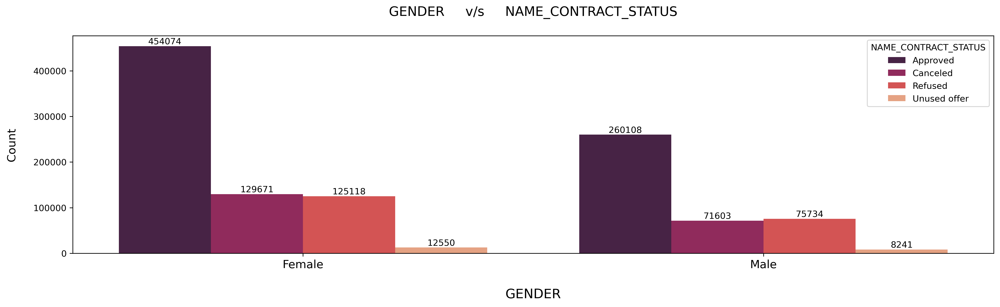

In [228]:
bivarmergcat('GENDER','NAME_CONTRACT_STATUS',rot=0,fig_size=[16,5],fsize=13,xt=13,title_size=15)

# 'Females' Mostly Got Approved Compared To 'Males'.

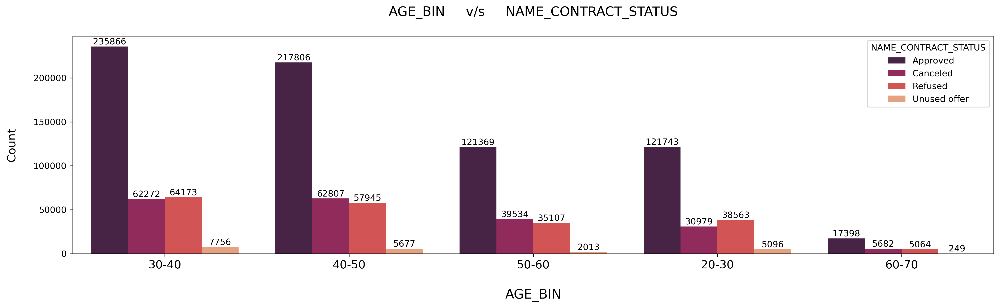

In [229]:
bivarmergcat('AGE_BIN','NAME_CONTRACT_STATUS',rot=0,fig_size=[16,5],fsize=13,xt=13,title_size=15)

#People With Age Group 30-50 Got Most Approvals.

plt.savefig('biage.svg',transparent=True,bbox_inches='tight')

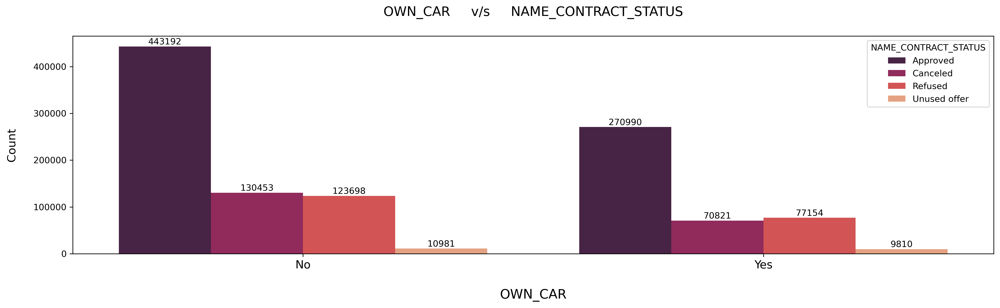

In [230]:
bivarmergcat('OWN_CAR','NAME_CONTRACT_STATUS',tic=[0,1],lab=['No','Yes'],fig_size=[16,5],fsize=13,xt=13,title_size=15)

#People With No-Car Got Most Approvals.

In [231]:
def bivarmerggen(a,b,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 15 }
    plt.figure(figsize=fig_size,dpi=300)
#     plt.subplot(1,2,1)
    plt.title(f'{a}     v/s     {b}\n',fontsize=title_size)
    aa=sns.countplot(data=df_merged,x=a,palette='Purples_d',hue=b,order = df_merged[a].value_counts().head(7).index) #x = a 
    plt.xlabel(xlabel=f'\n{a}',fontdict= fon)
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count\n',size=xt)
    plt.bar_label(aa.containers[0],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[1],rotation=barot,label_type=labe)
    plt.tight_layout();
    
    # Using Countplot.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size.
    # This Function Can Manipulate plot size,ticks,title,rotation,labels,etc.

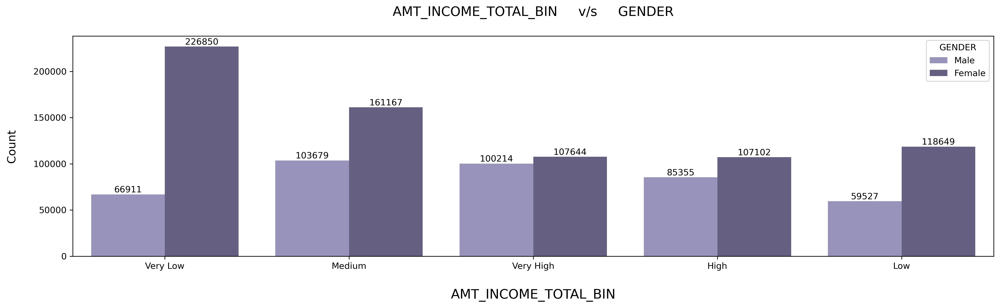

In [232]:
bivarmerggen('AMT_INCOME_TOTAL_BIN','GENDER',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#There Are Most Females With Very Low Total Income.
plt.savefig('gen_inc.svg',transparent=True,bbox_inches='tight')

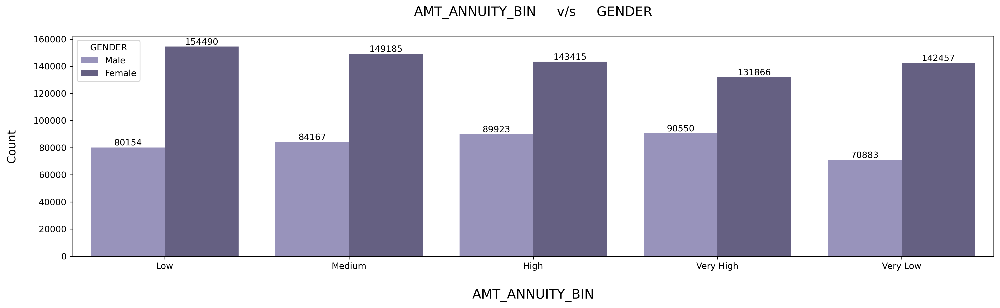

In [233]:
bivarmerggen('AMT_ANNUITY_BIN','GENDER',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#A Large Number Of Females Are Seen With Low Annuity Amount.

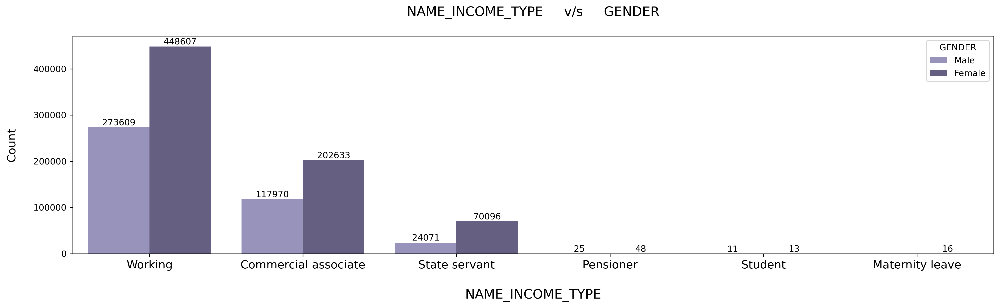

In [234]:
bivarmerggen('NAME_INCOME_TYPE','GENDER',rot=0,fig_size=[16,5],fsize=13,xt=13,title_size=15)

#Most Working Professionals Are Females.

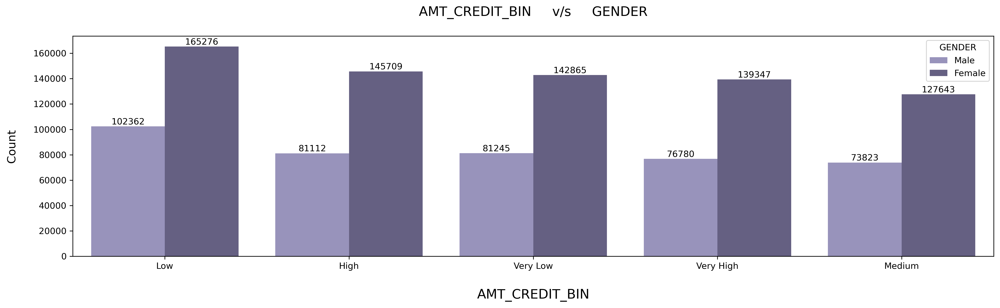

In [235]:
bivarmerggen('AMT_CREDIT_BIN','GENDER',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#A Large Number Of Females Are Seen With Low Credit Amount.

In [236]:
def bivarmergcat_5bar(a,b,fig_size=[8,6],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 15 }
    plt.figure(figsize=fig_size,dpi=300)
#     plt.subplot(1,2,1)
    plt.title(f'{a}     v/s     {b}\n',fontsize=title_size)
    aa=sns.countplot(data=df_merged,x=a,palette='rocket',hue=b,order = df_merged[a].value_counts().head(7).index) #x = a 
    plt.xlabel(xlabel=f'\n{a}',fontdict= fon)
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel('Count\n',size=xt)
    plt.bar_label(aa.containers[0],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[1],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[2],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[3],rotation=barot,label_type=labe)
    plt.bar_label(aa.containers[4],rotation=barot,label_type=labe)
    plt.tight_layout();
    
    # Using Countplot.
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size.
    # This Function Can Manipulate plot size,ticks,title,rotation,labels,etc.

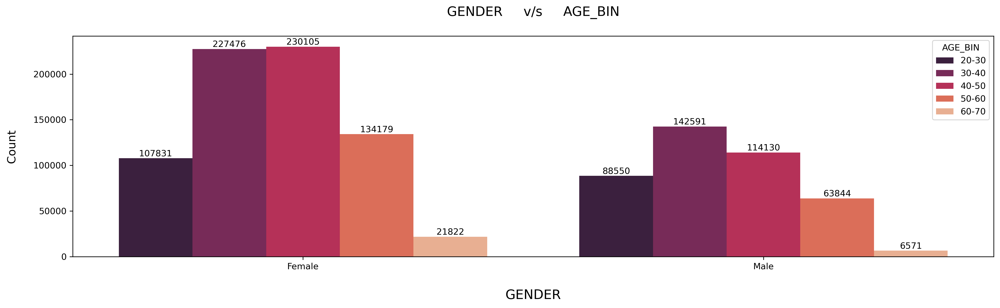

In [237]:
bivarmergcat_5bar('GENDER','AGE_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

# Most Numbers Are Of Females With Age Group 30-50 

plt.savefig('age_gender.svg',transparent=True,bbox_inches='tight')

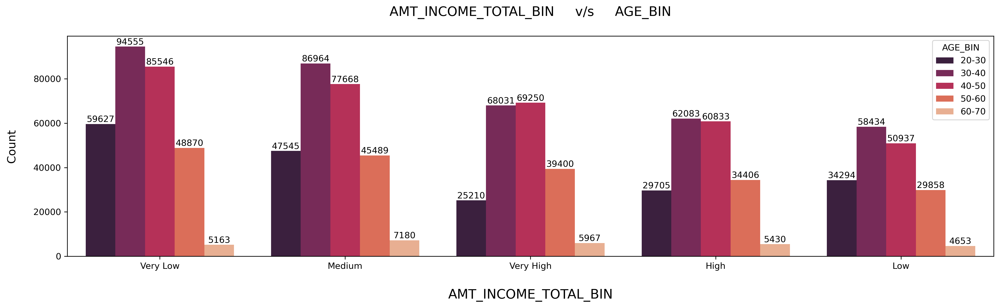

In [238]:
bivarmergcat_5bar('AMT_INCOME_TOTAL_BIN','AGE_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#Most People With Age Group 30-40 Has Very Low Total Income Amount.
plt.savefig('age_inc.svg',transparent=True,bbox_inches='tight')

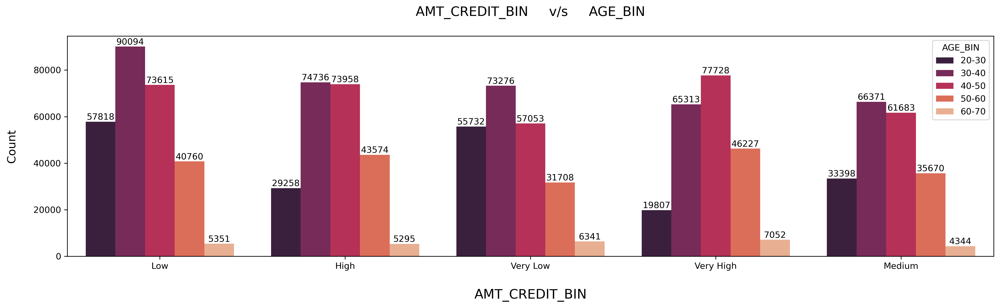

In [239]:
bivarmergcat_5bar('AMT_CREDIT_BIN','AGE_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

#Most People With Age Group 30-40 Has Low Credit Amount.

plt.savefig('age_cre.svg',transparent=True,bbox_inches='tight')

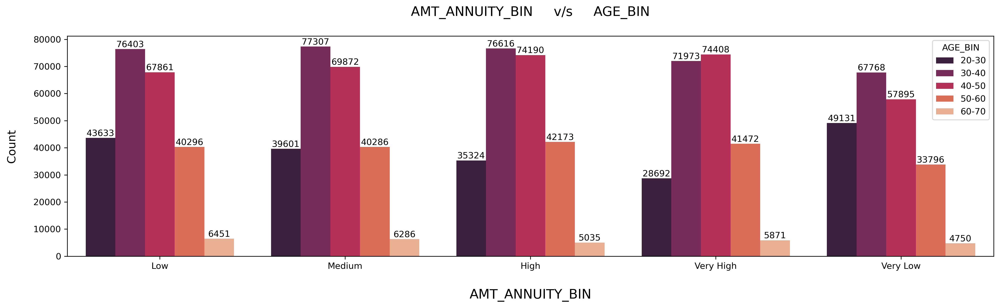

In [240]:
bivarmergcat_5bar('AMT_ANNUITY_BIN','AGE_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

# Most People With Age Group 30-40 Has Medium Annuity Amount.

plt.savefig('anu_age.svg',transparent=True,bbox_inches='tight')

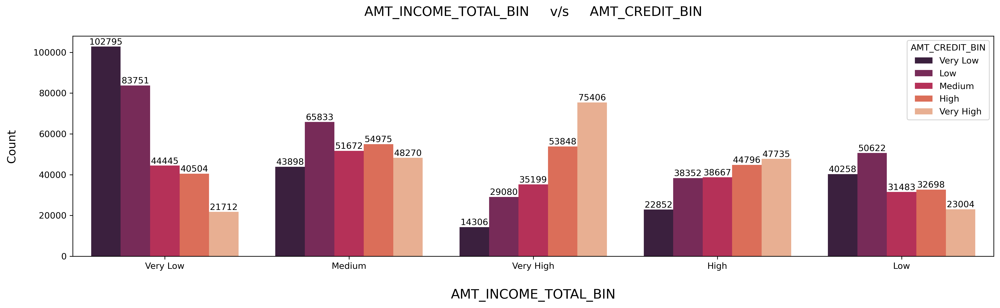

In [241]:
bivarmergcat_5bar('AMT_INCOME_TOTAL_BIN','AMT_CREDIT_BIN',rot=0,fig_size=[16,5],fsize=10,xt=13,title_size=15)

# People With Very Low Credit Amount Also Have Very Low Income.
# People With Very Less Income Amount Has Very High Credit Amount.

plt.savefig('inc_cre.svg',transparent=True,bbox_inches='tight')

### Bivariate Analysis Of Numerical Variable

In [242]:
list(merged_num.difference(numerical_var)) #List Of All New Numerical Columns From Merged Dataset (Previous Application)

['AMT_ANNUITY_x',
 'AMT_ANNUITY_y',
 'AMT_APPLICATION',
 'AMT_CREDIT_x',
 'AMT_CREDIT_y',
 'AMT_GOODS_PRICE_x',
 'AMT_GOODS_PRICE_y',
 'CNT_PAYMENT',
 'DAYS_DECISION',
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_TERMINATION',
 'HOUR_APPR_PROCESS_START_x',
 'HOUR_APPR_PROCESS_START_y',
 'NFLAG_INSURED_ON_APPROVAL',
 'NFLAG_LAST_APPL_IN_DAY',
 'SELLERPLACE_AREA',
 'SK_ID_PREV']

#### Creating Function For Bivariate Analysis Of Numerical Columns.

In [243]:
def bivarmergnum(a,b,fig_size=[20,8],tic=None,lab=None,rot=None,barot=None,labe='edge',fsize=None,title_size=10,xt=None):
    fon = { 'weight': 'normal',
        'size': 15 }
    plt.figure(figsize=fig_size,dpi=300)
    plt.title(f'{a}     v/s     {b}\n',fontsize=title_size)
    sns.boxplot(data=df_merged,x=a,y=b,palette='rocket_r',order = df_merged[a].value_counts().head(7).index) 
    plt.xlabel(xlabel=f'\n{a}',fontdict= fon)
    plt.xticks(size=fsize,ticks=tic,labels=lab,rotation=rot)
    plt.ylabel(f'{b}\n',size=xt);
    
    # tic=for 0 and 1 columns,lab=label to replace 0 and 1 if any.
    # barot = bar annot rotation, fsize = xticks Size, xt = ylabel size.
    # This Function Can Manipulate plot size,ticks,title,rotation,labels,etc.

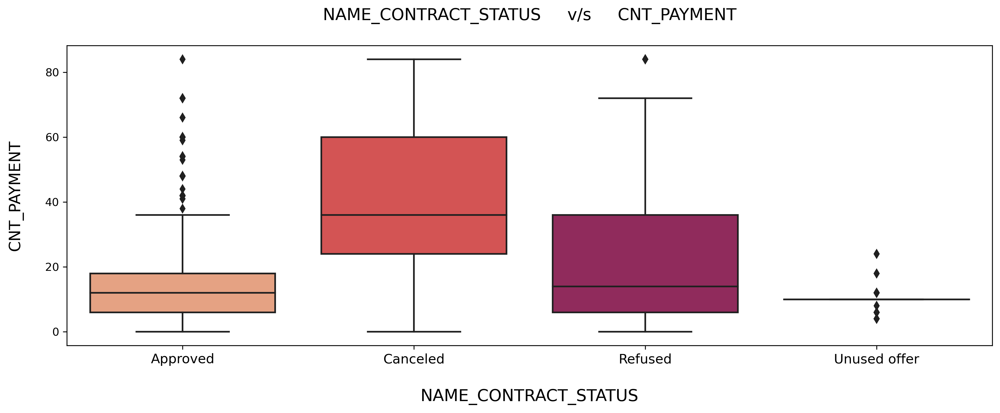

In [244]:
bivarmergnum('NAME_CONTRACT_STATUS','CNT_PAYMENT',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#Cancelation Rate is more in CNT_Payment.

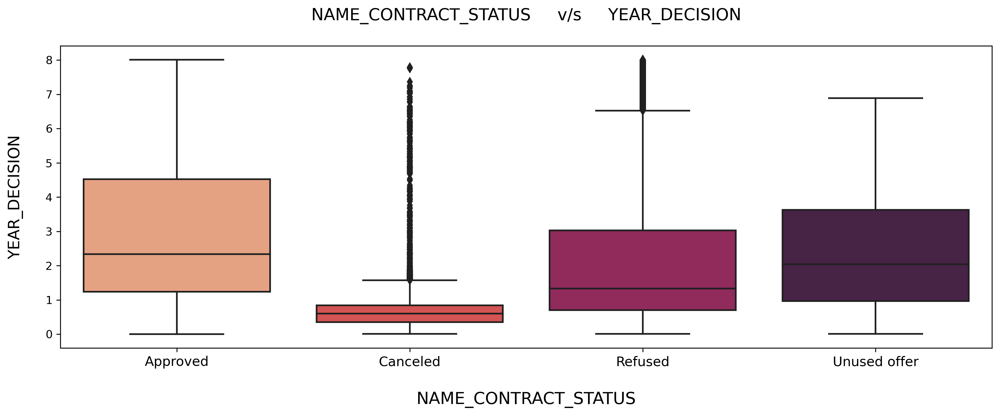

In [245]:
bivarmergnum('NAME_CONTRACT_STATUS','YEAR_DECISION',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#People With Year Decision Between 1 To 4.5 Years Got Most Approvals.

plt.savefig('yeardeci.svg',transparent=True,bbox_inches='tight')

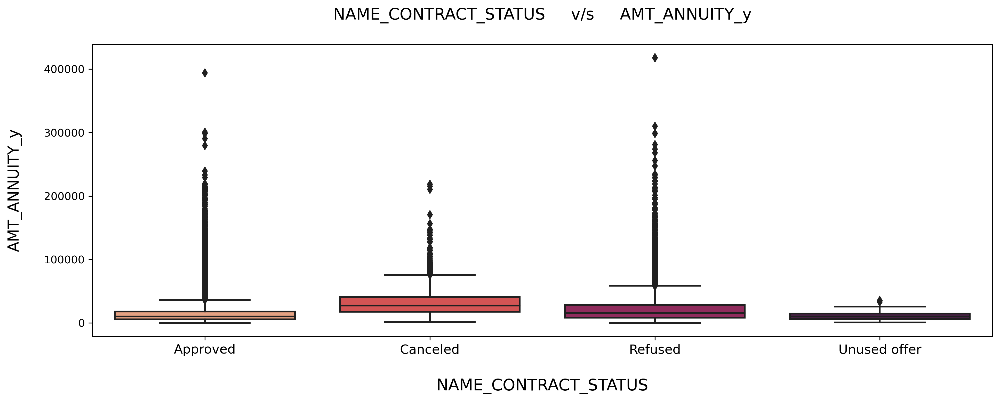

In [246]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_ANNUITY_y',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#People With Previous Annuity Amount Less Got Most Approvals.
#People Got Most Cancelation In Previous Annuity.

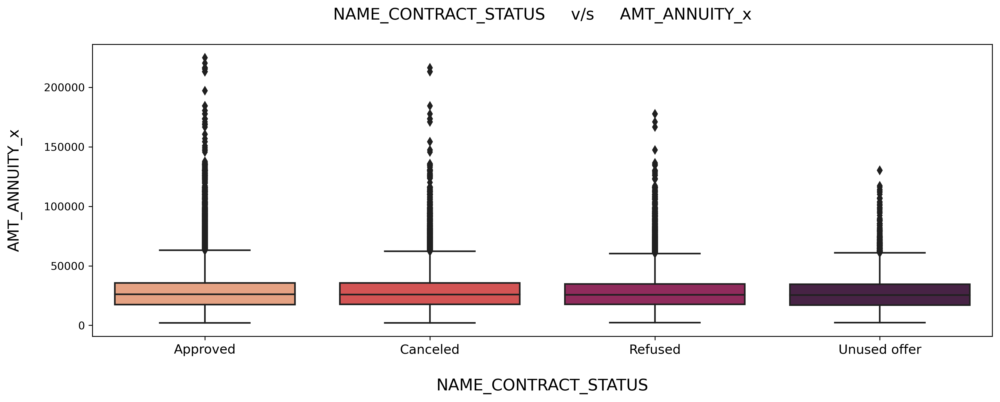

In [247]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_ANNUITY_x',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#Inner Quantile Range In All The Contract Status Are Same,But More Outliers Can Be Spotted In Approved Contract Status.
#In Previous Annuity,Cancelation Were More But Now All Contract Status Are Same.

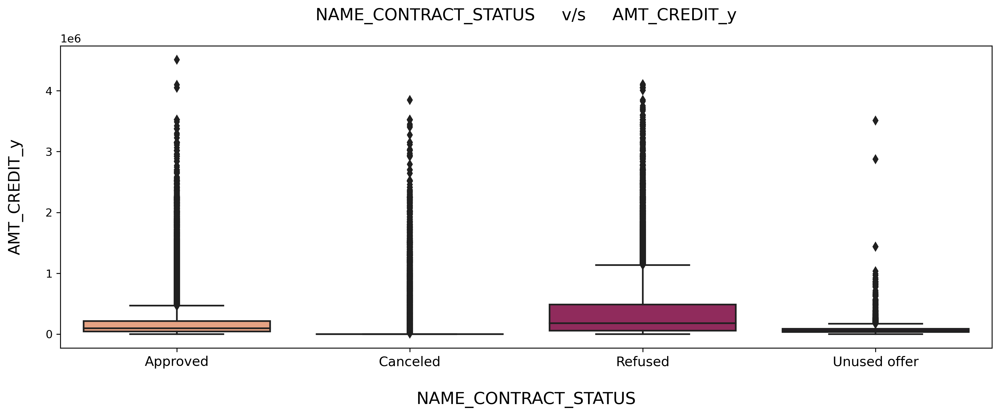

In [248]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_CREDIT_y',fig_size=[15,5],fsize=12,xt=14,title_size=15)

# People With Higher Credit Previous Amount Got Most Refusals.

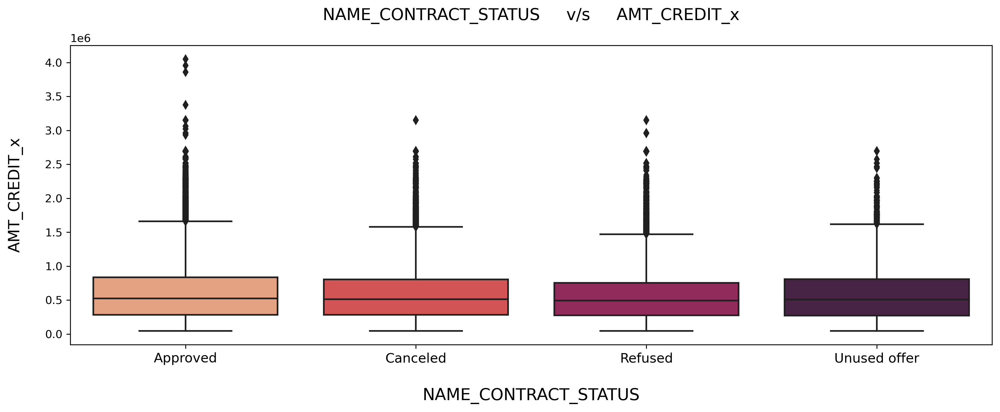

In [249]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_CREDIT_x',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#Inner Quantile Range In All The Contract Status Are Same,But More Outliers Can Be Spotted In Approved Contract Status.
#Previously Most Refusals Were There In Credit Amount But Now All Are Same In Current Scenario.

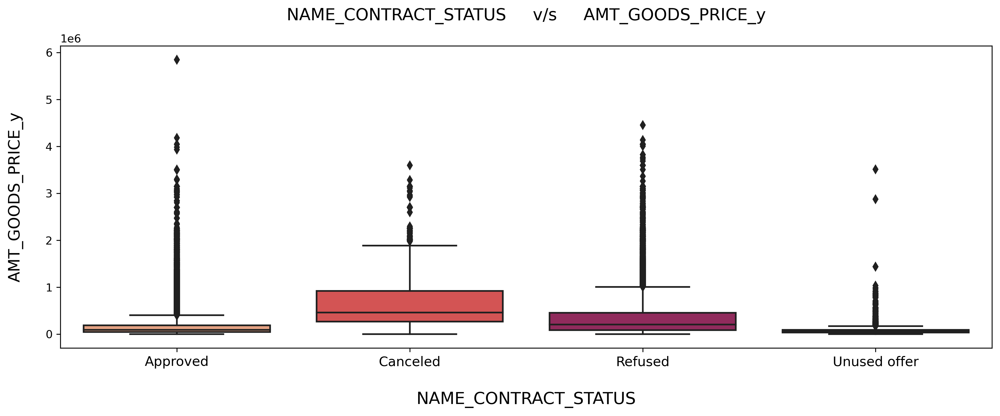

In [250]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_GOODS_PRICE_y',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#People With Higher Good's Price Got Most Cancelation Previously.

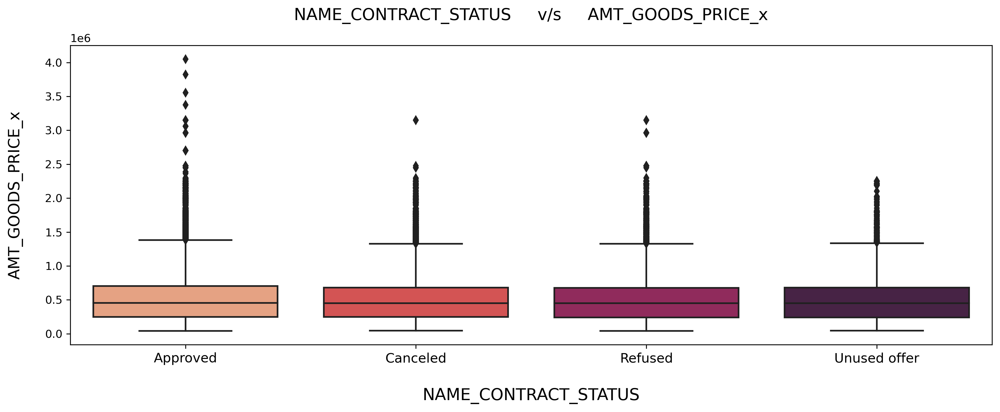

In [251]:
bivarmergnum('NAME_CONTRACT_STATUS','AMT_GOODS_PRICE_x',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#Inner Quantile Range In All The Contract Status Are Same,But More Outliers Can Be Spotted In Approved Contract Status.
#Previously Cancelations Were Most In Previous Good's Amount,But Now All Are Same.

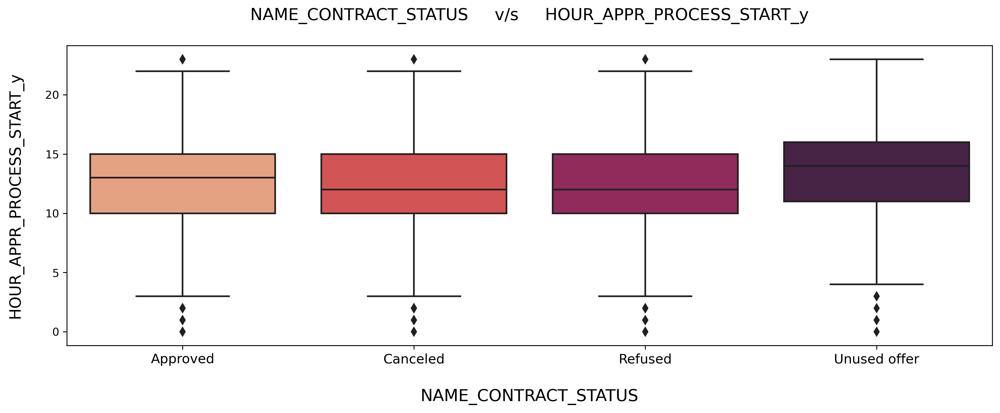

In [252]:
bivarmergnum('NAME_CONTRACT_STATUS','HOUR_APPR_PROCESS_START_y',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#People Whose Process Were Pending For More Hours Left The Offer.

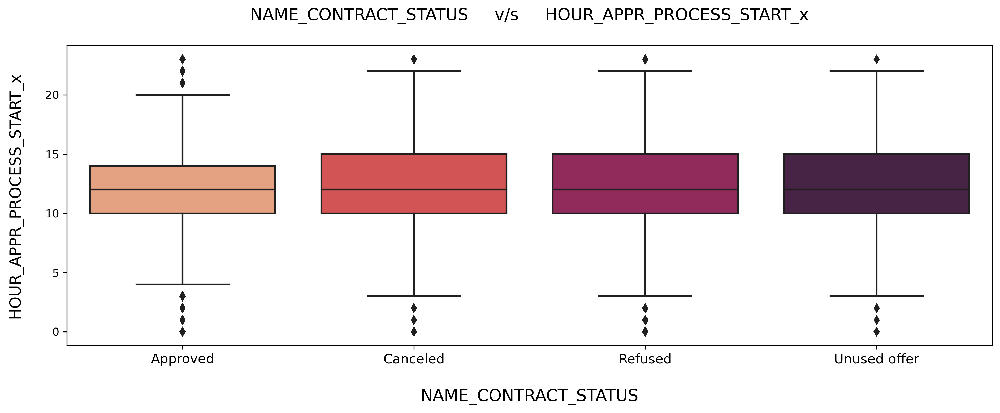

In [253]:
bivarmergnum('NAME_CONTRACT_STATUS','HOUR_APPR_PROCESS_START_x',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#Inner Quantile Range In All The Contract Status Are Same,But More Outliers Can Be Spotted In Approved Contract Status.
#People Who Got Approved,Their Process Of Approval Was 2 hrs more earlier than the rest of The Contracts.

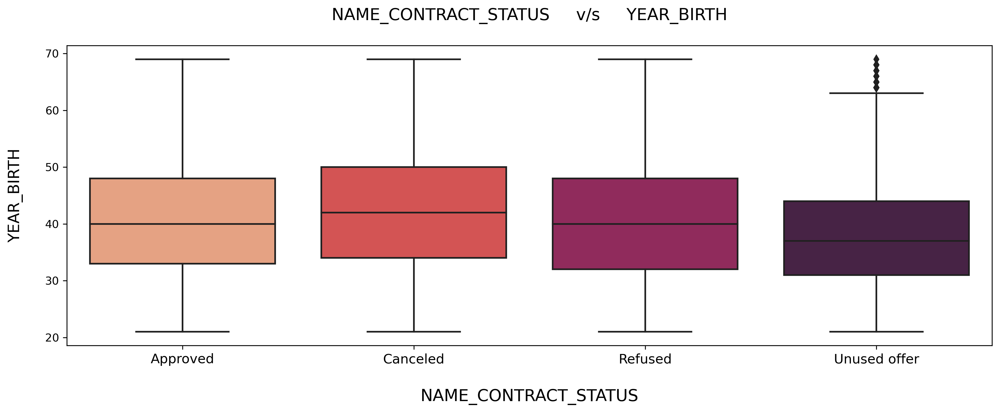

In [254]:
bivarmergnum('NAME_CONTRACT_STATUS','YEAR_BIRTH',fig_size=[15,5],fsize=12,xt=14,title_size=15)

#People With Age Group Between 33 to 50 Got Most Cancelations.

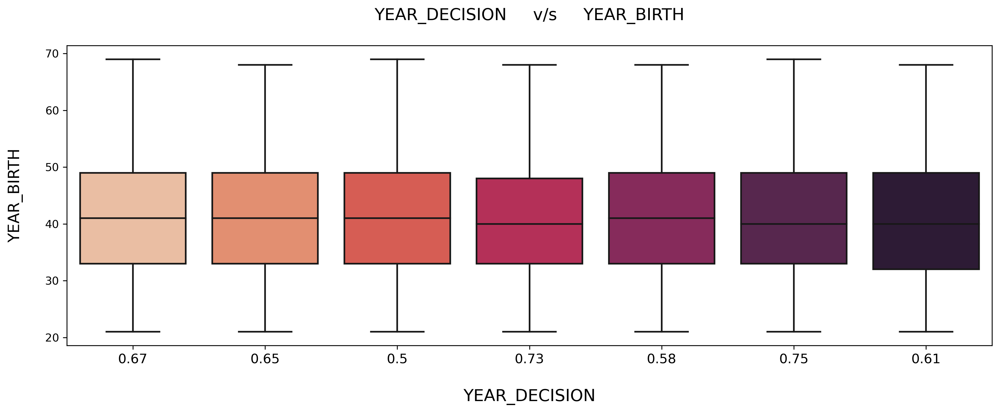

In [255]:
bivarmergnum('YEAR_DECISION','YEAR_BIRTH',fig_size=[15,5],fsize=12,xt=14,title_size=15)

# No Major Difference 

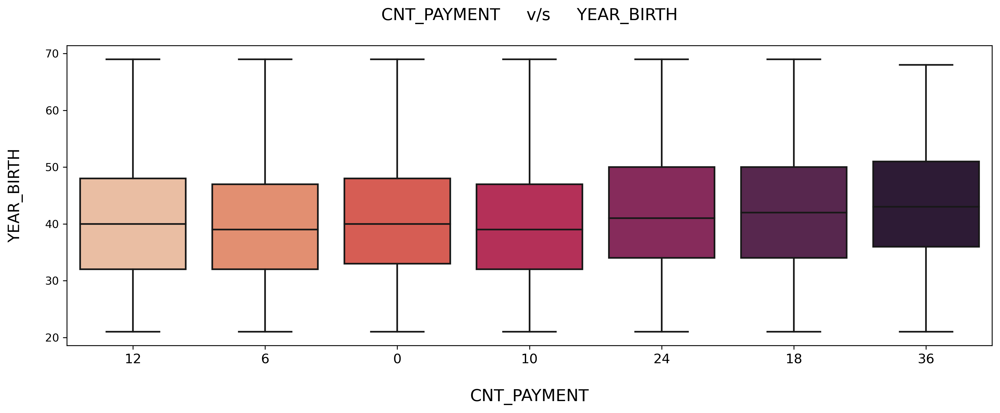

In [256]:
bivarmergnum('CNT_PAYMENT','YEAR_BIRTH',fig_size=[15,5],fsize=12,xt=14,title_size=15)

# Can't Spot Any Major Difference.

#### Main Variable Focused for Application Dataset - TARGET
#### Main Variable Focused for Previous Dataset - NAME_CONTRACT_STATUS